# Assignment 03
# Liver Generation uisng GAN


In [1]:
# data_dir = './data'

data_dir = './data/'
data_dir = '/home/dell/Vijay/COL864/Assignment03/python/cartoon-GAN/data/'


import helper

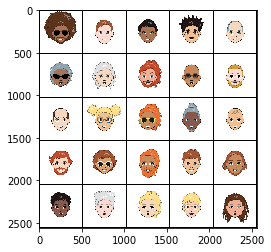

In [2]:
%matplotlib inline
import os
from glob import glob
import numpy as np
from matplotlib import pyplot
show_n_images = 25


#liver_images = helper.get_batch(glob(os.path.join(data_dir, 'liver/*.png'))[:show_n_images], 28, 28, 'RGB') # tested and running with 28*28
liver_images = helper.get_batch(glob(os.path.join(data_dir, '*.png'))[:show_n_images], 512, 512, 'RGB')
pyplot.imshow(helper.images_square_grid(liver_images, 'RGB'))

In [3]:
from distutils.version import LooseVersion
import warnings
import tensorflow as tf
import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '-1'

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.8.0
Default GPU Device: /device:GPU:0


In [4]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):

    # Model input function 
    real_input_images = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], 'real_input_images')
    input_z = tf.placeholder(tf.float32, [None, z_dim], 'input_z')
    learning_rate = tf.placeholder(tf.float32, [], 'learning_rate')
    return real_input_images, input_z, learning_rate

tests.test_model_inputs(model_inputs)

Tests Passed


## Network Architecture and training

### Generator Architecture
                    Layer                     Size In          Size out
                    
            Project and Reshape              100x1             32x32x512
            Conv 1                           32x32x512         64x64x256
            Conv 2                           64x64x256         128x128x128
            Conv 3                           128x128x128       256x256x64
            Conv 4                           256x256x64        512x512x32
### Descriminator Architecture : 
            Same as above (inreverse order)

In [5]:
def discriminator(images, reuse=False, alpha=0.2, keep_prob=0.5):

    # Descriminator function 
#     with tf.variable_scope('discriminator', reuse=reuse):
#         # Input layer is 28x28xn
#         # Convolutional layer, 14x14x64 ; 28x28x64
#         conv1 = tf.layers.conv2d(images, 32, 5, 2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
#         lrelu1 = tf.maximum(alpha * conv1, conv1)
#         drop1 = tf.layers.dropout(lrelu1, keep_prob)
        
#         # Strided convolutional layer, 7x7x128
#         conv2 = tf.layers.conv2d(drop1, 64, 5, 2, 'same', use_bias=False)
#         bn2 = tf.layers.batch_normalization(conv2)
#         lrelu2 = tf.maximum(alpha * bn2, bn2)
#         drop2 = tf.layers.dropout(lrelu2, keep_prob)
        
#         # Strided convolutional layer, 4x4x256
#         conv3 = tf.layers.conv2d(drop2, 128, 5, 2, 'same', use_bias=False)
#         bn3 = tf.layers.batch_normalization(conv3)
#         lrelu3 = tf.maximum(alpha * bn3, bn3)
#         drop3 = tf.layers.dropout(lrelu3, keep_prob)

#         # Strided convolutional layer, 4x4x256
#         conv4 = tf.layers.conv2d(drop3, 256, 5, 2, 'same', use_bias=False)
#         bn4 = tf.layers.batch_normalization(conv4)
#         lrelu4 = tf.maximum(alpha * bn4, bn4)
#         drop4 = tf.layers.dropout(lrelu4, keep_prob)
        
#         # fully connected
#         flat = tf.reshape(drop4, (-1, 4*4*256))
#         logits = tf.layers.dense(flat, 1)
#         out = tf.sigmoid(logits)
        
#         return out, logits
    
# ## ===================== Second one for 512 size input image

    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 512x512xn
        # Convolutional layer, 256x256x64 ; 28x28x64

        conv1 = tf.layers.conv2d(images, 32, 5, 2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        lrelu1 = tf.maximum(alpha * conv1, conv1)
        drop1 = tf.layers.dropout(lrelu1, keep_prob)
        
        # Strided convolutional layer, 128x128x128
        conv2 = tf.layers.conv2d(drop1, 64, 5, 2, 'same', use_bias=False)
        bn2 = tf.layers.batch_normalization(conv2)
        lrelu2 = tf.maximum(alpha * bn2, bn2)
        drop2 = tf.layers.dropout(lrelu2, keep_prob)
        
        # Strided convolutional layer, 64x64x256
        conv3 = tf.layers.conv2d(drop2, 128, 5, 2, 'same', use_bias=False)
        bn3 = tf.layers.batch_normalization(conv3)
        lrelu3 = tf.maximum(alpha * bn3, bn3)
        drop3 = tf.layers.dropout(lrelu3, keep_prob)

        # Strided convolutional layer, 32x32x512
        conv4 = tf.layers.conv2d(drop3, 256, 5, 2, 'same', use_bias=False)
        bn4 = tf.layers.batch_normalization(conv4)
        lrelu4 = tf.maximum(alpha * bn4, bn4)
        drop4 = tf.layers.dropout(lrelu4, keep_prob)
        
        # fully connected
        flat = tf.reshape(drop4, (-1, 32*32*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits
    
#tests.test_discriminator(discriminator, tf)

In [6]:
def generator(z, out_channel_dim, is_train=True, alpha=0.2, keep_prob=0.5):


    with tf.variable_scope('generator', reuse=(not is_train)):
        # First fully connected layer, 32x32x512

        fc = tf.layers.dense(z, 32*32*512, use_bias=False)
        fc = tf.reshape(fc, (-1, 32, 32, 512))
        bn0 = tf.layers.batch_normalization(fc, training=is_train)
        lrelu0 = tf.maximum(alpha * bn0, bn0)
        drop0 = tf.layers.dropout(lrelu0, keep_prob, training=is_train)
        
        # Deconvolution, 64x64x256
        conv1 = tf.layers.conv2d_transpose(drop0, 256, 5, 2, 'same', use_bias=False)
        bn1 = tf.layers.batch_normalization(conv1, training=is_train)
        lrelu1 = tf.maximum(alpha * bn1, bn1)
        drop1 = tf.layers.dropout(lrelu1, keep_prob, training=is_train)
        
        # Deconvolution, 128x128x128
        conv2 = tf.layers.conv2d_transpose(drop1, 128, 5, 2, 'same', use_bias=False)
        bn2 = tf.layers.batch_normalization(conv2, training=is_train)
        lrelu2 = tf.maximum(alpha * bn2, bn2)
        drop2 = tf.layers.dropout(lrelu2, keep_prob, training=is_train)

        # Deconvolution, 256x256x64
        conv3 = tf.layers.conv2d_transpose(drop2, 64, 5, 2, 'same', use_bias=False)
        bn3 = tf.layers.batch_normalization(conv3, training=is_train)
        lrelu3 = tf.maximum(alpha * bn3, bn3)
        drop3 = tf.layers.dropout(lrelu3, keep_prob, training=is_train)
        

        # Output layer, 512x512xn (n=32, and number of channel is n =3)
        #new ouput laye is  56x56xn
        logits = tf.layers.conv2d_transpose(drop3, out_channel_dim, 5, 2, 'same')
        
        out = tf.tanh(logits)
        
        return out

# Test generator function 

#tests.test_generator(generator, tf)


In [7]:
def model_loss(input_real, input_z, out_channel_dim, alpha=0.2, smooth_factor=0.1):

    # Model loss function 
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                labels=tf.ones_like(d_model_real) * (1 - smooth_factor)))
    
    input_fake = generator(input_z, out_channel_dim, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(input_fake, reuse=True, alpha=alpha)
    
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    return d_loss_real + d_loss_fake, g_loss

# Test loss function 

#tests.test_model_loss(model_loss)

In [8]:
# Optimization 
def model_opt(d_loss, g_loss, learning_rate, beta1):

    # TODO: Implement Function
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        #d_train_opt = tf.train.AdamOptimizer(0.00025, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
        #g_train_opt = tf.train.AdamOptimizer(0.000050, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

# test optimization 
#tests.test_model_opt(model_opt, tf)

In [9]:
# ## Neural Network Training

import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()
    return images_grid

In [15]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode,
          print_every=10, show_every=100):
#def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode,
#          print_every=10, show_every=100):

    # TODO: Build Model
    input_real, input_z, _ = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3], alpha=0.2)
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    
    saver = tf.train.Saver()
    #sample_z = np.random.uniform(-1, 1, size=(72, z_dim))
    sample_z = np.random.uniform(-1, 1, size=(72, z_dim))
    
    samples, losses = [], []
    
    steps = 0
    count = 0
    with tf.Session() as sess:
        saver = tf.train.Saver()
        sess.run(tf.global_variables_initializer())
         
         # continue training
        save_path = saver.save(sess, "/tmp/model.ckpt")
        #save_path = saver.save(sess, "/tmp/60")
        ckpt = tf.train.latest_checkpoint('./model/')
        saver.restore(sess, save_path)
        coord = tf.train.Coordinator()
        threads = tf.train.start_queue_runners(sess=sess, coord=coord)
        #sess.run(tf.global_variables_initializer())
        output_file = 'output'
        os.mkdir('output')
        output_dir = "/home/dell/Vijay/COL864/Assignment03/python/cartoon-GAN/" + output_file + "/"
        for epoch_i in range(epoch_count):
            #os.mkdir('output/'+ str(epoch_i))
            os.mkdir(output_dir + str(epoch_i))
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                batch_images *= 2.0
                
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                sess.run(g_train_opt, feed_dict={input_z: batch_z})
                
                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_real: batch_images, input_z: batch_z})
                    train_loss_g = g_loss.eval({input_z: batch_z})
                    print("Epoch {}/{} Step {}...".format(epoch_i+1, epoch_count, steps),
                      "Discriminator Loss: {:.4f}...".format(train_loss_d),
                      "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses for viewing after training
                    #losses.append((train_loss_d, train_loss_g))
                     

                if steps % show_every == 0:
                    count = count +1
                    iterr = count*show_every
                    # Show example output for the generator
                    images_grid = show_generator_output(sess, 25, input_z, data_shape[3], data_image_mode)
                    #dst = os.path.join("./output", str(epoch_i), str(iterr)+".png")
                    dst = os.path.join(output_dir + str(epoch_i) + "/" + str(iterr) + ".png")
                    pyplot.imsave(dst, images_grid)
                    
                 # saving the model         
                if epoch_i % 10 == 0:
                    if not os.path.exists('./model/'):
                        os.makedirs('./model')
                    saver.save(sess, './model/' + str(epoch_i))      

INFO:tensorflow:Restoring parameters from /tmp/model.ckpt
Epoch 1/50 Step 10... Discriminator Loss: 0.3753... Generator Loss: 3.3685
Epoch 1/50 Step 20... Discriminator Loss: 1.5460... Generator Loss: 0.5049
Epoch 1/50 Step 30... Discriminator Loss: 0.3730... Generator Loss: 4.7261
Epoch 1/50 Step 40... Discriminator Loss: 1.5175... Generator Loss: 0.5660
Epoch 1/50 Step 50... Discriminator Loss: 0.5833... Generator Loss: 2.3700
Epoch 1/50 Step 60... Discriminator Loss: 0.8507... Generator Loss: 1.6516
Epoch 1/50 Step 70... Discriminator Loss: 0.5549... Generator Loss: 2.3728
Epoch 1/50 Step 80... Discriminator Loss: 0.3864... Generator Loss: 4.1395
Epoch 1/50 Step 90... Discriminator Loss: 0.4203... Generator Loss: 3.4935
Epoch 1/50 Step 100... Discriminator Loss: 0.3395... Generator Loss: 4.9084


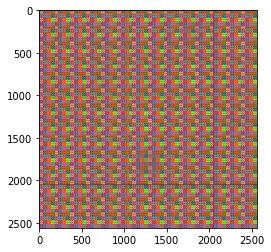

Epoch 1/50 Step 110... Discriminator Loss: 0.3408... Generator Loss: 5.2578
Epoch 1/50 Step 120... Discriminator Loss: 0.3324... Generator Loss: 5.5042
Epoch 1/50 Step 130... Discriminator Loss: 0.5254... Generator Loss: 2.1640
Epoch 1/50 Step 140... Discriminator Loss: 0.5146... Generator Loss: 3.6026
Epoch 1/50 Step 150... Discriminator Loss: 0.7773... Generator Loss: 1.2946
Epoch 1/50 Step 160... Discriminator Loss: 0.8375... Generator Loss: 1.8096
Epoch 1/50 Step 170... Discriminator Loss: 0.9130... Generator Loss: 1.1287
Epoch 1/50 Step 180... Discriminator Loss: 0.6532... Generator Loss: 1.9585
Epoch 1/50 Step 190... Discriminator Loss: 0.4566... Generator Loss: 2.5357
Epoch 1/50 Step 200... Discriminator Loss: 0.5431... Generator Loss: 2.7183


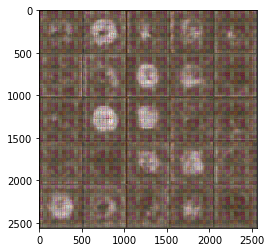

Epoch 1/50 Step 210... Discriminator Loss: 1.7191... Generator Loss: 3.4858
Epoch 1/50 Step 220... Discriminator Loss: 0.8430... Generator Loss: 1.3324
Epoch 1/50 Step 230... Discriminator Loss: 0.5517... Generator Loss: 2.0042
Epoch 1/50 Step 240... Discriminator Loss: 0.7757... Generator Loss: 2.6930
Epoch 1/50 Step 250... Discriminator Loss: 0.6930... Generator Loss: 1.3699
Epoch 1/50 Step 260... Discriminator Loss: 0.7094... Generator Loss: 1.5124
Epoch 1/50 Step 270... Discriminator Loss: 0.6007... Generator Loss: 2.0057
Epoch 1/50 Step 280... Discriminator Loss: 0.4579... Generator Loss: 2.9192
Epoch 1/50 Step 290... Discriminator Loss: 0.9520... Generator Loss: 0.9988
Epoch 1/50 Step 300... Discriminator Loss: 0.4948... Generator Loss: 2.2338


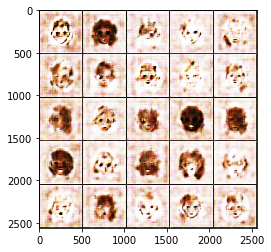

Epoch 1/50 Step 310... Discriminator Loss: 0.5275... Generator Loss: 3.9974
Epoch 1/50 Step 320... Discriminator Loss: 0.4429... Generator Loss: 2.9415
Epoch 1/50 Step 330... Discriminator Loss: 0.4600... Generator Loss: 2.5509
Epoch 1/50 Step 340... Discriminator Loss: 0.4158... Generator Loss: 3.6404
Epoch 1/50 Step 350... Discriminator Loss: 0.4130... Generator Loss: 3.9348
Epoch 1/50 Step 360... Discriminator Loss: 0.4237... Generator Loss: 2.9102
Epoch 1/50 Step 370... Discriminator Loss: 0.4102... Generator Loss: 3.1067
Epoch 1/50 Step 380... Discriminator Loss: 0.5874... Generator Loss: 1.9510
Epoch 1/50 Step 390... Discriminator Loss: 0.4028... Generator Loss: 3.7709
Epoch 1/50 Step 400... Discriminator Loss: 0.8471... Generator Loss: 3.9383


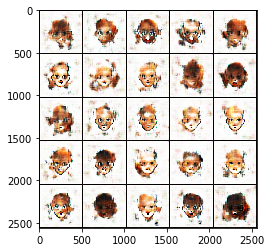

Epoch 1/50 Step 410... Discriminator Loss: 0.3919... Generator Loss: 3.6749
Epoch 1/50 Step 420... Discriminator Loss: 0.4203... Generator Loss: 3.1857
Epoch 1/50 Step 430... Discriminator Loss: 0.4017... Generator Loss: 3.6659
Epoch 1/50 Step 440... Discriminator Loss: 0.6974... Generator Loss: 2.5725
Epoch 1/50 Step 450... Discriminator Loss: 0.5130... Generator Loss: 2.3106
Epoch 1/50 Step 460... Discriminator Loss: 0.5345... Generator Loss: 3.2491
Epoch 1/50 Step 470... Discriminator Loss: 0.7555... Generator Loss: 1.4455
Epoch 1/50 Step 480... Discriminator Loss: 0.4449... Generator Loss: 2.8883
Epoch 1/50 Step 490... Discriminator Loss: 0.4646... Generator Loss: 3.1509
Epoch 1/50 Step 500... Discriminator Loss: 1.9025... Generator Loss: 5.4973


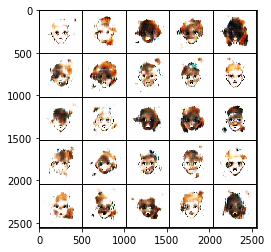

Epoch 1/50 Step 510... Discriminator Loss: 0.8648... Generator Loss: 1.1180
Epoch 1/50 Step 520... Discriminator Loss: 0.6325... Generator Loss: 2.1158
Epoch 1/50 Step 530... Discriminator Loss: 0.9265... Generator Loss: 1.0103
Epoch 1/50 Step 540... Discriminator Loss: 0.6158... Generator Loss: 3.3958
Epoch 1/50 Step 550... Discriminator Loss: 0.4469... Generator Loss: 2.7257
Epoch 1/50 Step 560... Discriminator Loss: 0.5101... Generator Loss: 3.4354
Epoch 1/50 Step 570... Discriminator Loss: 0.6679... Generator Loss: 1.5375
Epoch 1/50 Step 580... Discriminator Loss: 0.4162... Generator Loss: 2.8613
Epoch 1/50 Step 590... Discriminator Loss: 0.5636... Generator Loss: 1.8142
Epoch 1/50 Step 600... Discriminator Loss: 0.4306... Generator Loss: 2.6762


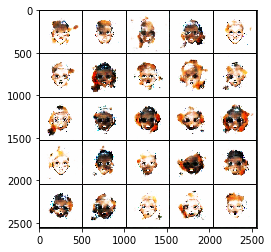

Epoch 1/50 Step 610... Discriminator Loss: 0.8850... Generator Loss: 1.6546
Epoch 1/50 Step 620... Discriminator Loss: 0.5462... Generator Loss: 2.2392
Epoch 2/50 Step 630... Discriminator Loss: 0.7376... Generator Loss: 3.7619
Epoch 2/50 Step 640... Discriminator Loss: 0.4530... Generator Loss: 2.8170
Epoch 2/50 Step 650... Discriminator Loss: 1.0514... Generator Loss: 5.3543
Epoch 2/50 Step 660... Discriminator Loss: 0.6088... Generator Loss: 1.6184
Epoch 2/50 Step 670... Discriminator Loss: 0.4687... Generator Loss: 2.5484
Epoch 2/50 Step 680... Discriminator Loss: 0.5633... Generator Loss: 3.6393
Epoch 2/50 Step 690... Discriminator Loss: 1.3554... Generator Loss: 0.6084
Epoch 2/50 Step 700... Discriminator Loss: 0.7784... Generator Loss: 2.2279


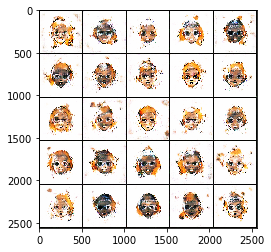

Epoch 2/50 Step 710... Discriminator Loss: 0.5245... Generator Loss: 2.0188
Epoch 2/50 Step 720... Discriminator Loss: 0.6538... Generator Loss: 1.5026
Epoch 2/50 Step 730... Discriminator Loss: 0.6112... Generator Loss: 1.7104
Epoch 2/50 Step 740... Discriminator Loss: 0.4776... Generator Loss: 2.5532
Epoch 2/50 Step 750... Discriminator Loss: 0.4804... Generator Loss: 2.1053
Epoch 2/50 Step 760... Discriminator Loss: 0.4281... Generator Loss: 2.5205
Epoch 2/50 Step 770... Discriminator Loss: 0.4055... Generator Loss: 2.9499
Epoch 2/50 Step 780... Discriminator Loss: 0.5489... Generator Loss: 1.9015
Epoch 2/50 Step 790... Discriminator Loss: 0.4280... Generator Loss: 2.8546
Epoch 2/50 Step 800... Discriminator Loss: 0.3765... Generator Loss: 3.7971


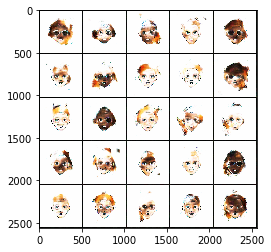

Epoch 2/50 Step 810... Discriminator Loss: 0.6062... Generator Loss: 1.8995
Epoch 2/50 Step 820... Discriminator Loss: 0.4517... Generator Loss: 2.6775
Epoch 2/50 Step 830... Discriminator Loss: 0.4536... Generator Loss: 2.5088
Epoch 2/50 Step 840... Discriminator Loss: 0.5811... Generator Loss: 1.9226
Epoch 2/50 Step 850... Discriminator Loss: 0.4018... Generator Loss: 3.7790
Epoch 2/50 Step 860... Discriminator Loss: 0.8648... Generator Loss: 1.2271
Epoch 2/50 Step 870... Discriminator Loss: 0.5805... Generator Loss: 2.9252
Epoch 2/50 Step 880... Discriminator Loss: 0.7191... Generator Loss: 1.1820
Epoch 2/50 Step 890... Discriminator Loss: 0.4585... Generator Loss: 2.5350
Epoch 2/50 Step 900... Discriminator Loss: 0.4549... Generator Loss: 2.3134


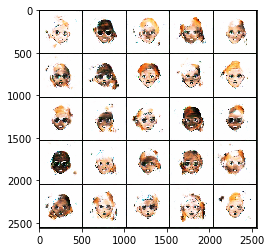

Epoch 2/50 Step 910... Discriminator Loss: 0.3990... Generator Loss: 2.9141
Epoch 2/50 Step 920... Discriminator Loss: 0.4336... Generator Loss: 2.8832
Epoch 2/50 Step 930... Discriminator Loss: 0.4127... Generator Loss: 2.7046
Epoch 2/50 Step 940... Discriminator Loss: 0.6437... Generator Loss: 1.7407
Epoch 2/50 Step 950... Discriminator Loss: 0.4028... Generator Loss: 2.9710
Epoch 2/50 Step 960... Discriminator Loss: 0.4308... Generator Loss: 2.7546
Epoch 2/50 Step 970... Discriminator Loss: 0.3896... Generator Loss: 3.2550
Epoch 2/50 Step 980... Discriminator Loss: 1.3894... Generator Loss: 0.6134
Epoch 2/50 Step 990... Discriminator Loss: 0.4842... Generator Loss: 2.2046
Epoch 2/50 Step 1000... Discriminator Loss: 0.3831... Generator Loss: 3.5781


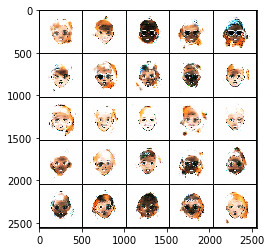

Epoch 2/50 Step 1010... Discriminator Loss: 0.3810... Generator Loss: 3.5949
Epoch 2/50 Step 1020... Discriminator Loss: 0.4295... Generator Loss: 2.6116
Epoch 2/50 Step 1030... Discriminator Loss: 0.4816... Generator Loss: 2.2884
Epoch 2/50 Step 1040... Discriminator Loss: 0.3861... Generator Loss: 3.2312
Epoch 2/50 Step 1050... Discriminator Loss: 0.3783... Generator Loss: 3.4476
Epoch 2/50 Step 1060... Discriminator Loss: 0.4016... Generator Loss: 4.0669
Epoch 2/50 Step 1070... Discriminator Loss: 0.5093... Generator Loss: 4.6179
Epoch 2/50 Step 1080... Discriminator Loss: 0.4654... Generator Loss: 2.3763
Epoch 2/50 Step 1090... Discriminator Loss: 0.4564... Generator Loss: 3.0843
Epoch 2/50 Step 1100... Discriminator Loss: 0.3882... Generator Loss: 3.4383


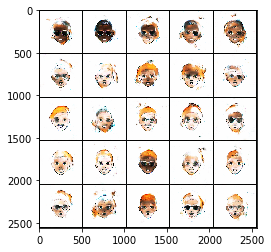

Epoch 2/50 Step 1110... Discriminator Loss: 0.4306... Generator Loss: 3.9017
Epoch 2/50 Step 1120... Discriminator Loss: 0.4079... Generator Loss: 2.9382
Epoch 2/50 Step 1130... Discriminator Loss: 0.6402... Generator Loss: 1.8817
Epoch 2/50 Step 1140... Discriminator Loss: 2.7741... Generator Loss: 0.1406
Epoch 2/50 Step 1150... Discriminator Loss: 14.0879... Generator Loss: 0.0012
Epoch 2/50 Step 1160... Discriminator Loss: 0.7218... Generator Loss: 1.3621
Epoch 2/50 Step 1170... Discriminator Loss: 1.6232... Generator Loss: 0.3561
Epoch 2/50 Step 1180... Discriminator Loss: 1.1655... Generator Loss: 1.3159
Epoch 2/50 Step 1190... Discriminator Loss: 0.9939... Generator Loss: 0.9354
Epoch 2/50 Step 1200... Discriminator Loss: 0.9184... Generator Loss: 0.9903


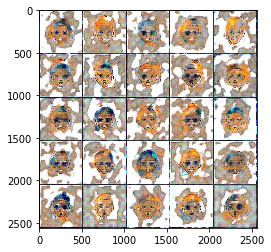

Epoch 2/50 Step 1210... Discriminator Loss: 1.1071... Generator Loss: 0.8659
Epoch 2/50 Step 1220... Discriminator Loss: 0.9775... Generator Loss: 0.8559
Epoch 2/50 Step 1230... Discriminator Loss: 1.3995... Generator Loss: 0.4315
Epoch 2/50 Step 1240... Discriminator Loss: 1.2063... Generator Loss: 1.8325
Epoch 2/50 Step 1250... Discriminator Loss: 1.1171... Generator Loss: 0.7850
Epoch 3/50 Step 1260... Discriminator Loss: 1.0607... Generator Loss: 1.3596
Epoch 3/50 Step 1270... Discriminator Loss: 0.9955... Generator Loss: 0.9950
Epoch 3/50 Step 1280... Discriminator Loss: 0.8698... Generator Loss: 1.5583
Epoch 3/50 Step 1290... Discriminator Loss: 0.9480... Generator Loss: 0.9886
Epoch 3/50 Step 1300... Discriminator Loss: 1.1517... Generator Loss: 1.9402


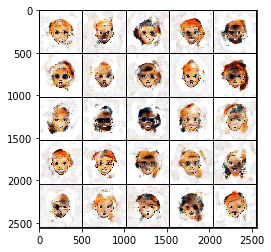

Epoch 3/50 Step 1310... Discriminator Loss: 0.9622... Generator Loss: 1.3312
Epoch 3/50 Step 1320... Discriminator Loss: 1.0957... Generator Loss: 0.7148
Epoch 3/50 Step 1330... Discriminator Loss: 2.0030... Generator Loss: 0.2410
Epoch 3/50 Step 1340... Discriminator Loss: 0.8579... Generator Loss: 1.1197
Epoch 3/50 Step 1350... Discriminator Loss: 0.8986... Generator Loss: 1.6643
Epoch 3/50 Step 1360... Discriminator Loss: 1.0644... Generator Loss: 2.3836
Epoch 3/50 Step 1370... Discriminator Loss: 0.8458... Generator Loss: 1.0004
Epoch 3/50 Step 1380... Discriminator Loss: 0.7781... Generator Loss: 1.4730
Epoch 3/50 Step 1390... Discriminator Loss: 0.8813... Generator Loss: 2.1815
Epoch 3/50 Step 1400... Discriminator Loss: 0.7668... Generator Loss: 1.3371


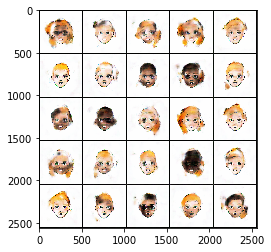

Epoch 3/50 Step 1410... Discriminator Loss: 0.7222... Generator Loss: 2.2040
Epoch 3/50 Step 1420... Discriminator Loss: 0.7881... Generator Loss: 1.1458
Epoch 3/50 Step 1430... Discriminator Loss: 0.6789... Generator Loss: 1.7916
Epoch 3/50 Step 1440... Discriminator Loss: 0.6043... Generator Loss: 1.7678
Epoch 3/50 Step 1450... Discriminator Loss: 1.0740... Generator Loss: 0.7965
Epoch 3/50 Step 1460... Discriminator Loss: 0.6202... Generator Loss: 1.7066
Epoch 3/50 Step 1470... Discriminator Loss: 0.6288... Generator Loss: 2.2420
Epoch 3/50 Step 1480... Discriminator Loss: 0.5680... Generator Loss: 1.8973
Epoch 3/50 Step 1490... Discriminator Loss: 0.7249... Generator Loss: 1.5825
Epoch 3/50 Step 1500... Discriminator Loss: 0.7748... Generator Loss: 1.0540


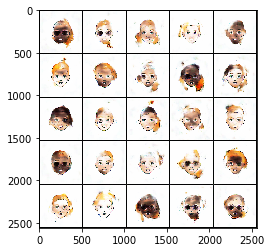

Epoch 3/50 Step 1510... Discriminator Loss: 0.7418... Generator Loss: 1.1333
Epoch 3/50 Step 1520... Discriminator Loss: 1.7229... Generator Loss: 0.4064
Epoch 3/50 Step 1530... Discriminator Loss: 0.5477... Generator Loss: 1.8917
Epoch 3/50 Step 1540... Discriminator Loss: 0.7248... Generator Loss: 1.2350
Epoch 3/50 Step 1550... Discriminator Loss: 0.4964... Generator Loss: 2.1130
Epoch 3/50 Step 1560... Discriminator Loss: 1.2188... Generator Loss: 2.8307
Epoch 3/50 Step 1570... Discriminator Loss: 0.5670... Generator Loss: 2.0762
Epoch 3/50 Step 1580... Discriminator Loss: 0.5551... Generator Loss: 2.0788
Epoch 3/50 Step 1590... Discriminator Loss: 0.6813... Generator Loss: 3.0161
Epoch 3/50 Step 1600... Discriminator Loss: 0.6317... Generator Loss: 1.6618


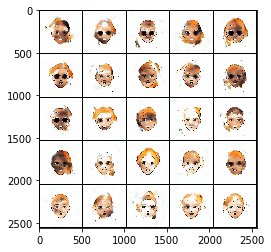

Epoch 3/50 Step 1610... Discriminator Loss: 0.4672... Generator Loss: 2.3602
Epoch 3/50 Step 1620... Discriminator Loss: 0.4451... Generator Loss: 2.5627
Epoch 3/50 Step 1630... Discriminator Loss: 1.8389... Generator Loss: 0.5738
Epoch 3/50 Step 1640... Discriminator Loss: 0.6092... Generator Loss: 1.9362
Epoch 3/50 Step 1650... Discriminator Loss: 0.5276... Generator Loss: 2.1992
Epoch 3/50 Step 1660... Discriminator Loss: 0.4613... Generator Loss: 2.4765
Epoch 3/50 Step 1670... Discriminator Loss: 0.4527... Generator Loss: 2.6815
Epoch 3/50 Step 1680... Discriminator Loss: 2.3260... Generator Loss: 0.2782
Epoch 3/50 Step 1690... Discriminator Loss: 0.5492... Generator Loss: 1.8677
Epoch 3/50 Step 1700... Discriminator Loss: 0.4725... Generator Loss: 2.4189


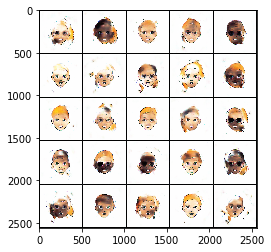

Epoch 3/50 Step 1710... Discriminator Loss: 0.4592... Generator Loss: 2.5098
Epoch 3/50 Step 1720... Discriminator Loss: 0.6537... Generator Loss: 1.5195
Epoch 3/50 Step 1730... Discriminator Loss: 0.4576... Generator Loss: 2.4649
Epoch 3/50 Step 1740... Discriminator Loss: 0.7850... Generator Loss: 1.2896
Epoch 3/50 Step 1750... Discriminator Loss: 1.3517... Generator Loss: 0.6208
Epoch 3/50 Step 1760... Discriminator Loss: 0.6173... Generator Loss: 2.0233
Epoch 3/50 Step 1770... Discriminator Loss: 0.5046... Generator Loss: 2.1281
Epoch 3/50 Step 1780... Discriminator Loss: 0.4761... Generator Loss: 2.1535
Epoch 3/50 Step 1790... Discriminator Loss: 0.4176... Generator Loss: 2.8140
Epoch 3/50 Step 1800... Discriminator Loss: 0.4113... Generator Loss: 2.9621


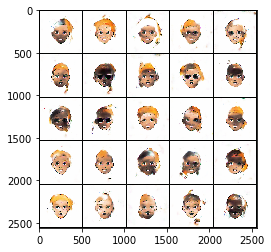

Epoch 3/50 Step 1810... Discriminator Loss: 0.4300... Generator Loss: 2.6359
Epoch 3/50 Step 1820... Discriminator Loss: 0.4158... Generator Loss: 3.0464
Epoch 3/50 Step 1830... Discriminator Loss: 0.5463... Generator Loss: 1.7971
Epoch 3/50 Step 1840... Discriminator Loss: 0.4200... Generator Loss: 2.9664
Epoch 3/50 Step 1850... Discriminator Loss: 0.3988... Generator Loss: 2.8467
Epoch 3/50 Step 1860... Discriminator Loss: 0.6353... Generator Loss: 3.3412
Epoch 3/50 Step 1870... Discriminator Loss: 0.5046... Generator Loss: 2.1888
Epoch 4/50 Step 1880... Discriminator Loss: 0.4494... Generator Loss: 2.9610
Epoch 4/50 Step 1890... Discriminator Loss: 0.4038... Generator Loss: 2.9166
Epoch 4/50 Step 1900... Discriminator Loss: 0.7963... Generator Loss: 4.4348


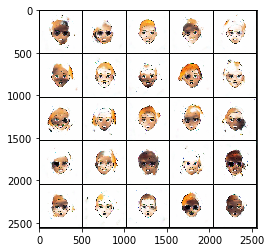

Epoch 4/50 Step 1910... Discriminator Loss: 0.4091... Generator Loss: 3.1343
Epoch 4/50 Step 1920... Discriminator Loss: 0.4210... Generator Loss: 2.8253
Epoch 4/50 Step 1930... Discriminator Loss: 0.4478... Generator Loss: 4.0185
Epoch 4/50 Step 1940... Discriminator Loss: 0.4111... Generator Loss: 3.0429
Epoch 4/50 Step 1950... Discriminator Loss: 0.4197... Generator Loss: 2.8148
Epoch 4/50 Step 1960... Discriminator Loss: 0.3817... Generator Loss: 3.3156
Epoch 4/50 Step 1970... Discriminator Loss: 0.4184... Generator Loss: 3.5752
Epoch 4/50 Step 1980... Discriminator Loss: 0.8190... Generator Loss: 5.4318
Epoch 4/50 Step 1990... Discriminator Loss: 2.4897... Generator Loss: 6.5025
Epoch 4/50 Step 2000... Discriminator Loss: 0.5767... Generator Loss: 2.0784


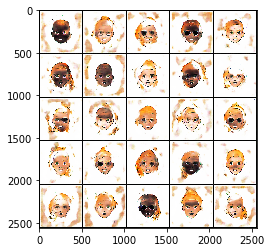

Epoch 4/50 Step 2010... Discriminator Loss: 0.5005... Generator Loss: 2.6270
Epoch 4/50 Step 2020... Discriminator Loss: 0.4462... Generator Loss: 2.5867
Epoch 4/50 Step 2030... Discriminator Loss: 0.4363... Generator Loss: 2.6758
Epoch 4/50 Step 2040... Discriminator Loss: 0.4522... Generator Loss: 2.3767
Epoch 4/50 Step 2050... Discriminator Loss: 0.3851... Generator Loss: 3.3773
Epoch 4/50 Step 2060... Discriminator Loss: 0.4124... Generator Loss: 2.8027
Epoch 4/50 Step 2070... Discriminator Loss: 0.4182... Generator Loss: 2.9069
Epoch 4/50 Step 2080... Discriminator Loss: 0.3943... Generator Loss: 3.4778
Epoch 4/50 Step 2090... Discriminator Loss: 0.4132... Generator Loss: 2.8797
Epoch 4/50 Step 2100... Discriminator Loss: 0.4023... Generator Loss: 3.0689


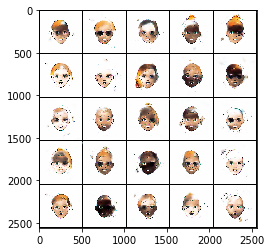

Epoch 4/50 Step 2110... Discriminator Loss: 0.4381... Generator Loss: 2.5516
Epoch 4/50 Step 2120... Discriminator Loss: 0.3980... Generator Loss: 3.8564
Epoch 4/50 Step 2130... Discriminator Loss: 0.5152... Generator Loss: 2.0413
Epoch 4/50 Step 2140... Discriminator Loss: 0.4599... Generator Loss: 2.5889
Epoch 4/50 Step 2150... Discriminator Loss: 0.3632... Generator Loss: 3.6456
Epoch 4/50 Step 2160... Discriminator Loss: 0.8224... Generator Loss: 1.1710
Epoch 4/50 Step 2170... Discriminator Loss: 2.8069... Generator Loss: 0.1915
Epoch 4/50 Step 2180... Discriminator Loss: 0.5303... Generator Loss: 2.2074
Epoch 4/50 Step 2190... Discriminator Loss: 0.5101... Generator Loss: 2.4724
Epoch 4/50 Step 2200... Discriminator Loss: 0.4638... Generator Loss: 2.3326


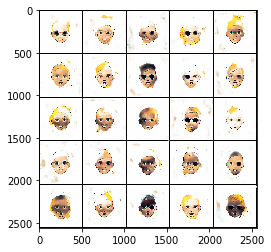

Epoch 4/50 Step 2210... Discriminator Loss: 0.4358... Generator Loss: 2.8011
Epoch 4/50 Step 2220... Discriminator Loss: 0.4022... Generator Loss: 3.1887
Epoch 4/50 Step 2230... Discriminator Loss: 0.4182... Generator Loss: 3.7304
Epoch 4/50 Step 2240... Discriminator Loss: 0.3894... Generator Loss: 3.1657
Epoch 4/50 Step 2250... Discriminator Loss: 0.4067... Generator Loss: 3.6140
Epoch 4/50 Step 2260... Discriminator Loss: 0.3935... Generator Loss: 3.9194
Epoch 4/50 Step 2270... Discriminator Loss: 0.3822... Generator Loss: 3.6465
Epoch 4/50 Step 2280... Discriminator Loss: 0.4979... Generator Loss: 4.8944
Epoch 4/50 Step 2290... Discriminator Loss: 0.3960... Generator Loss: 3.1378
Epoch 4/50 Step 2300... Discriminator Loss: 0.4411... Generator Loss: 2.7123


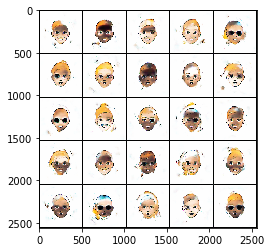

Epoch 4/50 Step 2310... Discriminator Loss: 0.3900... Generator Loss: 3.3763
Epoch 4/50 Step 2320... Discriminator Loss: 0.3630... Generator Loss: 3.7875
Epoch 4/50 Step 2330... Discriminator Loss: 0.3875... Generator Loss: 3.3040
Epoch 4/50 Step 2340... Discriminator Loss: 0.5051... Generator Loss: 3.6077
Epoch 4/50 Step 2350... Discriminator Loss: 0.7760... Generator Loss: 1.2071
Epoch 4/50 Step 2360... Discriminator Loss: 0.4112... Generator Loss: 2.9434
Epoch 4/50 Step 2370... Discriminator Loss: 0.3918... Generator Loss: 3.4780
Epoch 4/50 Step 2380... Discriminator Loss: 0.4542... Generator Loss: 2.4508
Epoch 4/50 Step 2390... Discriminator Loss: 0.3737... Generator Loss: 3.5214
Epoch 4/50 Step 2400... Discriminator Loss: 0.4067... Generator Loss: 3.1605


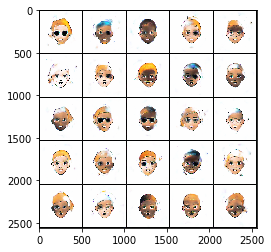

Epoch 4/50 Step 2410... Discriminator Loss: 0.3725... Generator Loss: 3.7691
Epoch 4/50 Step 2420... Discriminator Loss: 0.3652... Generator Loss: 4.0029
Epoch 4/50 Step 2430... Discriminator Loss: 0.4009... Generator Loss: 3.5471
Epoch 4/50 Step 2440... Discriminator Loss: 0.3611... Generator Loss: 3.6798
Epoch 4/50 Step 2450... Discriminator Loss: 0.3686... Generator Loss: 3.9621
Epoch 4/50 Step 2460... Discriminator Loss: 0.3629... Generator Loss: 4.1792
Epoch 4/50 Step 2470... Discriminator Loss: 0.3677... Generator Loss: 3.7038
Epoch 4/50 Step 2480... Discriminator Loss: 0.3880... Generator Loss: 3.4569
Epoch 4/50 Step 2490... Discriminator Loss: 0.3607... Generator Loss: 4.5423
Epoch 4/50 Step 2500... Discriminator Loss: 0.3777... Generator Loss: 3.5360


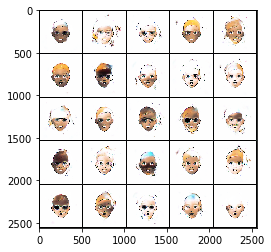

Epoch 5/50 Step 2510... Discriminator Loss: 0.6569... Generator Loss: 3.1976
Epoch 5/50 Step 2520... Discriminator Loss: 0.6408... Generator Loss: 3.1168
Epoch 5/50 Step 2530... Discriminator Loss: 0.3959... Generator Loss: 3.2666
Epoch 5/50 Step 2540... Discriminator Loss: 0.4089... Generator Loss: 3.1287
Epoch 5/50 Step 2550... Discriminator Loss: 0.3854... Generator Loss: 3.2328
Epoch 5/50 Step 2560... Discriminator Loss: 0.3767... Generator Loss: 3.2191
Epoch 5/50 Step 2570... Discriminator Loss: 0.3869... Generator Loss: 3.6019
Epoch 5/50 Step 2580... Discriminator Loss: 0.3790... Generator Loss: 3.9251
Epoch 5/50 Step 2590... Discriminator Loss: 0.3648... Generator Loss: 3.9828
Epoch 5/50 Step 2600... Discriminator Loss: 0.3709... Generator Loss: 4.0746


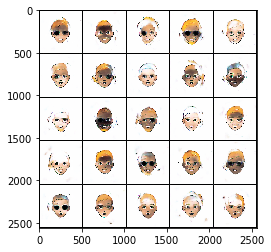

Epoch 5/50 Step 2610... Discriminator Loss: 0.3626... Generator Loss: 3.8653
Epoch 5/50 Step 2620... Discriminator Loss: 4.7265... Generator Loss: 0.0255
Epoch 5/50 Step 2630... Discriminator Loss: 2.5906... Generator Loss: 0.2004
Epoch 5/50 Step 2640... Discriminator Loss: 0.8701... Generator Loss: 1.0657
Epoch 5/50 Step 2650... Discriminator Loss: 0.9465... Generator Loss: 0.9075
Epoch 5/50 Step 2660... Discriminator Loss: 0.7201... Generator Loss: 1.6718
Epoch 5/50 Step 2670... Discriminator Loss: 0.6468... Generator Loss: 1.8316
Epoch 5/50 Step 2680... Discriminator Loss: 0.5979... Generator Loss: 1.6928
Epoch 5/50 Step 2690... Discriminator Loss: 0.5442... Generator Loss: 2.1088
Epoch 5/50 Step 2700... Discriminator Loss: 0.6842... Generator Loss: 2.8622


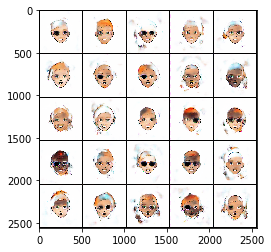

Epoch 5/50 Step 2710... Discriminator Loss: 0.5479... Generator Loss: 2.1179
Epoch 5/50 Step 2720... Discriminator Loss: 0.4487... Generator Loss: 2.5705
Epoch 5/50 Step 2730... Discriminator Loss: 0.4876... Generator Loss: 2.2371
Epoch 5/50 Step 2740... Discriminator Loss: 0.4377... Generator Loss: 2.8844
Epoch 5/50 Step 2750... Discriminator Loss: 0.4999... Generator Loss: 3.0508
Epoch 5/50 Step 2760... Discriminator Loss: 0.3991... Generator Loss: 2.9499
Epoch 5/50 Step 2770... Discriminator Loss: 1.7489... Generator Loss: 0.3697
Epoch 5/50 Step 2780... Discriminator Loss: 0.4557... Generator Loss: 2.7166
Epoch 5/50 Step 2790... Discriminator Loss: 0.4355... Generator Loss: 2.5080
Epoch 5/50 Step 2800... Discriminator Loss: 0.3908... Generator Loss: 3.3244


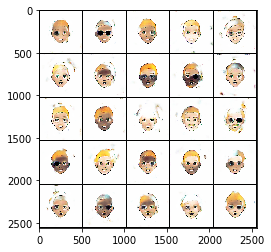

Epoch 5/50 Step 2810... Discriminator Loss: 0.4287... Generator Loss: 2.5966
Epoch 5/50 Step 2820... Discriminator Loss: 0.4508... Generator Loss: 2.3785
Epoch 5/50 Step 2830... Discriminator Loss: 0.3907... Generator Loss: 3.2174
Epoch 5/50 Step 2840... Discriminator Loss: 0.3835... Generator Loss: 3.6395
Epoch 5/50 Step 2850... Discriminator Loss: 0.5063... Generator Loss: 2.1230
Epoch 5/50 Step 2860... Discriminator Loss: 0.4201... Generator Loss: 2.8089
Epoch 5/50 Step 2870... Discriminator Loss: 0.3703... Generator Loss: 3.7303
Epoch 5/50 Step 2880... Discriminator Loss: 0.4057... Generator Loss: 3.0611
Epoch 5/50 Step 2890... Discriminator Loss: 0.3902... Generator Loss: 4.2177
Epoch 5/50 Step 2900... Discriminator Loss: 0.6624... Generator Loss: 3.6518


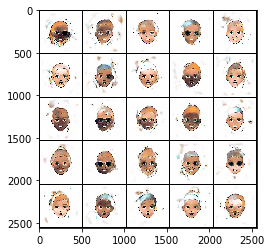

Epoch 5/50 Step 2910... Discriminator Loss: 0.4397... Generator Loss: 3.0148
Epoch 5/50 Step 2920... Discriminator Loss: 0.4251... Generator Loss: 2.9339
Epoch 5/50 Step 2930... Discriminator Loss: 0.4170... Generator Loss: 2.8467
Epoch 5/50 Step 2940... Discriminator Loss: 0.4042... Generator Loss: 3.2301
Epoch 5/50 Step 2950... Discriminator Loss: 0.3837... Generator Loss: 3.3754
Epoch 5/50 Step 2960... Discriminator Loss: 0.3973... Generator Loss: 4.2364
Epoch 5/50 Step 2970... Discriminator Loss: 0.3725... Generator Loss: 3.8118
Epoch 5/50 Step 2980... Discriminator Loss: 0.3580... Generator Loss: 3.9851
Epoch 5/50 Step 2990... Discriminator Loss: 0.3995... Generator Loss: 2.9972
Epoch 5/50 Step 3000... Discriminator Loss: 0.3718... Generator Loss: 3.6853


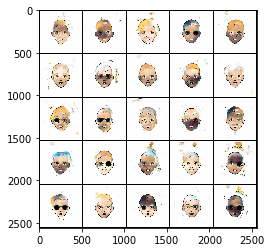

Epoch 5/50 Step 3010... Discriminator Loss: 0.3642... Generator Loss: 4.5921
Epoch 5/50 Step 3020... Discriminator Loss: 0.3522... Generator Loss: 4.2642
Epoch 5/50 Step 3030... Discriminator Loss: 0.3794... Generator Loss: 3.5945
Epoch 5/50 Step 3040... Discriminator Loss: 0.3474... Generator Loss: 4.3371
Epoch 5/50 Step 3050... Discriminator Loss: 0.4115... Generator Loss: 5.0271
Epoch 5/50 Step 3060... Discriminator Loss: 0.3796... Generator Loss: 3.3802
Epoch 5/50 Step 3070... Discriminator Loss: 0.3607... Generator Loss: 3.9709
Epoch 5/50 Step 3080... Discriminator Loss: 6.6077... Generator Loss: 6.9409
Epoch 5/50 Step 3090... Discriminator Loss: 0.6392... Generator Loss: 2.1666
Epoch 5/50 Step 3100... Discriminator Loss: 0.4843... Generator Loss: 2.2415


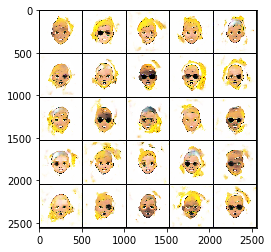

Epoch 5/50 Step 3110... Discriminator Loss: 0.4840... Generator Loss: 2.9957
Epoch 5/50 Step 3120... Discriminator Loss: 0.5182... Generator Loss: 2.1737
Epoch 6/50 Step 3130... Discriminator Loss: 0.4839... Generator Loss: 2.4869
Epoch 6/50 Step 3140... Discriminator Loss: 0.4322... Generator Loss: 2.7798
Epoch 6/50 Step 3150... Discriminator Loss: 0.4082... Generator Loss: 3.1165
Epoch 6/50 Step 3160... Discriminator Loss: 0.3759... Generator Loss: 3.4868
Epoch 6/50 Step 3170... Discriminator Loss: 0.4554... Generator Loss: 2.4256
Epoch 6/50 Step 3180... Discriminator Loss: 0.3706... Generator Loss: 4.1887
Epoch 6/50 Step 3190... Discriminator Loss: 0.3762... Generator Loss: 3.5023
Epoch 6/50 Step 3200... Discriminator Loss: 0.3683... Generator Loss: 3.7116


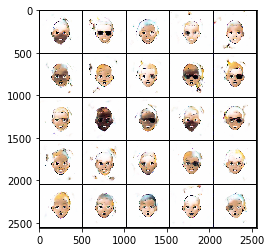

Epoch 6/50 Step 3210... Discriminator Loss: 0.3741... Generator Loss: 3.3408
Epoch 6/50 Step 3220... Discriminator Loss: 0.3775... Generator Loss: 4.4562
Epoch 6/50 Step 3230... Discriminator Loss: 0.3796... Generator Loss: 3.7906
Epoch 6/50 Step 3240... Discriminator Loss: 0.4020... Generator Loss: 4.6310
Epoch 6/50 Step 3250... Discriminator Loss: 0.3667... Generator Loss: 4.1761
Epoch 6/50 Step 3260... Discriminator Loss: 0.3938... Generator Loss: 4.0001
Epoch 6/50 Step 3270... Discriminator Loss: 0.3670... Generator Loss: 3.9780
Epoch 6/50 Step 3280... Discriminator Loss: 0.3798... Generator Loss: 3.8053
Epoch 6/50 Step 3290... Discriminator Loss: 0.3636... Generator Loss: 4.1255
Epoch 6/50 Step 3300... Discriminator Loss: 0.3573... Generator Loss: 4.3027


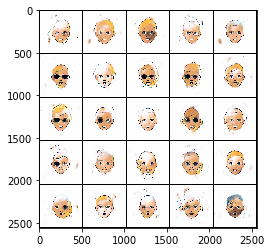

Epoch 6/50 Step 3310... Discriminator Loss: 0.8707... Generator Loss: 1.1192
Epoch 6/50 Step 3320... Discriminator Loss: 0.4997... Generator Loss: 2.5562
Epoch 6/50 Step 3330... Discriminator Loss: 0.4024... Generator Loss: 3.2875
Epoch 6/50 Step 3340... Discriminator Loss: 0.3832... Generator Loss: 3.8230
Epoch 6/50 Step 3350... Discriminator Loss: 0.3931... Generator Loss: 3.1883
Epoch 6/50 Step 3360... Discriminator Loss: 0.3656... Generator Loss: 3.7370
Epoch 6/50 Step 3370... Discriminator Loss: 0.3963... Generator Loss: 4.1487
Epoch 6/50 Step 3380... Discriminator Loss: 0.3683... Generator Loss: 3.7141
Epoch 6/50 Step 3390... Discriminator Loss: 0.3966... Generator Loss: 3.2836
Epoch 6/50 Step 3400... Discriminator Loss: 0.3563... Generator Loss: 4.2582


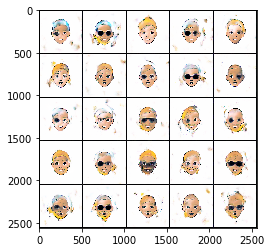

Epoch 6/50 Step 3410... Discriminator Loss: 0.3505... Generator Loss: 4.0813
Epoch 6/50 Step 3420... Discriminator Loss: 0.3538... Generator Loss: 4.0616
Epoch 6/50 Step 3430... Discriminator Loss: 0.3459... Generator Loss: 4.5245
Epoch 6/50 Step 3440... Discriminator Loss: 0.3478... Generator Loss: 4.0870
Epoch 6/50 Step 3450... Discriminator Loss: 0.5406... Generator Loss: 2.3851
Epoch 6/50 Step 3460... Discriminator Loss: 0.3934... Generator Loss: 3.2827
Epoch 6/50 Step 3470... Discriminator Loss: 0.3692... Generator Loss: 3.7340
Epoch 6/50 Step 3480... Discriminator Loss: 0.8820... Generator Loss: 1.2917
Epoch 6/50 Step 3490... Discriminator Loss: 0.3859... Generator Loss: 3.7026
Epoch 6/50 Step 3500... Discriminator Loss: 0.3753... Generator Loss: 3.5172


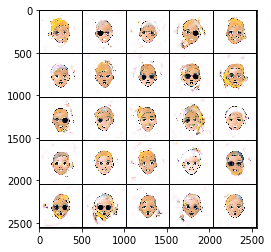

Epoch 6/50 Step 3510... Discriminator Loss: 0.3771... Generator Loss: 4.6607
Epoch 6/50 Step 3520... Discriminator Loss: 0.3654... Generator Loss: 4.0216
Epoch 6/50 Step 3530... Discriminator Loss: 0.3587... Generator Loss: 4.3420
Epoch 6/50 Step 3540... Discriminator Loss: 0.3866... Generator Loss: 3.3004
Epoch 6/50 Step 3550... Discriminator Loss: 0.3582... Generator Loss: 4.7370
Epoch 6/50 Step 3560... Discriminator Loss: 0.3507... Generator Loss: 4.3141
Epoch 6/50 Step 3570... Discriminator Loss: 0.3570... Generator Loss: 4.0381
Epoch 6/50 Step 3580... Discriminator Loss: 0.3575... Generator Loss: 3.9291
Epoch 6/50 Step 3590... Discriminator Loss: 0.3412... Generator Loss: 4.7143
Epoch 6/50 Step 3600... Discriminator Loss: 2.0011... Generator Loss: 4.2566


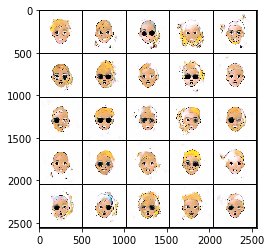

Epoch 6/50 Step 3610... Discriminator Loss: 0.6789... Generator Loss: 2.0102
Epoch 6/50 Step 3620... Discriminator Loss: 0.5109... Generator Loss: 2.4658
Epoch 6/50 Step 3630... Discriminator Loss: 0.5909... Generator Loss: 1.8218
Epoch 6/50 Step 3640... Discriminator Loss: 0.4382... Generator Loss: 3.1955
Epoch 6/50 Step 3650... Discriminator Loss: 0.4509... Generator Loss: 2.7379
Epoch 6/50 Step 3660... Discriminator Loss: 0.4199... Generator Loss: 3.1463
Epoch 6/50 Step 3670... Discriminator Loss: 0.4872... Generator Loss: 2.2938
Epoch 6/50 Step 3680... Discriminator Loss: 0.4092... Generator Loss: 3.0983
Epoch 6/50 Step 3690... Discriminator Loss: 0.4513... Generator Loss: 2.4087
Epoch 6/50 Step 3700... Discriminator Loss: 0.3985... Generator Loss: 2.9046


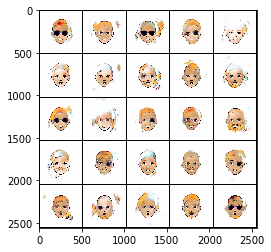

Epoch 6/50 Step 3710... Discriminator Loss: 0.3968... Generator Loss: 3.4781
Epoch 6/50 Step 3720... Discriminator Loss: 0.3761... Generator Loss: 3.5497
Epoch 6/50 Step 3730... Discriminator Loss: 0.6306... Generator Loss: 1.9718
Epoch 6/50 Step 3740... Discriminator Loss: 0.5209... Generator Loss: 2.4020
Epoch 6/50 Step 3750... Discriminator Loss: 0.4457... Generator Loss: 2.5670
Epoch 7/50 Step 3760... Discriminator Loss: 0.4134... Generator Loss: 3.3146
Epoch 7/50 Step 3770... Discriminator Loss: 0.4104... Generator Loss: 3.0731
Epoch 7/50 Step 3780... Discriminator Loss: 0.3712... Generator Loss: 3.5757
Epoch 7/50 Step 3790... Discriminator Loss: 0.3942... Generator Loss: 3.3373
Epoch 7/50 Step 3800... Discriminator Loss: 0.3672... Generator Loss: 3.5041


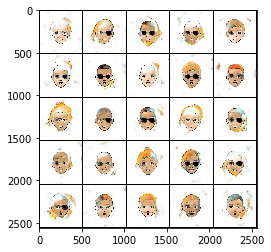

Epoch 7/50 Step 3810... Discriminator Loss: 0.3615... Generator Loss: 3.9621
Epoch 7/50 Step 3820... Discriminator Loss: 0.4140... Generator Loss: 2.7283
Epoch 7/50 Step 3830... Discriminator Loss: 0.3841... Generator Loss: 3.1837
Epoch 7/50 Step 3840... Discriminator Loss: 0.3757... Generator Loss: 3.5074
Epoch 7/50 Step 3850... Discriminator Loss: 0.3618... Generator Loss: 4.9186
Epoch 7/50 Step 3860... Discriminator Loss: 0.3675... Generator Loss: 3.9405
Epoch 7/50 Step 3870... Discriminator Loss: 0.3748... Generator Loss: 4.3093
Epoch 7/50 Step 3880... Discriminator Loss: 0.3650... Generator Loss: 4.0809
Epoch 7/50 Step 3890... Discriminator Loss: 0.3620... Generator Loss: 4.3178
Epoch 7/50 Step 3900... Discriminator Loss: 0.3830... Generator Loss: 3.3347


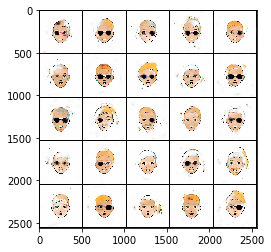

Epoch 7/50 Step 3910... Discriminator Loss: 0.3597... Generator Loss: 4.0052
Epoch 7/50 Step 3920... Discriminator Loss: 0.3508... Generator Loss: 4.5251
Epoch 7/50 Step 3930... Discriminator Loss: 0.3643... Generator Loss: 3.7317
Epoch 7/50 Step 3940... Discriminator Loss: 0.3621... Generator Loss: 4.9802
Epoch 7/50 Step 3950... Discriminator Loss: 0.3741... Generator Loss: 3.6271
Epoch 7/50 Step 3960... Discriminator Loss: 0.3915... Generator Loss: 5.5599
Epoch 7/50 Step 3970... Discriminator Loss: 0.3431... Generator Loss: 4.5980
Epoch 7/50 Step 3980... Discriminator Loss: 0.3580... Generator Loss: 4.0908
Epoch 7/50 Step 3990... Discriminator Loss: 0.3426... Generator Loss: 4.7375
Epoch 7/50 Step 4000... Discriminator Loss: 0.4118... Generator Loss: 3.1307


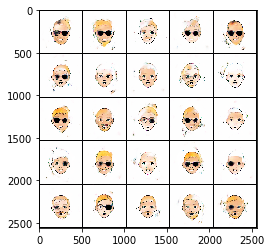

Epoch 7/50 Step 4010... Discriminator Loss: 0.3490... Generator Loss: 4.7008
Epoch 7/50 Step 4020... Discriminator Loss: 0.3732... Generator Loss: 3.9456
Epoch 7/50 Step 4030... Discriminator Loss: 0.3382... Generator Loss: 4.9770
Epoch 7/50 Step 4040... Discriminator Loss: 0.5614... Generator Loss: 5.4806
Epoch 7/50 Step 4050... Discriminator Loss: 0.8108... Generator Loss: 2.2687
Epoch 7/50 Step 4060... Discriminator Loss: 0.5740... Generator Loss: 2.2341
Epoch 7/50 Step 4070... Discriminator Loss: 0.5237... Generator Loss: 2.5444
Epoch 7/50 Step 4080... Discriminator Loss: 0.4738... Generator Loss: 2.8474
Epoch 7/50 Step 4090... Discriminator Loss: 0.4617... Generator Loss: 3.1110
Epoch 7/50 Step 4100... Discriminator Loss: 0.4460... Generator Loss: 3.2439


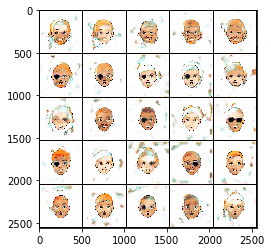

Epoch 7/50 Step 4110... Discriminator Loss: 0.4845... Generator Loss: 2.4114
Epoch 7/50 Step 4120... Discriminator Loss: 0.4299... Generator Loss: 2.7962
Epoch 7/50 Step 4130... Discriminator Loss: 0.4127... Generator Loss: 3.8054
Epoch 7/50 Step 4140... Discriminator Loss: 0.3954... Generator Loss: 3.2076
Epoch 7/50 Step 4150... Discriminator Loss: 0.3679... Generator Loss: 3.6319
Epoch 7/50 Step 4160... Discriminator Loss: 0.3682... Generator Loss: 4.1754
Epoch 7/50 Step 4170... Discriminator Loss: 0.3621... Generator Loss: 4.0052
Epoch 7/50 Step 4180... Discriminator Loss: 0.4769... Generator Loss: 2.3415
Epoch 7/50 Step 4190... Discriminator Loss: 0.3689... Generator Loss: 3.6600
Epoch 7/50 Step 4200... Discriminator Loss: 0.3601... Generator Loss: 4.2064


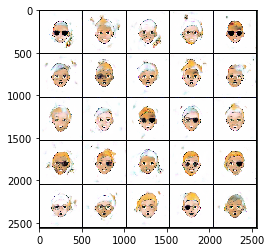

Epoch 7/50 Step 4210... Discriminator Loss: 0.3729... Generator Loss: 3.9521
Epoch 7/50 Step 4220... Discriminator Loss: 0.3710... Generator Loss: 4.2165
Epoch 7/50 Step 4230... Discriminator Loss: 0.5864... Generator Loss: 2.0003
Epoch 7/50 Step 4240... Discriminator Loss: 0.3732... Generator Loss: 3.8601
Epoch 7/50 Step 4250... Discriminator Loss: 0.3616... Generator Loss: 3.9337
Epoch 7/50 Step 4260... Discriminator Loss: 0.3556... Generator Loss: 4.3817
Epoch 7/50 Step 4270... Discriminator Loss: 0.3525... Generator Loss: 4.1746
Epoch 7/50 Step 4280... Discriminator Loss: 0.3612... Generator Loss: 3.9799
Epoch 7/50 Step 4290... Discriminator Loss: 0.3571... Generator Loss: 4.0829
Epoch 7/50 Step 4300... Discriminator Loss: 0.3574... Generator Loss: 4.7616


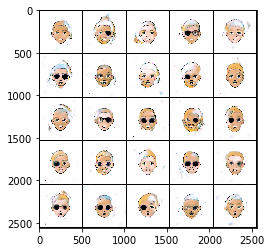

Epoch 7/50 Step 4310... Discriminator Loss: 0.3573... Generator Loss: 3.8723
Epoch 7/50 Step 4320... Discriminator Loss: 0.3542... Generator Loss: 4.5084
Epoch 7/50 Step 4330... Discriminator Loss: 0.3764... Generator Loss: 3.5352
Epoch 7/50 Step 4340... Discriminator Loss: 0.3466... Generator Loss: 4.5025
Epoch 7/50 Step 4350... Discriminator Loss: 0.3413... Generator Loss: 4.5478
Epoch 7/50 Step 4360... Discriminator Loss: 0.3479... Generator Loss: 4.2313
Epoch 7/50 Step 4370... Discriminator Loss: 0.3515... Generator Loss: 4.8251
Epoch 8/50 Step 4380... Discriminator Loss: 0.3511... Generator Loss: 4.7857
Epoch 8/50 Step 4390... Discriminator Loss: 0.3517... Generator Loss: 4.4581
Epoch 8/50 Step 4400... Discriminator Loss: 0.4533... Generator Loss: 6.0129


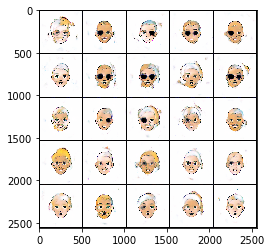

Epoch 8/50 Step 4410... Discriminator Loss: 0.4612... Generator Loss: 2.6665
Epoch 8/50 Step 4420... Discriminator Loss: 0.4176... Generator Loss: 3.0711
Epoch 8/50 Step 4430... Discriminator Loss: 0.3682... Generator Loss: 3.8860
Epoch 8/50 Step 4440... Discriminator Loss: 0.3905... Generator Loss: 3.1916
Epoch 8/50 Step 4450... Discriminator Loss: 0.3686... Generator Loss: 3.7108
Epoch 8/50 Step 4460... Discriminator Loss: 0.3656... Generator Loss: 3.8566
Epoch 8/50 Step 4470... Discriminator Loss: 0.3646... Generator Loss: 4.6102
Epoch 8/50 Step 4480... Discriminator Loss: 0.3559... Generator Loss: 4.3285
Epoch 8/50 Step 4490... Discriminator Loss: 0.3617... Generator Loss: 4.0866
Epoch 8/50 Step 4500... Discriminator Loss: 0.3497... Generator Loss: 4.1208


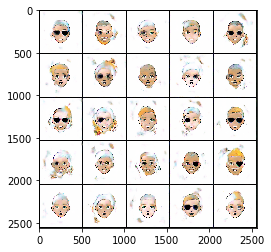

Epoch 8/50 Step 4510... Discriminator Loss: 0.3467... Generator Loss: 4.3788
Epoch 8/50 Step 4520... Discriminator Loss: 0.3522... Generator Loss: 4.3405
Epoch 8/50 Step 4530... Discriminator Loss: 1.8756... Generator Loss: 0.4897
Epoch 8/50 Step 4540... Discriminator Loss: 0.5204... Generator Loss: 2.7505
Epoch 8/50 Step 4550... Discriminator Loss: 0.4026... Generator Loss: 3.2470
Epoch 8/50 Step 4560... Discriminator Loss: 0.3687... Generator Loss: 4.0831
Epoch 8/50 Step 4570... Discriminator Loss: 0.3947... Generator Loss: 3.1519
Epoch 8/50 Step 4580... Discriminator Loss: 0.3542... Generator Loss: 4.3117
Epoch 8/50 Step 4590... Discriminator Loss: 0.3586... Generator Loss: 4.7422
Epoch 8/50 Step 4600... Discriminator Loss: 0.3862... Generator Loss: 3.4914


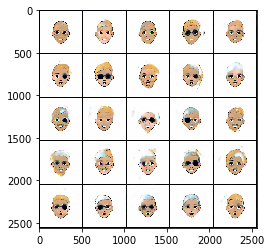

Epoch 8/50 Step 4610... Discriminator Loss: 0.3439... Generator Loss: 4.4072
Epoch 8/50 Step 4620... Discriminator Loss: 0.3512... Generator Loss: 4.4954
Epoch 8/50 Step 4630... Discriminator Loss: 0.3536... Generator Loss: 4.6595
Epoch 8/50 Step 4640... Discriminator Loss: 0.3569... Generator Loss: 3.9747
Epoch 8/50 Step 4650... Discriminator Loss: 0.3452... Generator Loss: 4.9067
Epoch 8/50 Step 4660... Discriminator Loss: 0.3442... Generator Loss: 4.3940
Epoch 8/50 Step 4670... Discriminator Loss: 0.3492... Generator Loss: 4.9280
Epoch 8/50 Step 4680... Discriminator Loss: 0.3418... Generator Loss: 4.8401
Epoch 8/50 Step 4690... Discriminator Loss: 0.3505... Generator Loss: 5.5098
Epoch 8/50 Step 4700... Discriminator Loss: 0.4207... Generator Loss: 3.3000


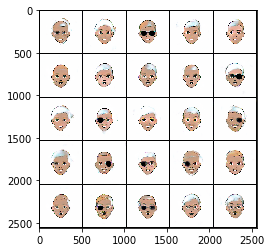

Epoch 8/50 Step 4710... Discriminator Loss: 0.3828... Generator Loss: 3.7053
Epoch 8/50 Step 4720... Discriminator Loss: 0.3451... Generator Loss: 4.5351
Epoch 8/50 Step 4730... Discriminator Loss: 0.3518... Generator Loss: 4.7823
Epoch 8/50 Step 4740... Discriminator Loss: 0.3569... Generator Loss: 4.3287
Epoch 8/50 Step 4750... Discriminator Loss: 0.3476... Generator Loss: 5.0801
Epoch 8/50 Step 4760... Discriminator Loss: 0.3416... Generator Loss: 4.9897
Epoch 8/50 Step 4770... Discriminator Loss: 0.3949... Generator Loss: 3.4722
Epoch 8/50 Step 4780... Discriminator Loss: 0.3411... Generator Loss: 4.8402
Epoch 8/50 Step 4790... Discriminator Loss: 0.3721... Generator Loss: 3.8630
Epoch 8/50 Step 4800... Discriminator Loss: 0.3420... Generator Loss: 4.6329


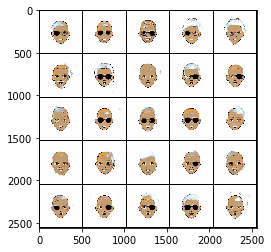

Epoch 8/50 Step 4810... Discriminator Loss: 0.3448... Generator Loss: 4.9588
Epoch 8/50 Step 4820... Discriminator Loss: 0.3491... Generator Loss: 4.4929
Epoch 8/50 Step 4830... Discriminator Loss: 0.3526... Generator Loss: 4.4002
Epoch 8/50 Step 4840... Discriminator Loss: 0.3416... Generator Loss: 5.0660
Epoch 8/50 Step 4850... Discriminator Loss: 0.4850... Generator Loss: 2.8831
Epoch 8/50 Step 4860... Discriminator Loss: 0.3431... Generator Loss: 5.0459
Epoch 8/50 Step 4870... Discriminator Loss: 0.3422... Generator Loss: 4.9854
Epoch 8/50 Step 4880... Discriminator Loss: 0.3504... Generator Loss: 4.2833
Epoch 8/50 Step 4890... Discriminator Loss: 0.3583... Generator Loss: 4.5090
Epoch 8/50 Step 4900... Discriminator Loss: 0.3623... Generator Loss: 4.1635


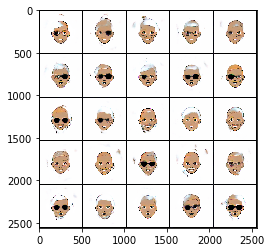

Epoch 8/50 Step 4910... Discriminator Loss: 0.3377... Generator Loss: 5.2284
Epoch 8/50 Step 4920... Discriminator Loss: 0.3370... Generator Loss: 5.2694
Epoch 8/50 Step 4930... Discriminator Loss: 0.3422... Generator Loss: 5.2305
Epoch 8/50 Step 4940... Discriminator Loss: 0.3384... Generator Loss: 5.0239
Epoch 8/50 Step 4950... Discriminator Loss: 0.3396... Generator Loss: 5.5097
Epoch 8/50 Step 4960... Discriminator Loss: 0.3352... Generator Loss: 5.0430
Epoch 8/50 Step 4970... Discriminator Loss: 0.3344... Generator Loss: 5.1568
Epoch 8/50 Step 4980... Discriminator Loss: 0.3837... Generator Loss: 3.7808
Epoch 8/50 Step 4990... Discriminator Loss: 0.3377... Generator Loss: 5.3574
Epoch 8/50 Step 5000... Discriminator Loss: 0.3476... Generator Loss: 4.9898


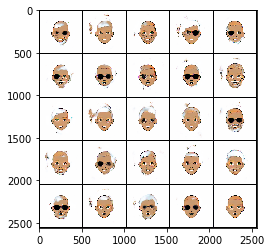

Epoch 9/50 Step 5010... Discriminator Loss: 0.3444... Generator Loss: 4.6039
Epoch 9/50 Step 5020... Discriminator Loss: 0.3581... Generator Loss: 4.5598
Epoch 9/50 Step 5030... Discriminator Loss: 0.3382... Generator Loss: 5.7069
Epoch 9/50 Step 5040... Discriminator Loss: 0.3352... Generator Loss: 5.6427
Epoch 9/50 Step 5050... Discriminator Loss: 0.3367... Generator Loss: 5.4137
Epoch 9/50 Step 5060... Discriminator Loss: 0.3383... Generator Loss: 5.1611
Epoch 9/50 Step 5070... Discriminator Loss: 0.3378... Generator Loss: 5.2275
Epoch 9/50 Step 5080... Discriminator Loss: 0.3382... Generator Loss: 5.4183
Epoch 9/50 Step 5090... Discriminator Loss: 0.3409... Generator Loss: 5.5415
Epoch 9/50 Step 5100... Discriminator Loss: 0.3936... Generator Loss: 4.0017


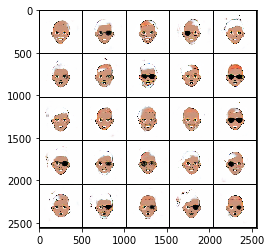

Epoch 9/50 Step 5110... Discriminator Loss: 0.3406... Generator Loss: 4.7406
Epoch 9/50 Step 5120... Discriminator Loss: 0.3439... Generator Loss: 5.3670
Epoch 9/50 Step 5130... Discriminator Loss: 0.3608... Generator Loss: 4.2379
Epoch 9/50 Step 5140... Discriminator Loss: 0.3376... Generator Loss: 5.2612
Epoch 9/50 Step 5150... Discriminator Loss: 0.3732... Generator Loss: 4.0873
Epoch 9/50 Step 5160... Discriminator Loss: 0.3392... Generator Loss: 4.9546
Epoch 9/50 Step 5170... Discriminator Loss: 0.3342... Generator Loss: 5.7739
Epoch 9/50 Step 5180... Discriminator Loss: 0.3874... Generator Loss: 3.7772
Epoch 9/50 Step 5190... Discriminator Loss: 0.8112... Generator Loss: 2.2674
Epoch 9/50 Step 5200... Discriminator Loss: 0.4741... Generator Loss: 2.8183


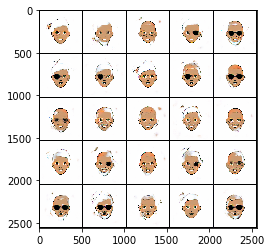

Epoch 9/50 Step 5210... Discriminator Loss: 0.3430... Generator Loss: 5.1038
Epoch 9/50 Step 5220... Discriminator Loss: 0.3402... Generator Loss: 5.0547
Epoch 9/50 Step 5230... Discriminator Loss: 0.3408... Generator Loss: 4.9138
Epoch 9/50 Step 5240... Discriminator Loss: 0.3489... Generator Loss: 4.3745
Epoch 9/50 Step 5250... Discriminator Loss: 0.3704... Generator Loss: 4.0446
Epoch 9/50 Step 5260... Discriminator Loss: 0.3359... Generator Loss: 5.0804
Epoch 9/50 Step 5270... Discriminator Loss: 0.3373... Generator Loss: 5.0865
Epoch 9/50 Step 5280... Discriminator Loss: 0.3395... Generator Loss: 5.2834
Epoch 9/50 Step 5290... Discriminator Loss: 0.3381... Generator Loss: 4.9265
Epoch 9/50 Step 5300... Discriminator Loss: 0.3383... Generator Loss: 5.5127


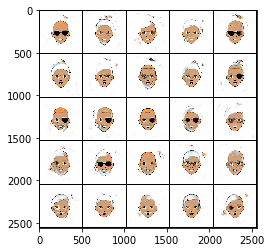

Epoch 9/50 Step 5310... Discriminator Loss: 0.3454... Generator Loss: 5.0039
Epoch 9/50 Step 5320... Discriminator Loss: 0.3500... Generator Loss: 5.3208
Epoch 9/50 Step 5330... Discriminator Loss: 0.3367... Generator Loss: 5.3786
Epoch 9/50 Step 5340... Discriminator Loss: 0.3395... Generator Loss: 5.8992
Epoch 9/50 Step 5350... Discriminator Loss: 0.3385... Generator Loss: 5.7971
Epoch 9/50 Step 5360... Discriminator Loss: 0.3448... Generator Loss: 4.8872
Epoch 9/50 Step 5370... Discriminator Loss: 0.3389... Generator Loss: 5.9867
Epoch 9/50 Step 5380... Discriminator Loss: 0.3361... Generator Loss: 5.9297
Epoch 9/50 Step 5390... Discriminator Loss: 0.3693... Generator Loss: 4.4717
Epoch 9/50 Step 5400... Discriminator Loss: 0.3379... Generator Loss: 5.1076


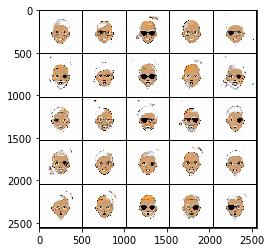

Epoch 9/50 Step 5410... Discriminator Loss: 0.3482... Generator Loss: 5.4914
Epoch 9/50 Step 5420... Discriminator Loss: 0.3344... Generator Loss: 6.2080
Epoch 9/50 Step 5430... Discriminator Loss: 0.3574... Generator Loss: 4.4497
Epoch 9/50 Step 5440... Discriminator Loss: 0.3392... Generator Loss: 5.1518
Epoch 9/50 Step 5450... Discriminator Loss: 0.3381... Generator Loss: 6.6235
Epoch 9/50 Step 5460... Discriminator Loss: 0.3507... Generator Loss: 6.0269
Epoch 9/50 Step 5470... Discriminator Loss: 0.3439... Generator Loss: 5.4292
Epoch 9/50 Step 5480... Discriminator Loss: 0.3385... Generator Loss: 5.4442
Epoch 9/50 Step 5490... Discriminator Loss: 0.3444... Generator Loss: 5.9426
Epoch 9/50 Step 5500... Discriminator Loss: 0.3372... Generator Loss: 5.3410


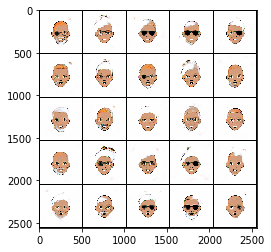

Epoch 9/50 Step 5510... Discriminator Loss: 0.3357... Generator Loss: 5.3589
Epoch 9/50 Step 5520... Discriminator Loss: 0.3453... Generator Loss: 5.6879
Epoch 9/50 Step 5530... Discriminator Loss: 0.3738... Generator Loss: 4.2506
Epoch 9/50 Step 5540... Discriminator Loss: 0.3485... Generator Loss: 5.0997
Epoch 9/50 Step 5550... Discriminator Loss: 0.3408... Generator Loss: 5.7092
Epoch 9/50 Step 5560... Discriminator Loss: 0.3405... Generator Loss: 4.7599
Epoch 9/50 Step 5570... Discriminator Loss: 0.3335... Generator Loss: 5.9729
Epoch 9/50 Step 5580... Discriminator Loss: 0.3402... Generator Loss: 4.9881
Epoch 9/50 Step 5590... Discriminator Loss: 0.3454... Generator Loss: 5.4200
Epoch 9/50 Step 5600... Discriminator Loss: 0.3323... Generator Loss: 5.5948


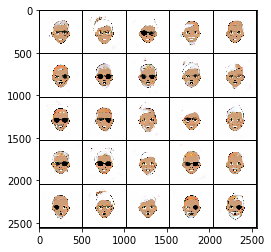

Epoch 9/50 Step 5610... Discriminator Loss: 0.3325... Generator Loss: 5.8299
Epoch 9/50 Step 5620... Discriminator Loss: 0.3569... Generator Loss: 6.9833
Epoch 10/50 Step 5630... Discriminator Loss: 0.4189... Generator Loss: 3.6290
Epoch 10/50 Step 5640... Discriminator Loss: 0.3388... Generator Loss: 4.8944
Epoch 10/50 Step 5650... Discriminator Loss: 0.3645... Generator Loss: 6.3208
Epoch 10/50 Step 5660... Discriminator Loss: 2.5023... Generator Loss: 12.5304
Epoch 10/50 Step 5670... Discriminator Loss: 0.5204... Generator Loss: 2.7688
Epoch 10/50 Step 5680... Discriminator Loss: 0.4088... Generator Loss: 3.8493
Epoch 10/50 Step 5690... Discriminator Loss: 0.4153... Generator Loss: 3.1403
Epoch 10/50 Step 5700... Discriminator Loss: 0.4081... Generator Loss: 3.2055


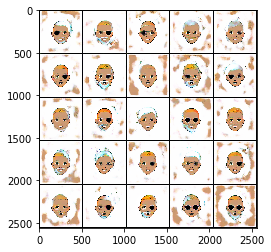

Epoch 10/50 Step 5710... Discriminator Loss: 0.3834... Generator Loss: 3.5672
Epoch 10/50 Step 5720... Discriminator Loss: 0.3666... Generator Loss: 4.4425
Epoch 10/50 Step 5730... Discriminator Loss: 0.3749... Generator Loss: 4.4767
Epoch 10/50 Step 5740... Discriminator Loss: 0.3679... Generator Loss: 3.9891
Epoch 10/50 Step 5750... Discriminator Loss: 0.3508... Generator Loss: 3.9577
Epoch 10/50 Step 5760... Discriminator Loss: 0.3534... Generator Loss: 5.0635
Epoch 10/50 Step 5770... Discriminator Loss: 0.3515... Generator Loss: 4.3451
Epoch 10/50 Step 5780... Discriminator Loss: 0.3468... Generator Loss: 4.8037
Epoch 10/50 Step 5790... Discriminator Loss: 0.3724... Generator Loss: 4.1591
Epoch 10/50 Step 5800... Discriminator Loss: 0.3496... Generator Loss: 4.1219


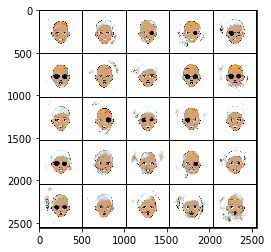

Epoch 10/50 Step 5810... Discriminator Loss: 0.3533... Generator Loss: 4.2211
Epoch 10/50 Step 5820... Discriminator Loss: 0.3666... Generator Loss: 4.0485
Epoch 10/50 Step 5830... Discriminator Loss: 0.4884... Generator Loss: 6.4244
Epoch 10/50 Step 5840... Discriminator Loss: 0.3934... Generator Loss: 4.7509
Epoch 10/50 Step 5850... Discriminator Loss: 0.3665... Generator Loss: 3.9130
Epoch 10/50 Step 5860... Discriminator Loss: 0.3378... Generator Loss: 5.5421
Epoch 10/50 Step 5870... Discriminator Loss: 0.3505... Generator Loss: 4.9360
Epoch 10/50 Step 5880... Discriminator Loss: 0.3486... Generator Loss: 5.0531
Epoch 10/50 Step 5890... Discriminator Loss: 0.3547... Generator Loss: 4.6979
Epoch 10/50 Step 5900... Discriminator Loss: 0.3509... Generator Loss: 5.8590


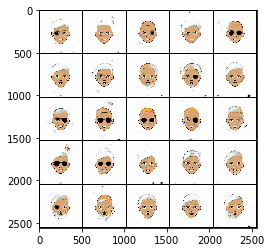

Epoch 10/50 Step 5910... Discriminator Loss: 0.3363... Generator Loss: 5.0522
Epoch 10/50 Step 5920... Discriminator Loss: 0.3575... Generator Loss: 5.1144
Epoch 10/50 Step 5930... Discriminator Loss: 0.3408... Generator Loss: 5.3913
Epoch 10/50 Step 5940... Discriminator Loss: 0.3359... Generator Loss: 5.7741
Epoch 10/50 Step 5950... Discriminator Loss: 0.3408... Generator Loss: 4.7880
Epoch 10/50 Step 5960... Discriminator Loss: 0.3385... Generator Loss: 5.1711
Epoch 10/50 Step 5970... Discriminator Loss: 0.3347... Generator Loss: 5.3464
Epoch 10/50 Step 5980... Discriminator Loss: 0.3971... Generator Loss: 3.6671
Epoch 10/50 Step 5990... Discriminator Loss: 0.3575... Generator Loss: 4.5121
Epoch 10/50 Step 6000... Discriminator Loss: 0.3435... Generator Loss: 5.0093


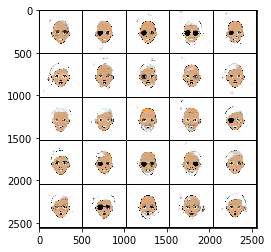

Epoch 10/50 Step 6010... Discriminator Loss: 0.3406... Generator Loss: 5.4415
Epoch 10/50 Step 6020... Discriminator Loss: 0.3916... Generator Loss: 3.9379
Epoch 10/50 Step 6030... Discriminator Loss: 0.3348... Generator Loss: 5.2483
Epoch 10/50 Step 6040... Discriminator Loss: 0.3328... Generator Loss: 5.3854
Epoch 10/50 Step 6050... Discriminator Loss: 0.3392... Generator Loss: 5.3454
Epoch 10/50 Step 6060... Discriminator Loss: 0.3693... Generator Loss: 4.6841
Epoch 10/50 Step 6070... Discriminator Loss: 0.3366... Generator Loss: 5.1341
Epoch 10/50 Step 6080... Discriminator Loss: 0.4533... Generator Loss: 2.9214
Epoch 10/50 Step 6090... Discriminator Loss: 0.3355... Generator Loss: 5.6079
Epoch 10/50 Step 6100... Discriminator Loss: 0.4304... Generator Loss: 3.4332


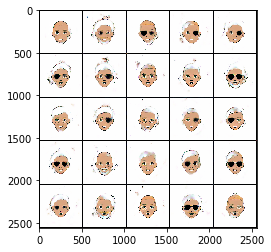

Epoch 10/50 Step 6110... Discriminator Loss: 0.3600... Generator Loss: 5.2003
Epoch 10/50 Step 6120... Discriminator Loss: 0.3376... Generator Loss: 6.0609
Epoch 10/50 Step 6130... Discriminator Loss: 0.3558... Generator Loss: 4.7740
Epoch 10/50 Step 6140... Discriminator Loss: 0.3532... Generator Loss: 4.7381
Epoch 10/50 Step 6150... Discriminator Loss: 0.3415... Generator Loss: 5.0197
Epoch 10/50 Step 6160... Discriminator Loss: 0.3356... Generator Loss: 5.5815
Epoch 10/50 Step 6170... Discriminator Loss: 0.3342... Generator Loss: 5.8044
Epoch 10/50 Step 6180... Discriminator Loss: 0.3403... Generator Loss: 5.7260
Epoch 10/50 Step 6190... Discriminator Loss: 0.3343... Generator Loss: 5.6919
Epoch 10/50 Step 6200... Discriminator Loss: 0.3457... Generator Loss: 5.6221


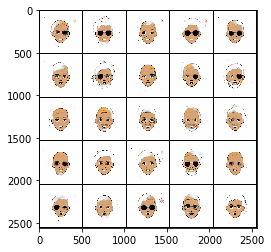

Epoch 10/50 Step 6210... Discriminator Loss: 0.3417... Generator Loss: 5.2058
Epoch 10/50 Step 6220... Discriminator Loss: 0.3322... Generator Loss: 5.6385
Epoch 10/50 Step 6230... Discriminator Loss: 0.3382... Generator Loss: 5.3272
Epoch 10/50 Step 6240... Discriminator Loss: 0.3336... Generator Loss: 6.0019
Epoch 10/50 Step 6250... Discriminator Loss: 0.3443... Generator Loss: 5.9347
Epoch 11/50 Step 6260... Discriminator Loss: 0.3601... Generator Loss: 4.2409
Epoch 11/50 Step 6270... Discriminator Loss: 0.3519... Generator Loss: 4.6938
Epoch 11/50 Step 6280... Discriminator Loss: 0.3395... Generator Loss: 5.7164
Epoch 11/50 Step 6290... Discriminator Loss: 0.3398... Generator Loss: 5.1689
Epoch 11/50 Step 6300... Discriminator Loss: 0.3373... Generator Loss: 5.5011


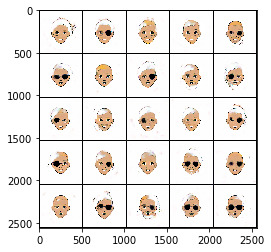

Epoch 11/50 Step 6310... Discriminator Loss: 0.3332... Generator Loss: 5.6927
Epoch 11/50 Step 6320... Discriminator Loss: 0.3356... Generator Loss: 5.1734
Epoch 11/50 Step 6330... Discriminator Loss: 0.3340... Generator Loss: 5.7945
Epoch 11/50 Step 6340... Discriminator Loss: 0.3380... Generator Loss: 5.4062
Epoch 11/50 Step 6350... Discriminator Loss: 0.3420... Generator Loss: 5.5022
Epoch 11/50 Step 6360... Discriminator Loss: 0.3331... Generator Loss: 5.5677
Epoch 11/50 Step 6370... Discriminator Loss: 0.3358... Generator Loss: 6.0592
Epoch 11/50 Step 6380... Discriminator Loss: 0.3371... Generator Loss: 4.9577
Epoch 11/50 Step 6390... Discriminator Loss: 0.3363... Generator Loss: 6.2624
Epoch 11/50 Step 6400... Discriminator Loss: 0.3507... Generator Loss: 4.7057


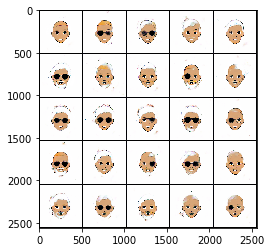

Epoch 11/50 Step 6410... Discriminator Loss: 0.3348... Generator Loss: 5.6543
Epoch 11/50 Step 6420... Discriminator Loss: 0.3469... Generator Loss: 5.1234
Epoch 11/50 Step 6430... Discriminator Loss: 0.3381... Generator Loss: 5.3253
Epoch 11/50 Step 6440... Discriminator Loss: 0.3343... Generator Loss: 5.9132
Epoch 11/50 Step 6450... Discriminator Loss: 0.3998... Generator Loss: 4.3586
Epoch 11/50 Step 6460... Discriminator Loss: 0.3501... Generator Loss: 6.0867
Epoch 11/50 Step 6470... Discriminator Loss: 0.3338... Generator Loss: 5.5007
Epoch 11/50 Step 6480... Discriminator Loss: 0.3384... Generator Loss: 6.2862
Epoch 11/50 Step 6490... Discriminator Loss: 0.3345... Generator Loss: 5.2761
Epoch 11/50 Step 6500... Discriminator Loss: 0.3436... Generator Loss: 5.1356


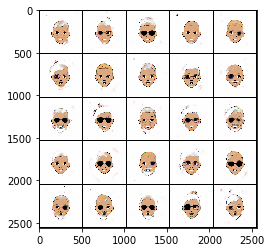

Epoch 11/50 Step 6510... Discriminator Loss: 0.3364... Generator Loss: 6.0228
Epoch 11/50 Step 6520... Discriminator Loss: 0.3313... Generator Loss: 5.8661
Epoch 11/50 Step 6530... Discriminator Loss: 0.3303... Generator Loss: 6.4005
Epoch 11/50 Step 6540... Discriminator Loss: 0.3321... Generator Loss: 5.3772
Epoch 11/50 Step 6550... Discriminator Loss: 0.3389... Generator Loss: 6.2375
Epoch 11/50 Step 6560... Discriminator Loss: 310.1744... Generator Loss: 196.6306
Epoch 11/50 Step 6570... Discriminator Loss: 305.3854... Generator Loss: 8.7013
Epoch 11/50 Step 6580... Discriminator Loss: 2.6097... Generator Loss: 10.2387
Epoch 11/50 Step 6590... Discriminator Loss: 3.3809... Generator Loss: 8.8417
Epoch 11/50 Step 6600... Discriminator Loss: 1.5741... Generator Loss: 13.1953


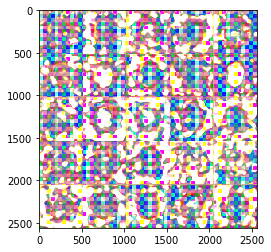

Epoch 11/50 Step 6610... Discriminator Loss: 3.6637... Generator Loss: 7.1694
Epoch 11/50 Step 6620... Discriminator Loss: 5.6256... Generator Loss: 0.7224
Epoch 11/50 Step 6630... Discriminator Loss: 2.1781... Generator Loss: 3.9928
Epoch 11/50 Step 6640... Discriminator Loss: 0.8116... Generator Loss: 7.6533
Epoch 11/50 Step 6650... Discriminator Loss: 0.6790... Generator Loss: 7.6011
Epoch 11/50 Step 6660... Discriminator Loss: 0.4898... Generator Loss: 6.1514
Epoch 11/50 Step 6670... Discriminator Loss: 0.8276... Generator Loss: 4.3210
Epoch 11/50 Step 6680... Discriminator Loss: 0.7130... Generator Loss: 3.9262
Epoch 11/50 Step 6690... Discriminator Loss: 0.5806... Generator Loss: 4.3899
Epoch 11/50 Step 6700... Discriminator Loss: 0.7477... Generator Loss: 5.1904


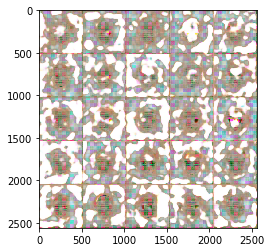

Epoch 11/50 Step 6710... Discriminator Loss: 0.7795... Generator Loss: 4.0443
Epoch 11/50 Step 6720... Discriminator Loss: 1.0381... Generator Loss: 1.7995
Epoch 11/50 Step 6730... Discriminator Loss: 0.8779... Generator Loss: 2.9610
Epoch 11/50 Step 6740... Discriminator Loss: 0.7367... Generator Loss: 5.0851
Epoch 11/50 Step 6750... Discriminator Loss: 0.5787... Generator Loss: 4.1557
Epoch 11/50 Step 6760... Discriminator Loss: 0.7363... Generator Loss: 1.8087
Epoch 11/50 Step 6770... Discriminator Loss: 0.5572... Generator Loss: 3.7905
Epoch 11/50 Step 6780... Discriminator Loss: 1.6399... Generator Loss: 0.7410
Epoch 11/50 Step 6790... Discriminator Loss: 0.6432... Generator Loss: 3.8891
Epoch 11/50 Step 6800... Discriminator Loss: 0.4539... Generator Loss: 4.8186


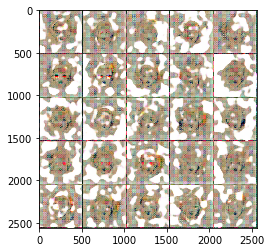

Epoch 11/50 Step 6810... Discriminator Loss: 0.8662... Generator Loss: 1.8970
Epoch 11/50 Step 6820... Discriminator Loss: 0.6441... Generator Loss: 2.1977
Epoch 11/50 Step 6830... Discriminator Loss: 0.6585... Generator Loss: 2.4917
Epoch 11/50 Step 6840... Discriminator Loss: 0.5374... Generator Loss: 3.2151
Epoch 11/50 Step 6850... Discriminator Loss: 0.8503... Generator Loss: 1.4295
Epoch 11/50 Step 6860... Discriminator Loss: 0.5273... Generator Loss: 2.7382
Epoch 11/50 Step 6870... Discriminator Loss: 0.5301... Generator Loss: 2.1959
Epoch 12/50 Step 6880... Discriminator Loss: 0.5412... Generator Loss: 3.6460
Epoch 12/50 Step 6890... Discriminator Loss: 0.6837... Generator Loss: 2.2495
Epoch 12/50 Step 6900... Discriminator Loss: 0.4833... Generator Loss: 2.8554


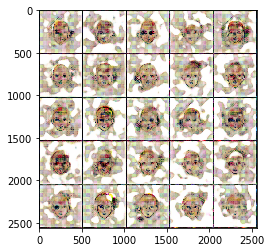

Epoch 12/50 Step 6910... Discriminator Loss: 1.2729... Generator Loss: 5.1689
Epoch 12/50 Step 6920... Discriminator Loss: 1.6253... Generator Loss: 6.7121
Epoch 12/50 Step 6930... Discriminator Loss: 0.4603... Generator Loss: 3.7790
Epoch 12/50 Step 6940... Discriminator Loss: 0.5909... Generator Loss: 2.5765
Epoch 12/50 Step 6950... Discriminator Loss: 0.5221... Generator Loss: 2.6244
Epoch 12/50 Step 6960... Discriminator Loss: 0.5791... Generator Loss: 1.8879
Epoch 12/50 Step 6970... Discriminator Loss: 0.6374... Generator Loss: 2.2153
Epoch 12/50 Step 6980... Discriminator Loss: 0.7102... Generator Loss: 1.7895
Epoch 12/50 Step 6990... Discriminator Loss: 0.5950... Generator Loss: 3.4760
Epoch 12/50 Step 7000... Discriminator Loss: 0.5025... Generator Loss: 3.9814


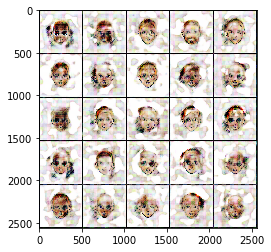

Epoch 12/50 Step 7010... Discriminator Loss: 3.2445... Generator Loss: 0.0762
Epoch 12/50 Step 7020... Discriminator Loss: 1.7498... Generator Loss: 0.4173
Epoch 12/50 Step 7030... Discriminator Loss: 0.7158... Generator Loss: 1.9712
Epoch 12/50 Step 7040... Discriminator Loss: 0.8597... Generator Loss: 1.0776
Epoch 12/50 Step 7050... Discriminator Loss: 0.8036... Generator Loss: 3.9773
Epoch 12/50 Step 7060... Discriminator Loss: 0.6944... Generator Loss: 1.6452
Epoch 12/50 Step 7070... Discriminator Loss: 2.2617... Generator Loss: 0.2224
Epoch 12/50 Step 7080... Discriminator Loss: 0.6690... Generator Loss: 2.6134
Epoch 12/50 Step 7090... Discriminator Loss: 0.5606... Generator Loss: 2.7081
Epoch 12/50 Step 7100... Discriminator Loss: 0.5773... Generator Loss: 2.6061


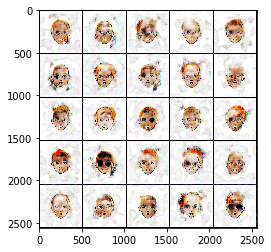

Epoch 12/50 Step 7110... Discriminator Loss: 1.1780... Generator Loss: 0.7764
Epoch 12/50 Step 7120... Discriminator Loss: 0.5572... Generator Loss: 2.7974
Epoch 12/50 Step 7130... Discriminator Loss: 0.6362... Generator Loss: 1.5899
Epoch 12/50 Step 7140... Discriminator Loss: 0.5538... Generator Loss: 2.3746
Epoch 12/50 Step 7150... Discriminator Loss: 0.9305... Generator Loss: 4.3691
Epoch 12/50 Step 7160... Discriminator Loss: 0.6135... Generator Loss: 2.5656
Epoch 12/50 Step 7170... Discriminator Loss: 1.6284... Generator Loss: 4.6325
Epoch 12/50 Step 7180... Discriminator Loss: 0.5834... Generator Loss: 2.3769
Epoch 12/50 Step 7190... Discriminator Loss: 0.5954... Generator Loss: 1.7824
Epoch 12/50 Step 7200... Discriminator Loss: 0.7211... Generator Loss: 1.2871


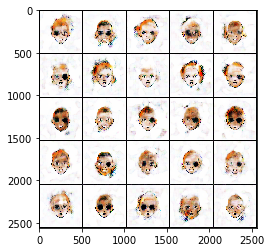

Epoch 12/50 Step 7210... Discriminator Loss: 0.5316... Generator Loss: 2.3471
Epoch 12/50 Step 7220... Discriminator Loss: 0.5571... Generator Loss: 2.8910
Epoch 12/50 Step 7230... Discriminator Loss: 0.6702... Generator Loss: 1.5601
Epoch 12/50 Step 7240... Discriminator Loss: 0.5524... Generator Loss: 2.1765
Epoch 12/50 Step 7250... Discriminator Loss: 0.6051... Generator Loss: 1.7027
Epoch 12/50 Step 7260... Discriminator Loss: 0.6051... Generator Loss: 1.9030
Epoch 12/50 Step 7270... Discriminator Loss: 0.7122... Generator Loss: 1.4399
Epoch 12/50 Step 7280... Discriminator Loss: 0.4888... Generator Loss: 2.4608
Epoch 12/50 Step 7290... Discriminator Loss: 0.7283... Generator Loss: 1.3635
Epoch 12/50 Step 7300... Discriminator Loss: 1.0704... Generator Loss: 4.0732


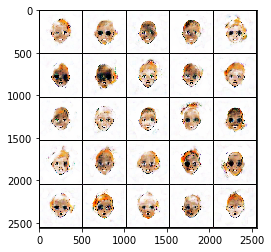

Epoch 12/50 Step 7310... Discriminator Loss: 0.5700... Generator Loss: 2.0387
Epoch 12/50 Step 7320... Discriminator Loss: 0.6397... Generator Loss: 2.0176
Epoch 12/50 Step 7330... Discriminator Loss: 0.7708... Generator Loss: 1.1119
Epoch 12/50 Step 7340... Discriminator Loss: 0.6089... Generator Loss: 1.6905
Epoch 12/50 Step 7350... Discriminator Loss: 0.5851... Generator Loss: 1.9522
Epoch 12/50 Step 7360... Discriminator Loss: 0.8320... Generator Loss: 3.7746
Epoch 12/50 Step 7370... Discriminator Loss: 0.5687... Generator Loss: 2.0783
Epoch 12/50 Step 7380... Discriminator Loss: 0.7236... Generator Loss: 1.5217
Epoch 12/50 Step 7390... Discriminator Loss: 0.5662... Generator Loss: 2.6164
Epoch 12/50 Step 7400... Discriminator Loss: 0.6989... Generator Loss: 1.4673


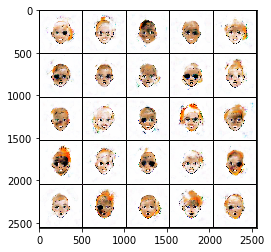

Epoch 12/50 Step 7410... Discriminator Loss: 0.6802... Generator Loss: 1.3950
Epoch 12/50 Step 7420... Discriminator Loss: 0.5931... Generator Loss: 1.8097
Epoch 12/50 Step 7430... Discriminator Loss: 0.7630... Generator Loss: 3.4804
Epoch 12/50 Step 7440... Discriminator Loss: 0.5972... Generator Loss: 1.8029
Epoch 12/50 Step 7450... Discriminator Loss: 0.5890... Generator Loss: 1.7932
Epoch 12/50 Step 7460... Discriminator Loss: 0.5150... Generator Loss: 2.4303
Epoch 12/50 Step 7470... Discriminator Loss: 0.6104... Generator Loss: 3.0522
Epoch 12/50 Step 7480... Discriminator Loss: 0.5121... Generator Loss: 2.3510
Epoch 12/50 Step 7490... Discriminator Loss: 0.4771... Generator Loss: 2.6594
Epoch 12/50 Step 7500... Discriminator Loss: 1.1001... Generator Loss: 4.1746


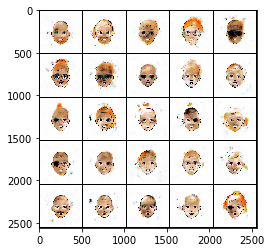

Epoch 13/50 Step 7510... Discriminator Loss: 0.5525... Generator Loss: 2.9261
Epoch 13/50 Step 7520... Discriminator Loss: 0.5776... Generator Loss: 1.8434
Epoch 13/50 Step 7530... Discriminator Loss: 0.4667... Generator Loss: 3.1019
Epoch 13/50 Step 7540... Discriminator Loss: 0.6645... Generator Loss: 1.4096
Epoch 13/50 Step 7550... Discriminator Loss: 0.5577... Generator Loss: 1.6082
Epoch 13/50 Step 7560... Discriminator Loss: 0.4917... Generator Loss: 2.3382
Epoch 13/50 Step 7570... Discriminator Loss: 0.5547... Generator Loss: 2.0435
Epoch 13/50 Step 7580... Discriminator Loss: 0.5035... Generator Loss: 2.4777
Epoch 13/50 Step 7590... Discriminator Loss: 0.4810... Generator Loss: 2.3726
Epoch 13/50 Step 7600... Discriminator Loss: 0.5816... Generator Loss: 1.8149


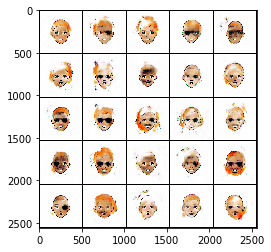

Epoch 13/50 Step 7610... Discriminator Loss: 0.4819... Generator Loss: 3.1181
Epoch 13/50 Step 7620... Discriminator Loss: 0.5860... Generator Loss: 3.0296
Epoch 13/50 Step 7630... Discriminator Loss: 0.5723... Generator Loss: 2.1040
Epoch 13/50 Step 7640... Discriminator Loss: 0.5048... Generator Loss: 2.2850
Epoch 13/50 Step 7650... Discriminator Loss: 0.6621... Generator Loss: 3.2551
Epoch 13/50 Step 7660... Discriminator Loss: 0.5251... Generator Loss: 2.7222
Epoch 13/50 Step 7670... Discriminator Loss: 0.5677... Generator Loss: 1.8104
Epoch 13/50 Step 7680... Discriminator Loss: 0.7057... Generator Loss: 1.3450
Epoch 13/50 Step 7690... Discriminator Loss: 0.4693... Generator Loss: 2.8165
Epoch 13/50 Step 7700... Discriminator Loss: 0.5591... Generator Loss: 3.2694


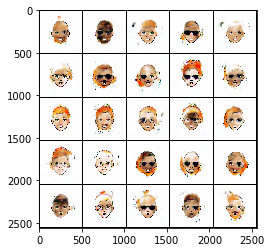

Epoch 13/50 Step 7710... Discriminator Loss: 1.3034... Generator Loss: 0.6956
Epoch 13/50 Step 7720... Discriminator Loss: 0.4623... Generator Loss: 2.5307
Epoch 13/50 Step 7730... Discriminator Loss: 0.5131... Generator Loss: 2.2586
Epoch 13/50 Step 7740... Discriminator Loss: 0.4784... Generator Loss: 2.1503
Epoch 13/50 Step 7750... Discriminator Loss: 0.5281... Generator Loss: 2.0424
Epoch 13/50 Step 7760... Discriminator Loss: 0.4446... Generator Loss: 2.5689
Epoch 13/50 Step 7770... Discriminator Loss: 0.5477... Generator Loss: 1.8967
Epoch 13/50 Step 7780... Discriminator Loss: 0.5108... Generator Loss: 3.1676
Epoch 13/50 Step 7790... Discriminator Loss: 0.5031... Generator Loss: 2.2666
Epoch 13/50 Step 7800... Discriminator Loss: 0.4590... Generator Loss: 3.4919


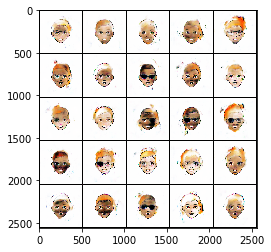

Epoch 13/50 Step 7810... Discriminator Loss: 0.4940... Generator Loss: 2.1750
Epoch 13/50 Step 7820... Discriminator Loss: 1.1872... Generator Loss: 0.7800
Epoch 13/50 Step 7830... Discriminator Loss: 0.5067... Generator Loss: 2.3337
Epoch 13/50 Step 7840... Discriminator Loss: 0.4958... Generator Loss: 2.7645
Epoch 13/50 Step 7850... Discriminator Loss: 0.5070... Generator Loss: 2.4513
Epoch 13/50 Step 7860... Discriminator Loss: 0.4405... Generator Loss: 2.8140
Epoch 13/50 Step 7870... Discriminator Loss: 0.4456... Generator Loss: 2.5467
Epoch 13/50 Step 7880... Discriminator Loss: 0.4525... Generator Loss: 2.7355
Epoch 13/50 Step 7890... Discriminator Loss: 0.5171... Generator Loss: 3.4841
Epoch 13/50 Step 7900... Discriminator Loss: 0.4456... Generator Loss: 2.8031


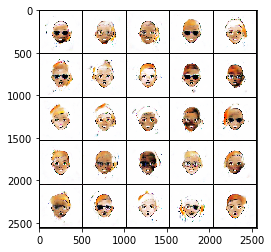

Epoch 13/50 Step 7910... Discriminator Loss: 0.4410... Generator Loss: 3.1908
Epoch 13/50 Step 7920... Discriminator Loss: 0.5482... Generator Loss: 3.6106
Epoch 13/50 Step 7930... Discriminator Loss: 0.7955... Generator Loss: 1.1555
Epoch 13/50 Step 7940... Discriminator Loss: 0.4973... Generator Loss: 2.5960
Epoch 13/50 Step 7950... Discriminator Loss: 0.4408... Generator Loss: 3.3875
Epoch 13/50 Step 7960... Discriminator Loss: 0.4365... Generator Loss: 2.6331
Epoch 13/50 Step 7970... Discriminator Loss: 0.5133... Generator Loss: 2.0390
Epoch 13/50 Step 7980... Discriminator Loss: 0.4548... Generator Loss: 2.6332
Epoch 13/50 Step 7990... Discriminator Loss: 0.4513... Generator Loss: 2.5699
Epoch 13/50 Step 8000... Discriminator Loss: 0.5495... Generator Loss: 2.3326


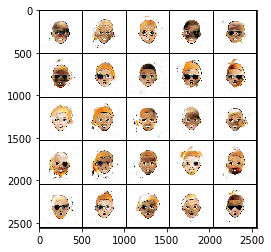

Epoch 13/50 Step 8010... Discriminator Loss: 0.4380... Generator Loss: 3.0485
Epoch 13/50 Step 8020... Discriminator Loss: 0.4843... Generator Loss: 3.2475
Epoch 13/50 Step 8030... Discriminator Loss: 0.7642... Generator Loss: 4.2944
Epoch 13/50 Step 8040... Discriminator Loss: 0.5140... Generator Loss: 4.9237
Epoch 13/50 Step 8050... Discriminator Loss: 0.6394... Generator Loss: 3.9573
Epoch 13/50 Step 8060... Discriminator Loss: 0.5818... Generator Loss: 1.9145
Epoch 13/50 Step 8070... Discriminator Loss: 0.4349... Generator Loss: 2.6859
Epoch 13/50 Step 8080... Discriminator Loss: 0.5430... Generator Loss: 3.4805
Epoch 13/50 Step 8090... Discriminator Loss: 0.4132... Generator Loss: 3.7297
Epoch 13/50 Step 8100... Discriminator Loss: 0.5228... Generator Loss: 4.3839


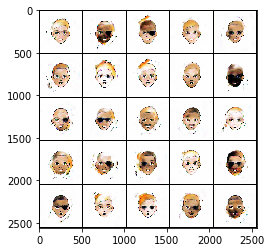

Epoch 13/50 Step 8110... Discriminator Loss: 0.4189... Generator Loss: 2.8233
Epoch 13/50 Step 8120... Discriminator Loss: 0.4813... Generator Loss: 2.2733
Epoch 14/50 Step 8130... Discriminator Loss: 0.4753... Generator Loss: 2.5010
Epoch 14/50 Step 8140... Discriminator Loss: 0.4356... Generator Loss: 2.7036
Epoch 14/50 Step 8150... Discriminator Loss: 2.6595... Generator Loss: 7.8133
Epoch 14/50 Step 8160... Discriminator Loss: 0.4211... Generator Loss: 3.1497
Epoch 14/50 Step 8170... Discriminator Loss: 0.5038... Generator Loss: 2.2926
Epoch 14/50 Step 8180... Discriminator Loss: 0.3893... Generator Loss: 3.6340
Epoch 14/50 Step 8190... Discriminator Loss: 0.4778... Generator Loss: 2.2823
Epoch 14/50 Step 8200... Discriminator Loss: 0.4364... Generator Loss: 3.1779


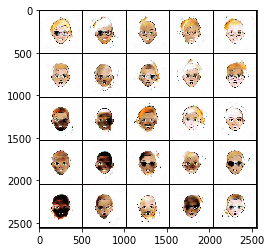

Epoch 14/50 Step 8210... Discriminator Loss: 0.4538... Generator Loss: 2.3944
Epoch 14/50 Step 8220... Discriminator Loss: 0.4519... Generator Loss: 3.8558
Epoch 14/50 Step 8230... Discriminator Loss: 0.4141... Generator Loss: 2.8404
Epoch 14/50 Step 8240... Discriminator Loss: 1.4928... Generator Loss: 6.2368
Epoch 14/50 Step 8250... Discriminator Loss: 0.4446... Generator Loss: 3.2079
Epoch 14/50 Step 8260... Discriminator Loss: 0.4209... Generator Loss: 3.6689
Epoch 14/50 Step 8270... Discriminator Loss: 0.4508... Generator Loss: 3.0997
Epoch 14/50 Step 8280... Discriminator Loss: 0.5159... Generator Loss: 2.0266
Epoch 14/50 Step 8290... Discriminator Loss: 0.4217... Generator Loss: 3.3708
Epoch 14/50 Step 8300... Discriminator Loss: 0.4098... Generator Loss: 3.3295


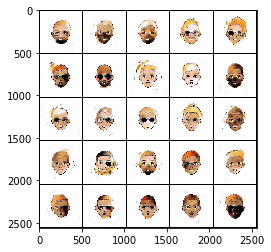

Epoch 14/50 Step 8310... Discriminator Loss: 0.4839... Generator Loss: 2.3244
Epoch 14/50 Step 8320... Discriminator Loss: 0.4716... Generator Loss: 2.2489
Epoch 14/50 Step 8330... Discriminator Loss: 0.4780... Generator Loss: 4.0647
Epoch 14/50 Step 8340... Discriminator Loss: 0.4144... Generator Loss: 2.8020
Epoch 14/50 Step 8350... Discriminator Loss: 0.4254... Generator Loss: 3.5232
Epoch 14/50 Step 8360... Discriminator Loss: 1.2563... Generator Loss: 0.7132
Epoch 14/50 Step 8370... Discriminator Loss: 0.5259... Generator Loss: 2.6704
Epoch 14/50 Step 8380... Discriminator Loss: 0.4552... Generator Loss: 2.2953
Epoch 14/50 Step 8390... Discriminator Loss: 0.4406... Generator Loss: 2.9935
Epoch 14/50 Step 8400... Discriminator Loss: 0.3949... Generator Loss: 3.1074


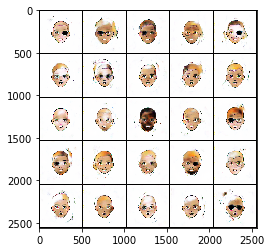

Epoch 14/50 Step 8410... Discriminator Loss: 0.4011... Generator Loss: 3.0622
Epoch 14/50 Step 8420... Discriminator Loss: 0.3971... Generator Loss: 3.0814
Epoch 14/50 Step 8430... Discriminator Loss: 0.3984... Generator Loss: 3.6467
Epoch 14/50 Step 8440... Discriminator Loss: 0.5741... Generator Loss: 4.5547
Epoch 14/50 Step 8450... Discriminator Loss: 0.6217... Generator Loss: 1.9555
Epoch 14/50 Step 8460... Discriminator Loss: 0.4028... Generator Loss: 3.0375
Epoch 14/50 Step 8470... Discriminator Loss: 0.4126... Generator Loss: 3.0725
Epoch 14/50 Step 8480... Discriminator Loss: 0.4145... Generator Loss: 2.9112
Epoch 14/50 Step 8490... Discriminator Loss: 0.3931... Generator Loss: 3.1803
Epoch 14/50 Step 8500... Discriminator Loss: 0.4142... Generator Loss: 3.2609


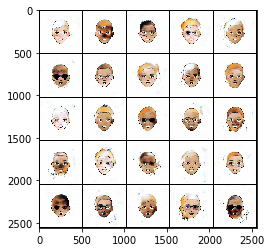

Epoch 14/50 Step 8510... Discriminator Loss: 0.3911... Generator Loss: 3.6412
Epoch 14/50 Step 8520... Discriminator Loss: 0.4474... Generator Loss: 2.7108
Epoch 14/50 Step 8530... Discriminator Loss: 0.3893... Generator Loss: 3.9872
Epoch 14/50 Step 8540... Discriminator Loss: 0.3778... Generator Loss: 3.6378
Epoch 14/50 Step 8550... Discriminator Loss: 0.5254... Generator Loss: 4.2910
Epoch 14/50 Step 8560... Discriminator Loss: 0.4149... Generator Loss: 3.1088
Epoch 14/50 Step 8570... Discriminator Loss: 0.3713... Generator Loss: 3.7065
Epoch 14/50 Step 8580... Discriminator Loss: 0.4274... Generator Loss: 2.7880
Epoch 14/50 Step 8590... Discriminator Loss: 1.2174... Generator Loss: 0.9412
Epoch 14/50 Step 8600... Discriminator Loss: 0.6578... Generator Loss: 1.5304


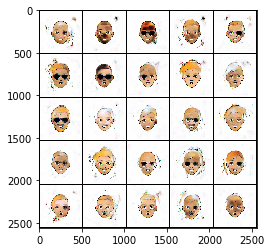

Epoch 14/50 Step 8610... Discriminator Loss: 0.5143... Generator Loss: 3.8861
Epoch 14/50 Step 8620... Discriminator Loss: 0.4243... Generator Loss: 2.9033
Epoch 14/50 Step 8630... Discriminator Loss: 0.4090... Generator Loss: 3.2056
Epoch 14/50 Step 8640... Discriminator Loss: 0.3764... Generator Loss: 3.7079
Epoch 14/50 Step 8650... Discriminator Loss: 0.4605... Generator Loss: 2.6590
Epoch 14/50 Step 8660... Discriminator Loss: 0.4067... Generator Loss: 3.3088
Epoch 14/50 Step 8670... Discriminator Loss: 0.3863... Generator Loss: 3.2888
Epoch 14/50 Step 8680... Discriminator Loss: 0.3894... Generator Loss: 3.5460
Epoch 14/50 Step 8690... Discriminator Loss: 0.3800... Generator Loss: 3.6547
Epoch 14/50 Step 8700... Discriminator Loss: 0.3876... Generator Loss: 4.0945


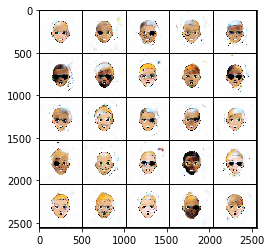

Epoch 14/50 Step 8710... Discriminator Loss: 0.4200... Generator Loss: 3.1203
Epoch 14/50 Step 8720... Discriminator Loss: 0.3968... Generator Loss: 3.4005
Epoch 14/50 Step 8730... Discriminator Loss: 0.4266... Generator Loss: 2.8617
Epoch 14/50 Step 8740... Discriminator Loss: 0.3817... Generator Loss: 3.8144
Epoch 14/50 Step 8750... Discriminator Loss: 0.4374... Generator Loss: 2.8119
Epoch 15/50 Step 8760... Discriminator Loss: 0.3672... Generator Loss: 4.0185
Epoch 15/50 Step 8770... Discriminator Loss: 0.4447... Generator Loss: 3.3777
Epoch 15/50 Step 8780... Discriminator Loss: 0.3645... Generator Loss: 4.0726
Epoch 15/50 Step 8790... Discriminator Loss: 0.3984... Generator Loss: 4.0420
Epoch 15/50 Step 8800... Discriminator Loss: 0.3883... Generator Loss: 3.2611


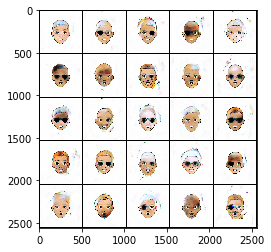

Epoch 15/50 Step 8810... Discriminator Loss: 0.3848... Generator Loss: 3.3266
Epoch 15/50 Step 8820... Discriminator Loss: 0.3799... Generator Loss: 3.4760
Epoch 15/50 Step 8830... Discriminator Loss: 0.4023... Generator Loss: 3.5426
Epoch 15/50 Step 8840... Discriminator Loss: 0.3808... Generator Loss: 3.6757
Epoch 15/50 Step 8850... Discriminator Loss: 0.3840... Generator Loss: 4.2043
Epoch 15/50 Step 8860... Discriminator Loss: 0.3871... Generator Loss: 3.3928
Epoch 15/50 Step 8870... Discriminator Loss: 0.7880... Generator Loss: 3.6502
Epoch 15/50 Step 8880... Discriminator Loss: 0.6162... Generator Loss: 1.7254
Epoch 15/50 Step 8890... Discriminator Loss: 0.4684... Generator Loss: 3.1700
Epoch 15/50 Step 8900... Discriminator Loss: 0.4725... Generator Loss: 2.4818


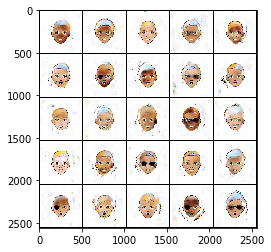

Epoch 15/50 Step 8910... Discriminator Loss: 0.4631... Generator Loss: 3.5986
Epoch 15/50 Step 8920... Discriminator Loss: 0.4179... Generator Loss: 2.8319
Epoch 15/50 Step 8930... Discriminator Loss: 0.4926... Generator Loss: 2.4112
Epoch 15/50 Step 8940... Discriminator Loss: 0.4000... Generator Loss: 3.8807
Epoch 15/50 Step 8950... Discriminator Loss: 0.4121... Generator Loss: 2.8544
Epoch 15/50 Step 8960... Discriminator Loss: 0.4036... Generator Loss: 4.2232
Epoch 15/50 Step 8970... Discriminator Loss: 0.3646... Generator Loss: 4.4133
Epoch 15/50 Step 8980... Discriminator Loss: 0.5621... Generator Loss: 1.9546
Epoch 15/50 Step 8990... Discriminator Loss: 0.3619... Generator Loss: 4.1426
Epoch 15/50 Step 9000... Discriminator Loss: 0.3838... Generator Loss: 3.3398


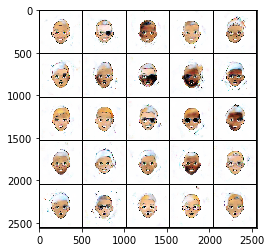

Epoch 15/50 Step 9010... Discriminator Loss: 0.3545... Generator Loss: 4.3414
Epoch 15/50 Step 9020... Discriminator Loss: 0.5751... Generator Loss: 2.1401
Epoch 15/50 Step 9030... Discriminator Loss: 0.3766... Generator Loss: 3.6423
Epoch 15/50 Step 9040... Discriminator Loss: 0.4600... Generator Loss: 2.6871
Epoch 15/50 Step 9050... Discriminator Loss: 0.3566... Generator Loss: 4.3847
Epoch 15/50 Step 9060... Discriminator Loss: 0.3968... Generator Loss: 3.2474
Epoch 15/50 Step 9070... Discriminator Loss: 0.4153... Generator Loss: 4.4373
Epoch 15/50 Step 9080... Discriminator Loss: 0.3644... Generator Loss: 3.8822
Epoch 15/50 Step 9090... Discriminator Loss: 0.3684... Generator Loss: 4.3180
Epoch 15/50 Step 9100... Discriminator Loss: 0.3732... Generator Loss: 4.0662


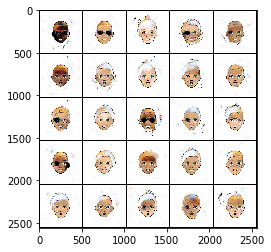

Epoch 15/50 Step 9110... Discriminator Loss: 0.4026... Generator Loss: 3.1728
Epoch 15/50 Step 9120... Discriminator Loss: 0.3758... Generator Loss: 4.5242
Epoch 15/50 Step 9130... Discriminator Loss: 0.3616... Generator Loss: 3.9303
Epoch 15/50 Step 9140... Discriminator Loss: 0.3681... Generator Loss: 4.1656
Epoch 15/50 Step 9150... Discriminator Loss: 0.3717... Generator Loss: 4.6190
Epoch 15/50 Step 9160... Discriminator Loss: 0.3642... Generator Loss: 4.1439
Epoch 15/50 Step 9170... Discriminator Loss: 1.9517... Generator Loss: 7.8179
Epoch 15/50 Step 9180... Discriminator Loss: 0.4822... Generator Loss: 2.8372
Epoch 15/50 Step 9190... Discriminator Loss: 0.4360... Generator Loss: 3.1049
Epoch 15/50 Step 9200... Discriminator Loss: 0.3912... Generator Loss: 3.5178


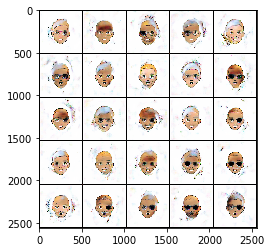

Epoch 15/50 Step 9210... Discriminator Loss: 0.3870... Generator Loss: 4.2922
Epoch 15/50 Step 9220... Discriminator Loss: 0.3955... Generator Loss: 3.3667
Epoch 15/50 Step 9230... Discriminator Loss: 0.3892... Generator Loss: 3.6897
Epoch 15/50 Step 9240... Discriminator Loss: 0.3664... Generator Loss: 3.8080
Epoch 15/50 Step 9250... Discriminator Loss: 0.3737... Generator Loss: 3.7029
Epoch 15/50 Step 9260... Discriminator Loss: 0.3722... Generator Loss: 4.1732
Epoch 15/50 Step 9270... Discriminator Loss: 0.3928... Generator Loss: 3.0396
Epoch 15/50 Step 9280... Discriminator Loss: 0.3835... Generator Loss: 3.4147
Epoch 15/50 Step 9290... Discriminator Loss: 0.3554... Generator Loss: 4.3349
Epoch 15/50 Step 9300... Discriminator Loss: 0.3752... Generator Loss: 4.2952


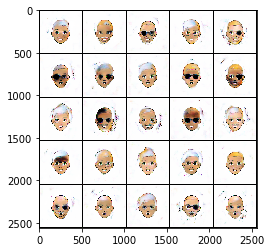

Epoch 15/50 Step 9310... Discriminator Loss: 0.4049... Generator Loss: 3.1145
Epoch 15/50 Step 9320... Discriminator Loss: 0.3819... Generator Loss: 4.0488
Epoch 15/50 Step 9330... Discriminator Loss: 0.4181... Generator Loss: 3.1861
Epoch 15/50 Step 9340... Discriminator Loss: 0.3648... Generator Loss: 4.4048
Epoch 15/50 Step 9350... Discriminator Loss: 0.3518... Generator Loss: 4.0965
Epoch 15/50 Step 9360... Discriminator Loss: 0.4502... Generator Loss: 2.6897
Epoch 15/50 Step 9370... Discriminator Loss: 0.3737... Generator Loss: 3.9459
Epoch 16/50 Step 9380... Discriminator Loss: 0.3778... Generator Loss: 3.9278
Epoch 16/50 Step 9390... Discriminator Loss: 0.3688... Generator Loss: 4.3722
Epoch 16/50 Step 9400... Discriminator Loss: 0.4036... Generator Loss: 4.7071


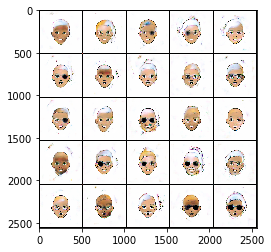

Epoch 16/50 Step 9410... Discriminator Loss: 0.3499... Generator Loss: 4.3775
Epoch 16/50 Step 9420... Discriminator Loss: 0.3620... Generator Loss: 4.3725
Epoch 16/50 Step 9430... Discriminator Loss: 0.3563... Generator Loss: 4.6100
Epoch 16/50 Step 9440... Discriminator Loss: 0.3860... Generator Loss: 3.6047
Epoch 16/50 Step 9450... Discriminator Loss: 0.3673... Generator Loss: 4.5552
Epoch 16/50 Step 9460... Discriminator Loss: 0.3536... Generator Loss: 4.1135
Epoch 16/50 Step 9470... Discriminator Loss: 0.4433... Generator Loss: 5.3735
Epoch 16/50 Step 9480... Discriminator Loss: 0.3659... Generator Loss: 3.9919
Epoch 16/50 Step 9490... Discriminator Loss: 0.5925... Generator Loss: 5.6192
Epoch 16/50 Step 9500... Discriminator Loss: 0.3628... Generator Loss: 4.2681


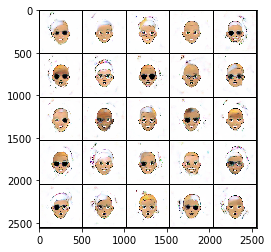

Epoch 16/50 Step 9510... Discriminator Loss: 0.3587... Generator Loss: 4.4965
Epoch 16/50 Step 9520... Discriminator Loss: 0.3768... Generator Loss: 4.3221
Epoch 16/50 Step 9530... Discriminator Loss: 0.3737... Generator Loss: 4.7173
Epoch 16/50 Step 9540... Discriminator Loss: 0.3636... Generator Loss: 4.0037
Epoch 16/50 Step 9550... Discriminator Loss: 0.3578... Generator Loss: 4.3176
Epoch 16/50 Step 9560... Discriminator Loss: 2.0892... Generator Loss: 0.3731
Epoch 16/50 Step 9570... Discriminator Loss: 0.6073... Generator Loss: 3.5982
Epoch 16/50 Step 9580... Discriminator Loss: 0.4158... Generator Loss: 3.8619
Epoch 16/50 Step 9590... Discriminator Loss: 0.4323... Generator Loss: 4.1640
Epoch 16/50 Step 9600... Discriminator Loss: 0.4061... Generator Loss: 3.5187


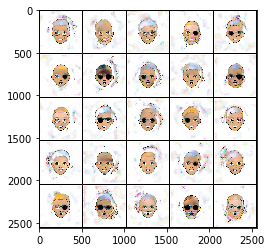

Epoch 16/50 Step 9610... Discriminator Loss: 0.3648... Generator Loss: 3.9342
Epoch 16/50 Step 9620... Discriminator Loss: 0.3986... Generator Loss: 3.7200
Epoch 16/50 Step 9630... Discriminator Loss: 0.3739... Generator Loss: 3.4390
Epoch 16/50 Step 9640... Discriminator Loss: 0.3987... Generator Loss: 3.2156
Epoch 16/50 Step 9650... Discriminator Loss: 0.3696... Generator Loss: 3.5707
Epoch 16/50 Step 9660... Discriminator Loss: 0.3492... Generator Loss: 4.2520
Epoch 16/50 Step 9670... Discriminator Loss: 0.4385... Generator Loss: 3.5172
Epoch 16/50 Step 9680... Discriminator Loss: 0.3631... Generator Loss: 4.1389
Epoch 16/50 Step 9690... Discriminator Loss: 0.3721... Generator Loss: 4.3254
Epoch 16/50 Step 9700... Discriminator Loss: 0.3842... Generator Loss: 3.4369


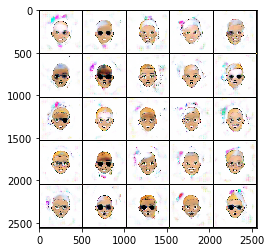

Epoch 16/50 Step 9710... Discriminator Loss: 0.3651... Generator Loss: 4.4216
Epoch 16/50 Step 9720... Discriminator Loss: 0.3918... Generator Loss: 3.5168
Epoch 16/50 Step 9730... Discriminator Loss: 0.3690... Generator Loss: 3.7284
Epoch 16/50 Step 9740... Discriminator Loss: 0.4074... Generator Loss: 3.5129
Epoch 16/50 Step 9750... Discriminator Loss: 0.3723... Generator Loss: 3.8722
Epoch 16/50 Step 9760... Discriminator Loss: 0.3630... Generator Loss: 5.0054
Epoch 16/50 Step 9770... Discriminator Loss: 0.3674... Generator Loss: 4.0679
Epoch 16/50 Step 9780... Discriminator Loss: 0.3555... Generator Loss: 4.7939
Epoch 16/50 Step 9790... Discriminator Loss: 0.3979... Generator Loss: 3.4661
Epoch 16/50 Step 9800... Discriminator Loss: 0.4890... Generator Loss: 5.3082


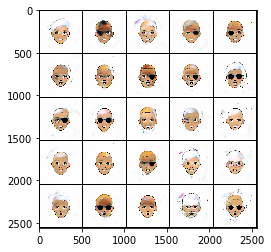

Epoch 16/50 Step 9810... Discriminator Loss: 0.6107... Generator Loss: 2.9280
Epoch 16/50 Step 9820... Discriminator Loss: 0.4332... Generator Loss: 3.8500
Epoch 16/50 Step 9830... Discriminator Loss: 0.5730... Generator Loss: 1.9330
Epoch 16/50 Step 9840... Discriminator Loss: 0.3861... Generator Loss: 3.2654
Epoch 16/50 Step 9850... Discriminator Loss: 0.5173... Generator Loss: 2.0327
Epoch 16/50 Step 9860... Discriminator Loss: 0.4129... Generator Loss: 3.6264
Epoch 16/50 Step 9870... Discriminator Loss: 0.3768... Generator Loss: 3.6875
Epoch 16/50 Step 9880... Discriminator Loss: 0.4063... Generator Loss: 3.2866
Epoch 16/50 Step 9890... Discriminator Loss: 0.3626... Generator Loss: 4.1432
Epoch 16/50 Step 9900... Discriminator Loss: 0.3956... Generator Loss: 3.3399


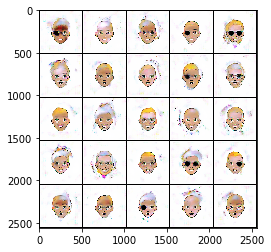

Epoch 16/50 Step 9910... Discriminator Loss: 0.4163... Generator Loss: 3.1071
Epoch 16/50 Step 9920... Discriminator Loss: 0.3735... Generator Loss: 3.7537
Epoch 16/50 Step 9930... Discriminator Loss: 0.3839... Generator Loss: 3.6728
Epoch 16/50 Step 9940... Discriminator Loss: 0.3723... Generator Loss: 3.6666
Epoch 16/50 Step 9950... Discriminator Loss: 0.3755... Generator Loss: 4.3958
Epoch 16/50 Step 9960... Discriminator Loss: 0.3549... Generator Loss: 3.9454
Epoch 16/50 Step 9970... Discriminator Loss: 0.3803... Generator Loss: 3.7943
Epoch 16/50 Step 9980... Discriminator Loss: 0.3921... Generator Loss: 3.5195
Epoch 16/50 Step 9990... Discriminator Loss: 0.3579... Generator Loss: 4.3631
Epoch 16/50 Step 10000... Discriminator Loss: 0.3804... Generator Loss: 3.9858


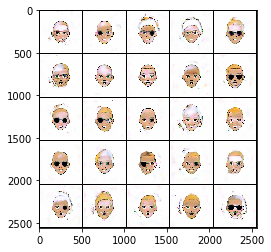

Epoch 17/50 Step 10010... Discriminator Loss: 0.3843... Generator Loss: 4.5113
Epoch 17/50 Step 10020... Discriminator Loss: 0.3938... Generator Loss: 3.1983
Epoch 17/50 Step 10030... Discriminator Loss: 0.3577... Generator Loss: 4.3843
Epoch 17/50 Step 10040... Discriminator Loss: 0.3778... Generator Loss: 4.0901
Epoch 17/50 Step 10050... Discriminator Loss: 0.3613... Generator Loss: 3.7509
Epoch 17/50 Step 10060... Discriminator Loss: 0.3810... Generator Loss: 3.7011
Epoch 17/50 Step 10070... Discriminator Loss: 0.3803... Generator Loss: 4.4630
Epoch 17/50 Step 10080... Discriminator Loss: 0.3753... Generator Loss: 3.9355
Epoch 17/50 Step 10090... Discriminator Loss: 0.3675... Generator Loss: 4.8141
Epoch 17/50 Step 10100... Discriminator Loss: 0.3588... Generator Loss: 4.4097


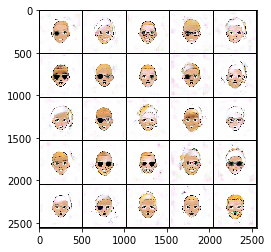

Epoch 17/50 Step 10110... Discriminator Loss: 0.3540... Generator Loss: 4.3528
Epoch 17/50 Step 10120... Discriminator Loss: 0.3563... Generator Loss: 4.3973
Epoch 17/50 Step 10130... Discriminator Loss: 0.4159... Generator Loss: 4.5258
Epoch 17/50 Step 10140... Discriminator Loss: 0.3603... Generator Loss: 4.4847
Epoch 17/50 Step 10150... Discriminator Loss: 0.7180... Generator Loss: 1.7431
Epoch 17/50 Step 10160... Discriminator Loss: 0.6062... Generator Loss: 2.5702
Epoch 17/50 Step 10170... Discriminator Loss: 0.3897... Generator Loss: 3.7524
Epoch 17/50 Step 10180... Discriminator Loss: 0.4101... Generator Loss: 3.6183
Epoch 17/50 Step 10190... Discriminator Loss: 0.3752... Generator Loss: 3.9476
Epoch 17/50 Step 10200... Discriminator Loss: 0.3726... Generator Loss: 4.2974


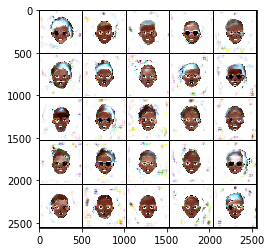

Epoch 17/50 Step 10210... Discriminator Loss: 0.3489... Generator Loss: 4.4984
Epoch 17/50 Step 10220... Discriminator Loss: 0.3534... Generator Loss: 4.7497
Epoch 17/50 Step 10230... Discriminator Loss: 0.3948... Generator Loss: 4.4232
Epoch 17/50 Step 10240... Discriminator Loss: 0.4114... Generator Loss: 3.1160
Epoch 17/50 Step 10250... Discriminator Loss: 0.3718... Generator Loss: 3.7729
Epoch 17/50 Step 10260... Discriminator Loss: 0.3440... Generator Loss: 4.1573
Epoch 17/50 Step 10270... Discriminator Loss: 0.3659... Generator Loss: 4.0589
Epoch 17/50 Step 10280... Discriminator Loss: 0.3601... Generator Loss: 4.1066
Epoch 17/50 Step 10290... Discriminator Loss: 0.3639... Generator Loss: 3.6555
Epoch 17/50 Step 10300... Discriminator Loss: 0.3519... Generator Loss: 4.1836


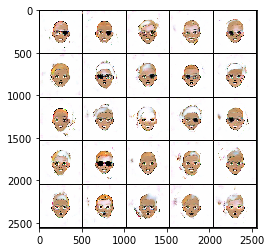

Epoch 17/50 Step 10310... Discriminator Loss: 0.3748... Generator Loss: 4.0433
Epoch 17/50 Step 10320... Discriminator Loss: 0.3546... Generator Loss: 4.2040
Epoch 17/50 Step 10330... Discriminator Loss: 0.3585... Generator Loss: 4.6402
Epoch 17/50 Step 10340... Discriminator Loss: 0.3519... Generator Loss: 4.5340
Epoch 17/50 Step 10350... Discriminator Loss: 0.3542... Generator Loss: 4.5002
Epoch 17/50 Step 10360... Discriminator Loss: 0.3699... Generator Loss: 3.9739
Epoch 17/50 Step 10370... Discriminator Loss: 0.3459... Generator Loss: 4.7091
Epoch 17/50 Step 10380... Discriminator Loss: 0.3552... Generator Loss: 4.1643
Epoch 17/50 Step 10390... Discriminator Loss: 0.3624... Generator Loss: 4.9907
Epoch 17/50 Step 10400... Discriminator Loss: 0.3479... Generator Loss: 4.5117


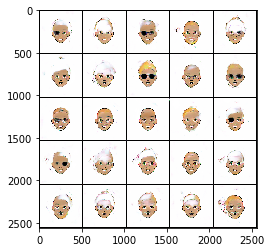

Epoch 17/50 Step 10410... Discriminator Loss: 0.3506... Generator Loss: 4.5295
Epoch 17/50 Step 10420... Discriminator Loss: 0.3457... Generator Loss: 4.8152
Epoch 17/50 Step 10430... Discriminator Loss: 0.4334... Generator Loss: 2.8980
Epoch 17/50 Step 10440... Discriminator Loss: 0.3690... Generator Loss: 4.1876
Epoch 17/50 Step 10450... Discriminator Loss: 0.3549... Generator Loss: 4.5827
Epoch 17/50 Step 10460... Discriminator Loss: 0.3486... Generator Loss: 4.8590
Epoch 17/50 Step 10470... Discriminator Loss: 0.3519... Generator Loss: 4.7319
Epoch 17/50 Step 10480... Discriminator Loss: 0.3757... Generator Loss: 4.8074
Epoch 17/50 Step 10490... Discriminator Loss: 0.3441... Generator Loss: 5.1545
Epoch 17/50 Step 10500... Discriminator Loss: 0.3483... Generator Loss: 4.7498


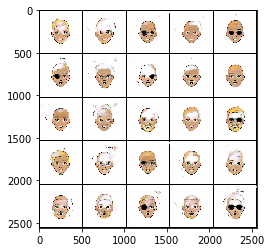

Epoch 17/50 Step 10510... Discriminator Loss: 0.3489... Generator Loss: 5.4518
Epoch 17/50 Step 10520... Discriminator Loss: 0.3590... Generator Loss: 4.0735
Epoch 17/50 Step 10530... Discriminator Loss: 0.3571... Generator Loss: 4.2705
Epoch 17/50 Step 10540... Discriminator Loss: 0.3436... Generator Loss: 5.0083
Epoch 17/50 Step 10550... Discriminator Loss: 0.3644... Generator Loss: 5.2929
Epoch 17/50 Step 10560... Discriminator Loss: 0.3794... Generator Loss: 3.5597
Epoch 17/50 Step 10570... Discriminator Loss: 0.3780... Generator Loss: 4.8100
Epoch 17/50 Step 10580... Discriminator Loss: 0.3591... Generator Loss: 4.0759
Epoch 17/50 Step 10590... Discriminator Loss: 0.3450... Generator Loss: 4.9966
Epoch 17/50 Step 10600... Discriminator Loss: 0.3419... Generator Loss: 4.6921


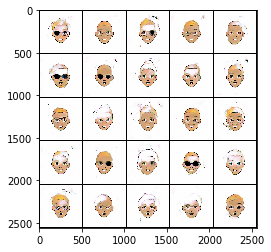

Epoch 17/50 Step 10610... Discriminator Loss: 0.3694... Generator Loss: 4.0923
Epoch 17/50 Step 10620... Discriminator Loss: 0.3502... Generator Loss: 4.1471
Epoch 18/50 Step 10630... Discriminator Loss: 0.3423... Generator Loss: 4.5566
Epoch 18/50 Step 10640... Discriminator Loss: 0.3462... Generator Loss: 4.9299
Epoch 18/50 Step 10650... Discriminator Loss: 0.9431... Generator Loss: 4.3843
Epoch 18/50 Step 10660... Discriminator Loss: 0.4155... Generator Loss: 4.5666
Epoch 18/50 Step 10670... Discriminator Loss: 0.5229... Generator Loss: 2.5805
Epoch 18/50 Step 10680... Discriminator Loss: 0.3889... Generator Loss: 3.6971
Epoch 18/50 Step 10690... Discriminator Loss: 0.4472... Generator Loss: 2.7577
Epoch 18/50 Step 10700... Discriminator Loss: 0.4086... Generator Loss: 3.2840


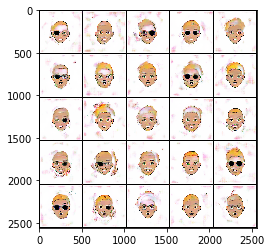

Epoch 18/50 Step 10710... Discriminator Loss: 0.4324... Generator Loss: 3.5702
Epoch 18/50 Step 10720... Discriminator Loss: 0.4393... Generator Loss: 3.8581
Epoch 18/50 Step 10730... Discriminator Loss: 0.4328... Generator Loss: 2.8848
Epoch 18/50 Step 10740... Discriminator Loss: 0.3917... Generator Loss: 3.7339
Epoch 18/50 Step 10750... Discriminator Loss: 0.3848... Generator Loss: 3.3807
Epoch 18/50 Step 10760... Discriminator Loss: 0.3725... Generator Loss: 4.5392
Epoch 18/50 Step 10770... Discriminator Loss: 0.3942... Generator Loss: 3.1760
Epoch 18/50 Step 10780... Discriminator Loss: 0.3703... Generator Loss: 4.4769
Epoch 18/50 Step 10790... Discriminator Loss: 0.3999... Generator Loss: 3.3768
Epoch 18/50 Step 10800... Discriminator Loss: 0.3684... Generator Loss: 3.8347


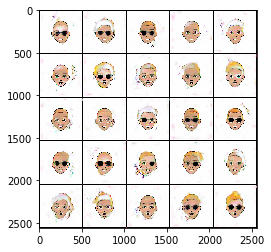

Epoch 18/50 Step 10810... Discriminator Loss: 0.3808... Generator Loss: 3.5831
Epoch 18/50 Step 10820... Discriminator Loss: 0.3703... Generator Loss: 3.9820
Epoch 18/50 Step 10830... Discriminator Loss: 0.3666... Generator Loss: 4.6906
Epoch 18/50 Step 10840... Discriminator Loss: 0.3981... Generator Loss: 4.4928
Epoch 18/50 Step 10850... Discriminator Loss: 0.3788... Generator Loss: 3.7560
Epoch 18/50 Step 10860... Discriminator Loss: 0.3667... Generator Loss: 3.9647
Epoch 18/50 Step 10870... Discriminator Loss: 0.3820... Generator Loss: 3.9489
Epoch 18/50 Step 10880... Discriminator Loss: 0.3525... Generator Loss: 4.3172
Epoch 18/50 Step 10890... Discriminator Loss: 0.3740... Generator Loss: 3.8089
Epoch 18/50 Step 10900... Discriminator Loss: 0.3449... Generator Loss: 4.7534


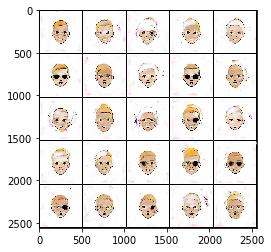

Epoch 18/50 Step 10910... Discriminator Loss: 0.3468... Generator Loss: 4.2310
Epoch 18/50 Step 10920... Discriminator Loss: 0.3630... Generator Loss: 5.3227
Epoch 18/50 Step 10930... Discriminator Loss: 0.3520... Generator Loss: 4.4928
Epoch 18/50 Step 10940... Discriminator Loss: 0.3462... Generator Loss: 4.6855
Epoch 18/50 Step 10950... Discriminator Loss: 0.3736... Generator Loss: 4.0557
Epoch 18/50 Step 10960... Discriminator Loss: 0.4254... Generator Loss: 3.1900
Epoch 18/50 Step 10970... Discriminator Loss: 0.3604... Generator Loss: 3.6952
Epoch 18/50 Step 10980... Discriminator Loss: 0.3518... Generator Loss: 4.3333
Epoch 18/50 Step 10990... Discriminator Loss: 0.3689... Generator Loss: 3.9485
Epoch 18/50 Step 11000... Discriminator Loss: 0.3591... Generator Loss: 4.1927


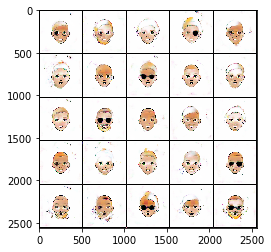

Epoch 18/50 Step 11010... Discriminator Loss: 0.3521... Generator Loss: 4.7296
Epoch 18/50 Step 11020... Discriminator Loss: 0.3633... Generator Loss: 4.1756
Epoch 18/50 Step 11030... Discriminator Loss: 0.3474... Generator Loss: 4.6560
Epoch 18/50 Step 11040... Discriminator Loss: 0.4002... Generator Loss: 3.1946
Epoch 18/50 Step 11050... Discriminator Loss: 0.3656... Generator Loss: 5.1549
Epoch 18/50 Step 11060... Discriminator Loss: 0.3489... Generator Loss: 4.5414
Epoch 18/50 Step 11070... Discriminator Loss: 0.3529... Generator Loss: 4.4661
Epoch 18/50 Step 11080... Discriminator Loss: 0.3584... Generator Loss: 4.0974
Epoch 18/50 Step 11090... Discriminator Loss: 1.2960... Generator Loss: 1.7178
Epoch 18/50 Step 11100... Discriminator Loss: 0.4811... Generator Loss: 3.4191


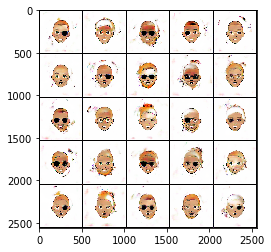

Epoch 18/50 Step 11110... Discriminator Loss: 0.4114... Generator Loss: 3.4830
Epoch 18/50 Step 11120... Discriminator Loss: 0.4179... Generator Loss: 2.9861
Epoch 18/50 Step 11130... Discriminator Loss: 0.4559... Generator Loss: 2.4396
Epoch 18/50 Step 11140... Discriminator Loss: 0.3497... Generator Loss: 4.3896
Epoch 18/50 Step 11150... Discriminator Loss: 0.3746... Generator Loss: 3.7967
Epoch 18/50 Step 11160... Discriminator Loss: 0.3799... Generator Loss: 3.6712
Epoch 18/50 Step 11170... Discriminator Loss: 0.3719... Generator Loss: 3.5644
Epoch 18/50 Step 11180... Discriminator Loss: 0.3527... Generator Loss: 4.1770
Epoch 18/50 Step 11190... Discriminator Loss: 0.3583... Generator Loss: 4.5567
Epoch 18/50 Step 11200... Discriminator Loss: 0.3486... Generator Loss: 4.7106


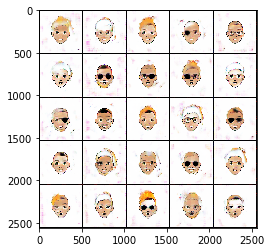

Epoch 18/50 Step 11210... Discriminator Loss: 0.3543... Generator Loss: 4.1789
Epoch 18/50 Step 11220... Discriminator Loss: 0.3519... Generator Loss: 3.9016
Epoch 18/50 Step 11230... Discriminator Loss: 0.3547... Generator Loss: 4.6017
Epoch 18/50 Step 11240... Discriminator Loss: 0.3470... Generator Loss: 4.7704
Epoch 18/50 Step 11250... Discriminator Loss: 0.3694... Generator Loss: 3.9314
Epoch 19/50 Step 11260... Discriminator Loss: 0.3623... Generator Loss: 5.2781
Epoch 19/50 Step 11270... Discriminator Loss: 1.7088... Generator Loss: 8.8304
Epoch 19/50 Step 11280... Discriminator Loss: 0.3808... Generator Loss: 4.6335
Epoch 19/50 Step 11290... Discriminator Loss: 0.3672... Generator Loss: 3.9640
Epoch 19/50 Step 11300... Discriminator Loss: 0.3501... Generator Loss: 4.2979


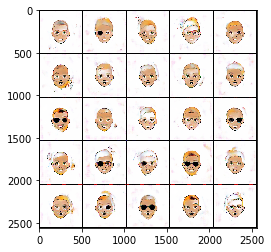

Epoch 19/50 Step 11310... Discriminator Loss: 0.3453... Generator Loss: 4.8910
Epoch 19/50 Step 11320... Discriminator Loss: 0.3598... Generator Loss: 4.3949
Epoch 19/50 Step 11330... Discriminator Loss: 0.3672... Generator Loss: 4.0430
Epoch 19/50 Step 11340... Discriminator Loss: 0.3530... Generator Loss: 4.5651
Epoch 19/50 Step 11350... Discriminator Loss: 0.3566... Generator Loss: 4.3696
Epoch 19/50 Step 11360... Discriminator Loss: 0.3438... Generator Loss: 4.9065
Epoch 19/50 Step 11370... Discriminator Loss: 0.3379... Generator Loss: 4.9496
Epoch 19/50 Step 11380... Discriminator Loss: 0.3508... Generator Loss: 4.3922
Epoch 19/50 Step 11390... Discriminator Loss: 0.3435... Generator Loss: 4.7070
Epoch 19/50 Step 11400... Discriminator Loss: 0.3545... Generator Loss: 4.3043


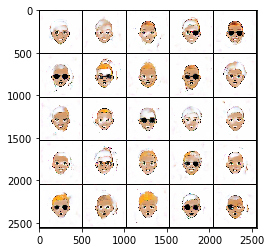

Epoch 19/50 Step 11410... Discriminator Loss: 0.3474... Generator Loss: 4.7493
Epoch 19/50 Step 11420... Discriminator Loss: 0.3436... Generator Loss: 5.1977
Epoch 19/50 Step 11430... Discriminator Loss: 0.3713... Generator Loss: 3.9559
Epoch 19/50 Step 11440... Discriminator Loss: 0.3496... Generator Loss: 5.1374
Epoch 19/50 Step 11450... Discriminator Loss: 0.4455... Generator Loss: 3.1080
Epoch 19/50 Step 11460... Discriminator Loss: 0.3370... Generator Loss: 4.9800
Epoch 19/50 Step 11470... Discriminator Loss: 0.3366... Generator Loss: 5.0389
Epoch 19/50 Step 11480... Discriminator Loss: 0.3470... Generator Loss: 4.3339
Epoch 19/50 Step 11490... Discriminator Loss: 0.3418... Generator Loss: 4.9931
Epoch 19/50 Step 11500... Discriminator Loss: 0.3379... Generator Loss: 4.7726


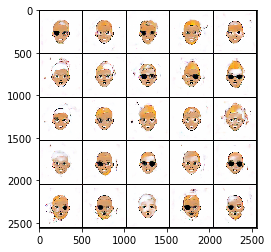

Epoch 19/50 Step 11510... Discriminator Loss: 0.3406... Generator Loss: 5.5972
Epoch 19/50 Step 11520... Discriminator Loss: 0.3472... Generator Loss: 4.7552
Epoch 19/50 Step 11530... Discriminator Loss: 0.3434... Generator Loss: 4.8089
Epoch 19/50 Step 11540... Discriminator Loss: 0.3494... Generator Loss: 4.5383
Epoch 19/50 Step 11550... Discriminator Loss: 0.3414... Generator Loss: 5.4361
Epoch 19/50 Step 11560... Discriminator Loss: 0.3720... Generator Loss: 3.8816
Epoch 19/50 Step 11570... Discriminator Loss: 0.3720... Generator Loss: 5.6251
Epoch 19/50 Step 11580... Discriminator Loss: 0.3615... Generator Loss: 4.3270
Epoch 19/50 Step 11590... Discriminator Loss: 0.3602... Generator Loss: 5.7850
Epoch 19/50 Step 11600... Discriminator Loss: 0.3535... Generator Loss: 5.5824


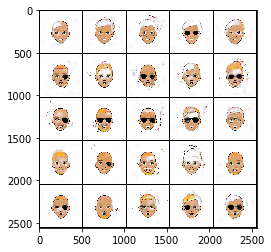

Epoch 19/50 Step 11610... Discriminator Loss: 0.3688... Generator Loss: 4.0827
Epoch 19/50 Step 11620... Discriminator Loss: 0.3367... Generator Loss: 5.0578
Epoch 19/50 Step 11630... Discriminator Loss: 0.3417... Generator Loss: 5.4360
Epoch 19/50 Step 11640... Discriminator Loss: 0.4223... Generator Loss: 3.5342
Epoch 19/50 Step 11650... Discriminator Loss: 0.3383... Generator Loss: 5.1619
Epoch 19/50 Step 11660... Discriminator Loss: 0.3428... Generator Loss: 5.7221
Epoch 19/50 Step 11670... Discriminator Loss: 0.3394... Generator Loss: 5.4798
Epoch 19/50 Step 11680... Discriminator Loss: 0.3477... Generator Loss: 4.8618
Epoch 19/50 Step 11690... Discriminator Loss: 0.3458... Generator Loss: 5.1148
Epoch 19/50 Step 11700... Discriminator Loss: 0.3466... Generator Loss: 5.7463


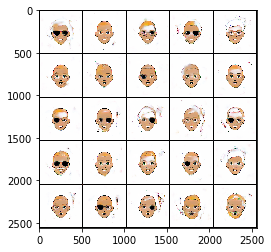

Epoch 19/50 Step 11710... Discriminator Loss: 0.3396... Generator Loss: 5.6055
Epoch 19/50 Step 11720... Discriminator Loss: 0.3635... Generator Loss: 4.4697
Epoch 19/50 Step 11730... Discriminator Loss: 0.4710... Generator Loss: 3.4286
Epoch 19/50 Step 11740... Discriminator Loss: 0.3477... Generator Loss: 4.8405
Epoch 19/50 Step 11750... Discriminator Loss: 0.3435... Generator Loss: 4.9590
Epoch 19/50 Step 11760... Discriminator Loss: 0.3346... Generator Loss: 5.6362
Epoch 19/50 Step 11770... Discriminator Loss: 0.3581... Generator Loss: 4.1761
Epoch 19/50 Step 11780... Discriminator Loss: 0.3542... Generator Loss: 4.4872
Epoch 19/50 Step 11790... Discriminator Loss: 0.3366... Generator Loss: 5.5924
Epoch 19/50 Step 11800... Discriminator Loss: 0.3459... Generator Loss: 5.8680


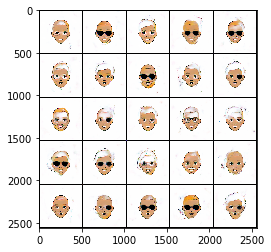

Epoch 19/50 Step 11810... Discriminator Loss: 0.3410... Generator Loss: 4.7354
Epoch 19/50 Step 11820... Discriminator Loss: 0.3427... Generator Loss: 5.6043
Epoch 19/50 Step 11830... Discriminator Loss: 0.3440... Generator Loss: 4.9627
Epoch 19/50 Step 11840... Discriminator Loss: 0.3360... Generator Loss: 5.4673
Epoch 19/50 Step 11850... Discriminator Loss: 0.3382... Generator Loss: 5.3935
Epoch 19/50 Step 11860... Discriminator Loss: 0.3880... Generator Loss: 4.1173
Epoch 19/50 Step 11870... Discriminator Loss: 0.3443... Generator Loss: 5.0176
Epoch 20/50 Step 11880... Discriminator Loss: 0.3459... Generator Loss: 4.6962
Epoch 20/50 Step 11890... Discriminator Loss: 0.3356... Generator Loss: 5.6588
Epoch 20/50 Step 11900... Discriminator Loss: 0.3621... Generator Loss: 5.6766


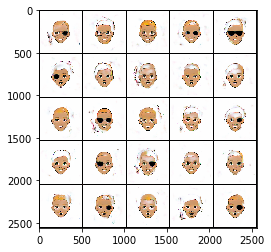

Epoch 20/50 Step 11910... Discriminator Loss: 0.3324... Generator Loss: 5.6621
Epoch 20/50 Step 11920... Discriminator Loss: 0.3430... Generator Loss: 5.4114
Epoch 20/50 Step 11930... Discriminator Loss: 0.3365... Generator Loss: 5.2162
Epoch 20/50 Step 11940... Discriminator Loss: 0.3932... Generator Loss: 3.7427
Epoch 20/50 Step 11950... Discriminator Loss: 0.3386... Generator Loss: 5.5485
Epoch 20/50 Step 11960... Discriminator Loss: 0.3523... Generator Loss: 4.2873
Epoch 20/50 Step 11970... Discriminator Loss: 0.3509... Generator Loss: 5.6928
Epoch 20/50 Step 11980... Discriminator Loss: 0.3342... Generator Loss: 5.6957
Epoch 20/50 Step 11990... Discriminator Loss: 0.3519... Generator Loss: 5.5526
Epoch 20/50 Step 12000... Discriminator Loss: 0.3406... Generator Loss: 5.0175


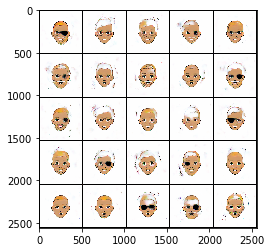

Epoch 20/50 Step 12010... Discriminator Loss: 0.3384... Generator Loss: 5.2884
Epoch 20/50 Step 12020... Discriminator Loss: 0.3496... Generator Loss: 5.2155
Epoch 20/50 Step 12030... Discriminator Loss: 0.3968... Generator Loss: 4.1661
Epoch 20/50 Step 12040... Discriminator Loss: 0.3569... Generator Loss: 4.5981
Epoch 20/50 Step 12050... Discriminator Loss: 0.3557... Generator Loss: 4.4963
Epoch 20/50 Step 12060... Discriminator Loss: 0.4819... Generator Loss: 3.1722
Epoch 20/50 Step 12070... Discriminator Loss: 0.3532... Generator Loss: 5.4424
Epoch 20/50 Step 12080... Discriminator Loss: 0.3709... Generator Loss: 6.0083
Epoch 20/50 Step 12090... Discriminator Loss: 0.3605... Generator Loss: 5.5292
Epoch 20/50 Step 12100... Discriminator Loss: 0.3431... Generator Loss: 5.6406


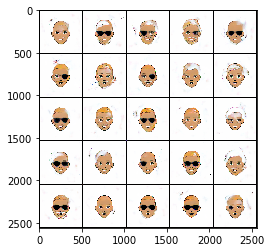

Epoch 20/50 Step 12110... Discriminator Loss: 0.3341... Generator Loss: 5.3754
Epoch 20/50 Step 12120... Discriminator Loss: 0.3437... Generator Loss: 4.8194
Epoch 20/50 Step 12130... Discriminator Loss: 0.3755... Generator Loss: 4.3138
Epoch 20/50 Step 12140... Discriminator Loss: 0.3471... Generator Loss: 5.5128
Epoch 20/50 Step 12150... Discriminator Loss: 0.3329... Generator Loss: 5.4401
Epoch 20/50 Step 12160... Discriminator Loss: 0.3359... Generator Loss: 5.5536
Epoch 20/50 Step 12170... Discriminator Loss: 0.3361... Generator Loss: 5.4266
Epoch 20/50 Step 12180... Discriminator Loss: 0.3708... Generator Loss: 6.2632
Epoch 20/50 Step 12190... Discriminator Loss: 0.3429... Generator Loss: 5.6361
Epoch 20/50 Step 12200... Discriminator Loss: 0.6297... Generator Loss: 4.6769


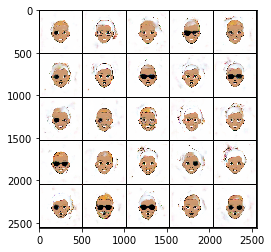

Epoch 20/50 Step 12210... Discriminator Loss: 0.4031... Generator Loss: 3.7544
Epoch 20/50 Step 12220... Discriminator Loss: 0.3956... Generator Loss: 3.4850
Epoch 20/50 Step 12230... Discriminator Loss: 0.3600... Generator Loss: 4.5164
Epoch 20/50 Step 12240... Discriminator Loss: 0.3818... Generator Loss: 4.0272
Epoch 20/50 Step 12250... Discriminator Loss: 0.3956... Generator Loss: 3.4466
Epoch 20/50 Step 12260... Discriminator Loss: 0.3669... Generator Loss: 3.9982
Epoch 20/50 Step 12270... Discriminator Loss: 0.4499... Generator Loss: 2.7655
Epoch 20/50 Step 12280... Discriminator Loss: 0.3574... Generator Loss: 4.2546
Epoch 20/50 Step 12290... Discriminator Loss: 0.3831... Generator Loss: 3.6467
Epoch 20/50 Step 12300... Discriminator Loss: 0.3573... Generator Loss: 5.4721


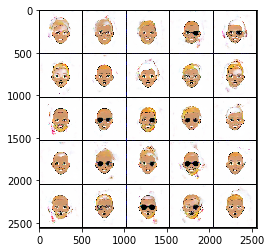

Epoch 20/50 Step 12310... Discriminator Loss: 0.3436... Generator Loss: 4.9604
Epoch 20/50 Step 12320... Discriminator Loss: 0.3470... Generator Loss: 4.7687
Epoch 20/50 Step 12330... Discriminator Loss: 0.5655... Generator Loss: 2.5864
Epoch 20/50 Step 12340... Discriminator Loss: 0.3604... Generator Loss: 4.2460
Epoch 20/50 Step 12350... Discriminator Loss: 0.3463... Generator Loss: 4.6035
Epoch 20/50 Step 12360... Discriminator Loss: 0.3409... Generator Loss: 5.2248
Epoch 20/50 Step 12370... Discriminator Loss: 0.3750... Generator Loss: 4.1777
Epoch 20/50 Step 12380... Discriminator Loss: 0.3495... Generator Loss: 4.4281
Epoch 20/50 Step 12390... Discriminator Loss: 0.3709... Generator Loss: 4.2586
Epoch 20/50 Step 12400... Discriminator Loss: 0.3461... Generator Loss: 4.6729


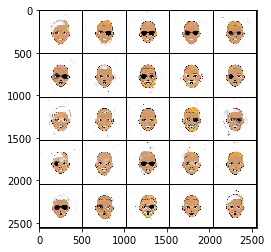

Epoch 20/50 Step 12410... Discriminator Loss: 0.3446... Generator Loss: 4.9119
Epoch 20/50 Step 12420... Discriminator Loss: 0.3408... Generator Loss: 5.7514
Epoch 20/50 Step 12430... Discriminator Loss: 0.3394... Generator Loss: 4.9288
Epoch 20/50 Step 12440... Discriminator Loss: 0.3374... Generator Loss: 5.0616
Epoch 20/50 Step 12450... Discriminator Loss: 2.3289... Generator Loss: 0.4428
Epoch 20/50 Step 12460... Discriminator Loss: 0.5132... Generator Loss: 2.6262
Epoch 20/50 Step 12470... Discriminator Loss: 0.3813... Generator Loss: 4.0922
Epoch 20/50 Step 12480... Discriminator Loss: 0.3734... Generator Loss: 3.8999
Epoch 20/50 Step 12490... Discriminator Loss: 0.3552... Generator Loss: 4.5696
Epoch 20/50 Step 12500... Discriminator Loss: 0.3804... Generator Loss: 3.8368


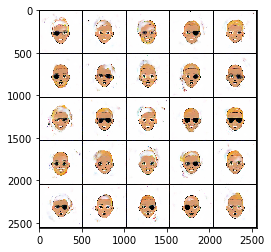

Epoch 21/50 Step 12510... Discriminator Loss: 0.3520... Generator Loss: 5.7204
Epoch 21/50 Step 12520... Discriminator Loss: 0.3705... Generator Loss: 4.4462
Epoch 21/50 Step 12530... Discriminator Loss: 0.3409... Generator Loss: 4.8404
Epoch 21/50 Step 12540... Discriminator Loss: 0.3437... Generator Loss: 5.3049
Epoch 21/50 Step 12550... Discriminator Loss: 0.3475... Generator Loss: 4.9299
Epoch 21/50 Step 12560... Discriminator Loss: 0.3386... Generator Loss: 4.9230
Epoch 21/50 Step 12570... Discriminator Loss: 0.3450... Generator Loss: 4.6179
Epoch 21/50 Step 12580... Discriminator Loss: 0.3445... Generator Loss: 5.3129
Epoch 21/50 Step 12590... Discriminator Loss: 0.3732... Generator Loss: 4.2961
Epoch 21/50 Step 12600... Discriminator Loss: 0.3383... Generator Loss: 5.3806


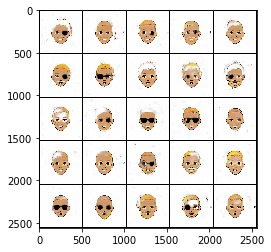

Epoch 21/50 Step 12610... Discriminator Loss: 0.3389... Generator Loss: 5.0923
Epoch 21/50 Step 12620... Discriminator Loss: 0.3447... Generator Loss: 5.2673
Epoch 21/50 Step 12630... Discriminator Loss: 0.3546... Generator Loss: 4.1738
Epoch 21/50 Step 12640... Discriminator Loss: 0.3412... Generator Loss: 4.8656
Epoch 21/50 Step 12650... Discriminator Loss: 0.3451... Generator Loss: 4.8977
Epoch 21/50 Step 12660... Discriminator Loss: 0.3453... Generator Loss: 4.7264
Epoch 21/50 Step 12670... Discriminator Loss: 0.3346... Generator Loss: 5.6651
Epoch 21/50 Step 12680... Discriminator Loss: 0.4155... Generator Loss: 3.6104
Epoch 21/50 Step 12690... Discriminator Loss: 0.3697... Generator Loss: 5.6873
Epoch 21/50 Step 12700... Discriminator Loss: 0.6089... Generator Loss: 2.5523


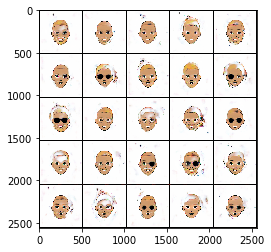

Epoch 21/50 Step 12710... Discriminator Loss: 0.3499... Generator Loss: 5.0395
Epoch 21/50 Step 12720... Discriminator Loss: 0.3481... Generator Loss: 4.7191
Epoch 21/50 Step 12730... Discriminator Loss: 0.3436... Generator Loss: 5.8402
Epoch 21/50 Step 12740... Discriminator Loss: 0.3550... Generator Loss: 4.5539
Epoch 21/50 Step 12750... Discriminator Loss: 0.3381... Generator Loss: 4.9007
Epoch 21/50 Step 12760... Discriminator Loss: 0.3363... Generator Loss: 5.8940
Epoch 21/50 Step 12770... Discriminator Loss: 0.3377... Generator Loss: 5.0375
Epoch 21/50 Step 12780... Discriminator Loss: 0.3391... Generator Loss: 5.1395
Epoch 21/50 Step 12790... Discriminator Loss: 0.3361... Generator Loss: 5.4880
Epoch 21/50 Step 12800... Discriminator Loss: 0.3373... Generator Loss: 5.0534


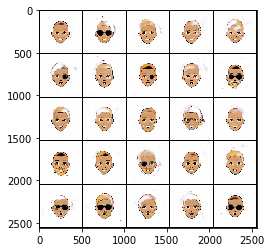

Epoch 21/50 Step 12810... Discriminator Loss: 0.3521... Generator Loss: 4.6039
Epoch 21/50 Step 12820... Discriminator Loss: 0.3717... Generator Loss: 5.8827
Epoch 21/50 Step 12830... Discriminator Loss: 0.3571... Generator Loss: 5.2680
Epoch 21/50 Step 12840... Discriminator Loss: 0.3496... Generator Loss: 6.1856
Epoch 21/50 Step 12850... Discriminator Loss: 0.3509... Generator Loss: 5.9243
Epoch 21/50 Step 12860... Discriminator Loss: 0.3528... Generator Loss: 4.5056
Epoch 21/50 Step 12870... Discriminator Loss: 0.3351... Generator Loss: 5.6310
Epoch 21/50 Step 12880... Discriminator Loss: 0.3340... Generator Loss: 5.6927
Epoch 21/50 Step 12890... Discriminator Loss: 0.3568... Generator Loss: 4.5981
Epoch 21/50 Step 12900... Discriminator Loss: 0.3409... Generator Loss: 5.2733


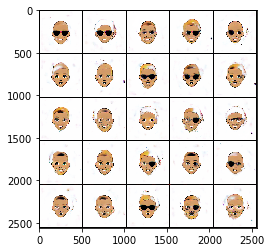

Epoch 21/50 Step 12910... Discriminator Loss: 0.3514... Generator Loss: 5.9032
Epoch 21/50 Step 12920... Discriminator Loss: 0.3370... Generator Loss: 5.7137
Epoch 21/50 Step 12930... Discriminator Loss: 0.3412... Generator Loss: 4.9737
Epoch 21/50 Step 12940... Discriminator Loss: 0.3380... Generator Loss: 5.4506
Epoch 21/50 Step 12950... Discriminator Loss: 0.3427... Generator Loss: 6.2565
Epoch 21/50 Step 12960... Discriminator Loss: 0.3377... Generator Loss: 5.8698
Epoch 21/50 Step 12970... Discriminator Loss: 0.3376... Generator Loss: 5.9226
Epoch 21/50 Step 12980... Discriminator Loss: 0.3344... Generator Loss: 5.8401
Epoch 21/50 Step 12990... Discriminator Loss: 0.3805... Generator Loss: 5.9949
Epoch 21/50 Step 13000... Discriminator Loss: 0.3495... Generator Loss: 4.8490


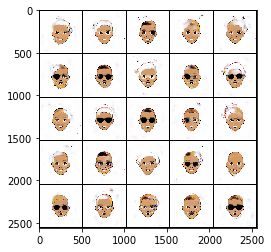

Epoch 21/50 Step 13010... Discriminator Loss: 0.3318... Generator Loss: 5.9090
Epoch 21/50 Step 13020... Discriminator Loss: 0.3558... Generator Loss: 4.7283
Epoch 21/50 Step 13030... Discriminator Loss: 0.3456... Generator Loss: 5.2086
Epoch 21/50 Step 13040... Discriminator Loss: 0.3520... Generator Loss: 6.6085
Epoch 21/50 Step 13050... Discriminator Loss: 0.3439... Generator Loss: 5.1705
Epoch 21/50 Step 13060... Discriminator Loss: 0.3586... Generator Loss: 4.2541
Epoch 21/50 Step 13070... Discriminator Loss: 0.3494... Generator Loss: 6.4043
Epoch 21/50 Step 13080... Discriminator Loss: 0.3475... Generator Loss: 5.4105
Epoch 21/50 Step 13090... Discriminator Loss: 0.3379... Generator Loss: 5.2355
Epoch 21/50 Step 13100... Discriminator Loss: 0.3414... Generator Loss: 5.9357


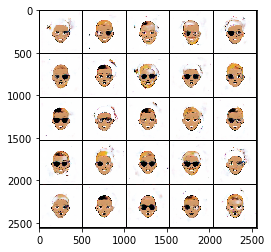

Epoch 21/50 Step 13110... Discriminator Loss: 0.3544... Generator Loss: 5.1682
Epoch 21/50 Step 13120... Discriminator Loss: 0.3336... Generator Loss: 5.7374
Epoch 22/50 Step 13130... Discriminator Loss: 0.3397... Generator Loss: 6.1392
Epoch 22/50 Step 13140... Discriminator Loss: 0.3464... Generator Loss: 6.1886
Epoch 22/50 Step 13150... Discriminator Loss: 0.3639... Generator Loss: 6.2722
Epoch 22/50 Step 13160... Discriminator Loss: 44.0143... Generator Loss: 20.6215
Epoch 22/50 Step 13170... Discriminator Loss: 9.2123... Generator Loss: 201.5759
Epoch 22/50 Step 13180... Discriminator Loss: 4.9034... Generator Loss: 39.3264
Epoch 22/50 Step 13190... Discriminator Loss: 23.5404... Generator Loss: 53.8225
Epoch 22/50 Step 13200... Discriminator Loss: 12.3390... Generator Loss: 37.7572


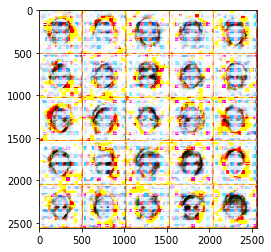

Epoch 22/50 Step 13210... Discriminator Loss: 11.1338... Generator Loss: 2.1193
Epoch 22/50 Step 13220... Discriminator Loss: 3.6374... Generator Loss: 22.7334
Epoch 22/50 Step 13230... Discriminator Loss: 6.5603... Generator Loss: 0.5443
Epoch 22/50 Step 13240... Discriminator Loss: 8.3404... Generator Loss: 0.0377
Epoch 22/50 Step 13250... Discriminator Loss: 1.9438... Generator Loss: 25.3937
Epoch 22/50 Step 13260... Discriminator Loss: 0.9395... Generator Loss: 9.7521
Epoch 22/50 Step 13270... Discriminator Loss: 1.0759... Generator Loss: 10.6945
Epoch 22/50 Step 13280... Discriminator Loss: 2.6954... Generator Loss: 6.4262
Epoch 22/50 Step 13290... Discriminator Loss: 0.5546... Generator Loss: 10.9492
Epoch 22/50 Step 13300... Discriminator Loss: 2.4091... Generator Loss: 11.3826


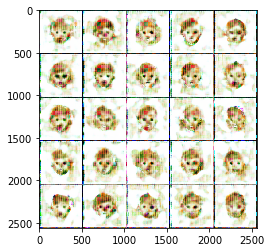

Epoch 22/50 Step 13310... Discriminator Loss: 11.9111... Generator Loss: 0.0061
Epoch 22/50 Step 13320... Discriminator Loss: 1.6026... Generator Loss: 1.2442
Epoch 22/50 Step 13330... Discriminator Loss: 7.0764... Generator Loss: 0.0143
Epoch 22/50 Step 13340... Discriminator Loss: 0.6541... Generator Loss: 5.5091
Epoch 22/50 Step 13350... Discriminator Loss: 0.5948... Generator Loss: 2.9364
Epoch 22/50 Step 13360... Discriminator Loss: 1.5800... Generator Loss: 5.7958
Epoch 22/50 Step 13370... Discriminator Loss: 0.8583... Generator Loss: 3.1628
Epoch 22/50 Step 13380... Discriminator Loss: 2.6463... Generator Loss: 0.3357
Epoch 22/50 Step 13390... Discriminator Loss: 3.7163... Generator Loss: 8.6712
Epoch 22/50 Step 13400... Discriminator Loss: 1.0689... Generator Loss: 5.1087


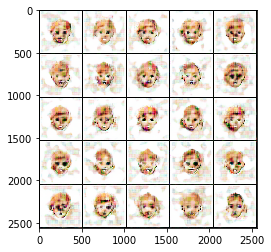

Epoch 22/50 Step 13410... Discriminator Loss: 2.3089... Generator Loss: 0.2826
Epoch 22/50 Step 13420... Discriminator Loss: 0.8270... Generator Loss: 3.5343
Epoch 22/50 Step 13430... Discriminator Loss: 0.7220... Generator Loss: 1.7955
Epoch 22/50 Step 13440... Discriminator Loss: 4.9905... Generator Loss: 9.6775
Epoch 22/50 Step 13450... Discriminator Loss: 1.6369... Generator Loss: 1.0771
Epoch 22/50 Step 13460... Discriminator Loss: 0.5632... Generator Loss: 2.8566
Epoch 22/50 Step 13470... Discriminator Loss: 0.6733... Generator Loss: 2.7687
Epoch 22/50 Step 13480... Discriminator Loss: 1.0352... Generator Loss: 1.7464
Epoch 22/50 Step 13490... Discriminator Loss: 1.5816... Generator Loss: 0.6691
Epoch 22/50 Step 13500... Discriminator Loss: 1.8031... Generator Loss: 5.0180


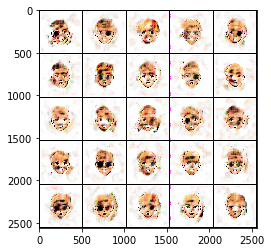

Epoch 22/50 Step 13510... Discriminator Loss: 2.2225... Generator Loss: 0.3167
Epoch 22/50 Step 13520... Discriminator Loss: 2.9386... Generator Loss: 0.1691
Epoch 22/50 Step 13530... Discriminator Loss: 0.6462... Generator Loss: 3.0134
Epoch 22/50 Step 13540... Discriminator Loss: 0.8384... Generator Loss: 1.4914
Epoch 22/50 Step 13550... Discriminator Loss: 0.7340... Generator Loss: 3.0502
Epoch 22/50 Step 13560... Discriminator Loss: 0.7111... Generator Loss: 1.7075
Epoch 22/50 Step 13570... Discriminator Loss: 2.6334... Generator Loss: 0.2074
Epoch 22/50 Step 13580... Discriminator Loss: 0.9581... Generator Loss: 3.0140
Epoch 22/50 Step 13590... Discriminator Loss: 0.9399... Generator Loss: 1.3310
Epoch 22/50 Step 13600... Discriminator Loss: 0.8215... Generator Loss: 1.4908


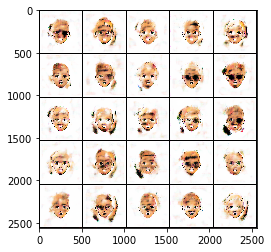

Epoch 22/50 Step 13610... Discriminator Loss: 0.6254... Generator Loss: 2.8506
Epoch 22/50 Step 13620... Discriminator Loss: 0.7286... Generator Loss: 1.5200
Epoch 22/50 Step 13630... Discriminator Loss: 1.3605... Generator Loss: 0.6307
Epoch 22/50 Step 13640... Discriminator Loss: 0.9769... Generator Loss: 4.9527
Epoch 22/50 Step 13650... Discriminator Loss: 0.6180... Generator Loss: 2.0429
Epoch 22/50 Step 13660... Discriminator Loss: 0.8384... Generator Loss: 1.3313
Epoch 22/50 Step 13670... Discriminator Loss: 0.7315... Generator Loss: 1.9883
Epoch 22/50 Step 13680... Discriminator Loss: 0.6861... Generator Loss: 3.0565
Epoch 22/50 Step 13690... Discriminator Loss: 0.6310... Generator Loss: 1.6518
Epoch 22/50 Step 13700... Discriminator Loss: 0.7994... Generator Loss: 1.4107


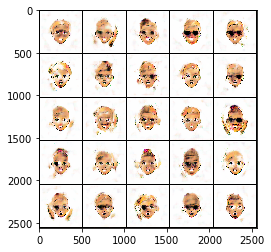

Epoch 22/50 Step 13710... Discriminator Loss: 0.9033... Generator Loss: 2.5825
Epoch 22/50 Step 13720... Discriminator Loss: 2.2885... Generator Loss: 0.2293
Epoch 22/50 Step 13730... Discriminator Loss: 1.3115... Generator Loss: 4.3433
Epoch 22/50 Step 13740... Discriminator Loss: 0.6110... Generator Loss: 2.2832
Epoch 22/50 Step 13750... Discriminator Loss: 0.7483... Generator Loss: 1.4334
Epoch 23/50 Step 13760... Discriminator Loss: 0.6903... Generator Loss: 1.7026
Epoch 23/50 Step 13770... Discriminator Loss: 0.8555... Generator Loss: 1.7745
Epoch 23/50 Step 13780... Discriminator Loss: 0.5500... Generator Loss: 2.1088
Epoch 23/50 Step 13790... Discriminator Loss: 0.6850... Generator Loss: 3.0192
Epoch 23/50 Step 13800... Discriminator Loss: 0.8043... Generator Loss: 2.1292


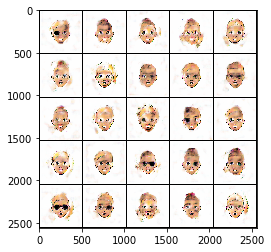

Epoch 23/50 Step 13810... Discriminator Loss: 0.6534... Generator Loss: 3.0678
Epoch 23/50 Step 13820... Discriminator Loss: 0.6361... Generator Loss: 1.8856
Epoch 23/50 Step 13830... Discriminator Loss: 0.6492... Generator Loss: 2.6483
Epoch 23/50 Step 13840... Discriminator Loss: 0.7661... Generator Loss: 1.7929
Epoch 23/50 Step 13850... Discriminator Loss: 0.6105... Generator Loss: 2.9641
Epoch 23/50 Step 13860... Discriminator Loss: 0.7831... Generator Loss: 4.2579
Epoch 23/50 Step 13870... Discriminator Loss: 0.7101... Generator Loss: 1.5748
Epoch 23/50 Step 13880... Discriminator Loss: 0.8194... Generator Loss: 3.3795
Epoch 23/50 Step 13890... Discriminator Loss: 0.5954... Generator Loss: 1.8903
Epoch 23/50 Step 13900... Discriminator Loss: 0.7327... Generator Loss: 2.1720


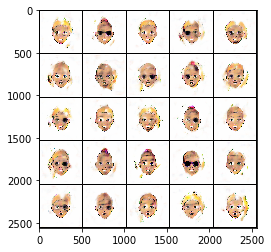

Epoch 23/50 Step 13910... Discriminator Loss: 0.6386... Generator Loss: 2.6230
Epoch 23/50 Step 13920... Discriminator Loss: 0.6985... Generator Loss: 1.8399
Epoch 23/50 Step 13930... Discriminator Loss: 0.5668... Generator Loss: 2.8282
Epoch 23/50 Step 13940... Discriminator Loss: 0.5215... Generator Loss: 2.4423
Epoch 23/50 Step 13950... Discriminator Loss: 1.1110... Generator Loss: 3.5989
Epoch 23/50 Step 13960... Discriminator Loss: 0.8008... Generator Loss: 3.5360
Epoch 23/50 Step 13970... Discriminator Loss: 0.5008... Generator Loss: 2.9777
Epoch 23/50 Step 13980... Discriminator Loss: 0.6110... Generator Loss: 1.9741
Epoch 23/50 Step 13990... Discriminator Loss: 0.6318... Generator Loss: 1.6159
Epoch 23/50 Step 14000... Discriminator Loss: 0.8289... Generator Loss: 1.2342


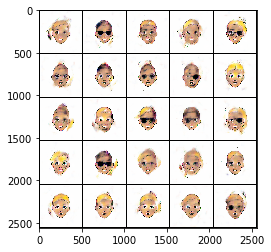

Epoch 23/50 Step 14010... Discriminator Loss: 0.5230... Generator Loss: 2.5606
Epoch 23/50 Step 14020... Discriminator Loss: 0.6076... Generator Loss: 1.7537
Epoch 23/50 Step 14030... Discriminator Loss: 0.6308... Generator Loss: 2.8491
Epoch 23/50 Step 14040... Discriminator Loss: 0.6460... Generator Loss: 1.8295
Epoch 23/50 Step 14050... Discriminator Loss: 0.6131... Generator Loss: 3.1330
Epoch 23/50 Step 14060... Discriminator Loss: 0.5482... Generator Loss: 2.7654
Epoch 23/50 Step 14070... Discriminator Loss: 0.9079... Generator Loss: 1.0587
Epoch 23/50 Step 14080... Discriminator Loss: 0.6148... Generator Loss: 1.8598
Epoch 23/50 Step 14090... Discriminator Loss: 0.5867... Generator Loss: 2.3494
Epoch 23/50 Step 14100... Discriminator Loss: 0.7227... Generator Loss: 2.7942


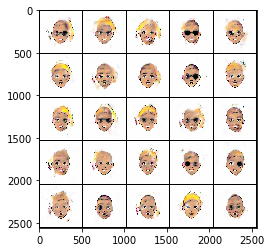

Epoch 23/50 Step 14110... Discriminator Loss: 0.5183... Generator Loss: 2.6351
Epoch 23/50 Step 14120... Discriminator Loss: 1.3944... Generator Loss: 2.0590
Epoch 23/50 Step 14130... Discriminator Loss: 0.7569... Generator Loss: 1.3917
Epoch 23/50 Step 14140... Discriminator Loss: 0.5602... Generator Loss: 2.2983
Epoch 23/50 Step 14150... Discriminator Loss: 0.5423... Generator Loss: 2.7956
Epoch 23/50 Step 14160... Discriminator Loss: 0.5382... Generator Loss: 2.6894
Epoch 23/50 Step 14170... Discriminator Loss: 0.5276... Generator Loss: 2.7867
Epoch 23/50 Step 14180... Discriminator Loss: 0.6268... Generator Loss: 1.6010
Epoch 23/50 Step 14190... Discriminator Loss: 0.5221... Generator Loss: 2.4129
Epoch 23/50 Step 14200... Discriminator Loss: 0.5364... Generator Loss: 2.8764


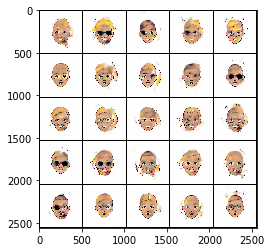

Epoch 23/50 Step 14210... Discriminator Loss: 0.5501... Generator Loss: 2.0726
Epoch 23/50 Step 14220... Discriminator Loss: 0.5283... Generator Loss: 2.4681
Epoch 23/50 Step 14230... Discriminator Loss: 0.5024... Generator Loss: 2.9829
Epoch 23/50 Step 14240... Discriminator Loss: 1.0658... Generator Loss: 0.8242
Epoch 23/50 Step 14250... Discriminator Loss: 0.5977... Generator Loss: 2.9724
Epoch 23/50 Step 14260... Discriminator Loss: 0.4954... Generator Loss: 3.0159
Epoch 23/50 Step 14270... Discriminator Loss: 0.8756... Generator Loss: 0.8801
Epoch 23/50 Step 14280... Discriminator Loss: 0.7159... Generator Loss: 4.1635
Epoch 23/50 Step 14290... Discriminator Loss: 0.4756... Generator Loss: 2.9982
Epoch 23/50 Step 14300... Discriminator Loss: 0.5472... Generator Loss: 3.2890


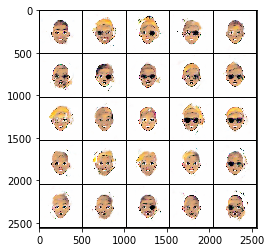

Epoch 23/50 Step 14310... Discriminator Loss: 0.6037... Generator Loss: 1.7605
Epoch 23/50 Step 14320... Discriminator Loss: 0.5487... Generator Loss: 2.2977
Epoch 23/50 Step 14330... Discriminator Loss: 0.5762... Generator Loss: 2.0651
Epoch 23/50 Step 14340... Discriminator Loss: 0.5284... Generator Loss: 3.0290
Epoch 23/50 Step 14350... Discriminator Loss: 0.4945... Generator Loss: 2.7655
Epoch 23/50 Step 14360... Discriminator Loss: 0.4744... Generator Loss: 3.1889
Epoch 23/50 Step 14370... Discriminator Loss: 0.5153... Generator Loss: 2.2305
Epoch 24/50 Step 14380... Discriminator Loss: 0.5333... Generator Loss: 2.2934
Epoch 24/50 Step 14390... Discriminator Loss: 0.5321... Generator Loss: 2.5261
Epoch 24/50 Step 14400... Discriminator Loss: 0.5638... Generator Loss: 2.6137


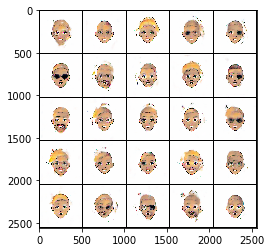

Epoch 24/50 Step 14410... Discriminator Loss: 0.4286... Generator Loss: 2.9969
Epoch 24/50 Step 14420... Discriminator Loss: 0.4946... Generator Loss: 2.5360
Epoch 24/50 Step 14430... Discriminator Loss: 0.4250... Generator Loss: 2.8037
Epoch 24/50 Step 14440... Discriminator Loss: 0.4999... Generator Loss: 2.3422
Epoch 24/50 Step 14450... Discriminator Loss: 0.4766... Generator Loss: 2.8753
Epoch 24/50 Step 14460... Discriminator Loss: 0.4679... Generator Loss: 2.7062
Epoch 24/50 Step 14470... Discriminator Loss: 0.5493... Generator Loss: 3.4964
Epoch 24/50 Step 14480... Discriminator Loss: 0.4761... Generator Loss: 2.6370
Epoch 24/50 Step 14490... Discriminator Loss: 0.7643... Generator Loss: 4.1757
Epoch 24/50 Step 14500... Discriminator Loss: 0.4628... Generator Loss: 3.1895


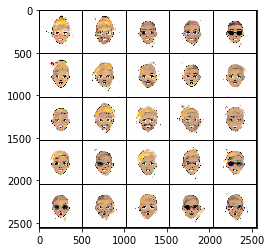

Epoch 24/50 Step 14510... Discriminator Loss: 0.5126... Generator Loss: 3.0342
Epoch 24/50 Step 14520... Discriminator Loss: 0.5003... Generator Loss: 2.8551
Epoch 24/50 Step 14530... Discriminator Loss: 0.5244... Generator Loss: 2.0600
Epoch 24/50 Step 14540... Discriminator Loss: 0.5696... Generator Loss: 2.1143
Epoch 24/50 Step 14550... Discriminator Loss: 0.4762... Generator Loss: 3.1897
Epoch 24/50 Step 14560... Discriminator Loss: 1.5723... Generator Loss: 0.5230
Epoch 24/50 Step 14570... Discriminator Loss: 0.5980... Generator Loss: 2.5557
Epoch 24/50 Step 14580... Discriminator Loss: 0.4865... Generator Loss: 3.4335
Epoch 24/50 Step 14590... Discriminator Loss: 0.4835... Generator Loss: 2.3987
Epoch 24/50 Step 14600... Discriminator Loss: 0.5011... Generator Loss: 2.5064


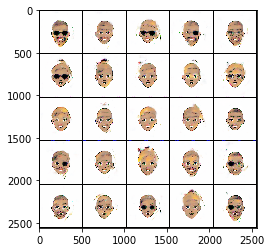

Epoch 24/50 Step 14610... Discriminator Loss: 1.0809... Generator Loss: 0.8406
Epoch 24/50 Step 14620... Discriminator Loss: 0.5512... Generator Loss: 3.0371
Epoch 24/50 Step 14630... Discriminator Loss: 0.6135... Generator Loss: 1.7553
Epoch 24/50 Step 14640... Discriminator Loss: 0.4878... Generator Loss: 2.6088
Epoch 24/50 Step 14650... Discriminator Loss: 0.4646... Generator Loss: 2.6052
Epoch 24/50 Step 14660... Discriminator Loss: 0.4575... Generator Loss: 2.5793
Epoch 24/50 Step 14670... Discriminator Loss: 0.4626... Generator Loss: 3.5383
Epoch 24/50 Step 14680... Discriminator Loss: 0.4308... Generator Loss: 3.1043
Epoch 24/50 Step 14690... Discriminator Loss: 0.4699... Generator Loss: 2.3720
Epoch 24/50 Step 14700... Discriminator Loss: 0.5554... Generator Loss: 2.5062


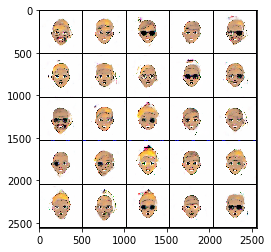

Epoch 24/50 Step 14710... Discriminator Loss: 0.4277... Generator Loss: 2.6484
Epoch 24/50 Step 14720... Discriminator Loss: 0.4847... Generator Loss: 2.4946
Epoch 24/50 Step 14730... Discriminator Loss: 0.8503... Generator Loss: 1.4458
Epoch 24/50 Step 14740... Discriminator Loss: 0.4145... Generator Loss: 3.1970
Epoch 24/50 Step 14750... Discriminator Loss: 0.4455... Generator Loss: 2.6053
Epoch 24/50 Step 14760... Discriminator Loss: 0.5106... Generator Loss: 3.0716
Epoch 24/50 Step 14770... Discriminator Loss: 0.5237... Generator Loss: 2.2380
Epoch 24/50 Step 14780... Discriminator Loss: 0.3998... Generator Loss: 3.3026
Epoch 24/50 Step 14790... Discriminator Loss: 0.4860... Generator Loss: 2.2843
Epoch 24/50 Step 14800... Discriminator Loss: 0.6864... Generator Loss: 4.4288


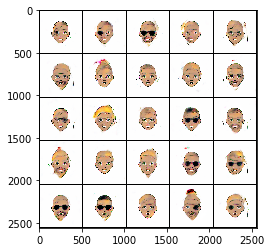

Epoch 24/50 Step 14810... Discriminator Loss: 0.4459... Generator Loss: 3.4016
Epoch 24/50 Step 14820... Discriminator Loss: 0.4279... Generator Loss: 2.8309
Epoch 24/50 Step 14830... Discriminator Loss: 0.6040... Generator Loss: 1.8327
Epoch 24/50 Step 14840... Discriminator Loss: 0.4362... Generator Loss: 3.1975
Epoch 24/50 Step 14850... Discriminator Loss: 0.7985... Generator Loss: 1.2562
Epoch 24/50 Step 14860... Discriminator Loss: 0.6647... Generator Loss: 4.4594
Epoch 24/50 Step 14870... Discriminator Loss: 0.4756... Generator Loss: 3.1581
Epoch 24/50 Step 14880... Discriminator Loss: 0.4368... Generator Loss: 3.0999
Epoch 24/50 Step 14890... Discriminator Loss: 0.6568... Generator Loss: 4.8015
Epoch 24/50 Step 14900... Discriminator Loss: 0.4909... Generator Loss: 2.2901


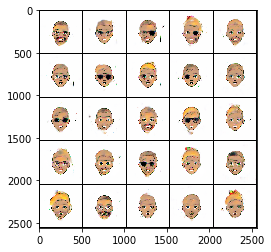

Epoch 24/50 Step 14910... Discriminator Loss: 0.4864... Generator Loss: 2.4053
Epoch 24/50 Step 14920... Discriminator Loss: 0.4322... Generator Loss: 3.2964
Epoch 24/50 Step 14930... Discriminator Loss: 0.4172... Generator Loss: 3.3153
Epoch 24/50 Step 14940... Discriminator Loss: 0.4768... Generator Loss: 2.4350
Epoch 24/50 Step 14950... Discriminator Loss: 0.6028... Generator Loss: 4.3982
Epoch 24/50 Step 14960... Discriminator Loss: 1.0815... Generator Loss: 5.3109
Epoch 24/50 Step 14970... Discriminator Loss: 0.6920... Generator Loss: 1.9243
Epoch 24/50 Step 14980... Discriminator Loss: 0.5311... Generator Loss: 2.5315
Epoch 24/50 Step 14990... Discriminator Loss: 0.4675... Generator Loss: 3.0126
Epoch 24/50 Step 15000... Discriminator Loss: 0.6572... Generator Loss: 1.5705


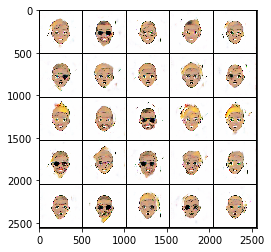

Epoch 25/50 Step 15010... Discriminator Loss: 0.4846... Generator Loss: 2.8595
Epoch 25/50 Step 15020... Discriminator Loss: 0.5733... Generator Loss: 2.0865
Epoch 25/50 Step 15030... Discriminator Loss: 0.3940... Generator Loss: 3.3507
Epoch 25/50 Step 15040... Discriminator Loss: 0.4873... Generator Loss: 3.3163
Epoch 25/50 Step 15050... Discriminator Loss: 0.4117... Generator Loss: 3.2130
Epoch 25/50 Step 15060... Discriminator Loss: 0.4490... Generator Loss: 3.3342
Epoch 25/50 Step 15070... Discriminator Loss: 0.4418... Generator Loss: 2.7248
Epoch 25/50 Step 15080... Discriminator Loss: 0.4555... Generator Loss: 3.0200
Epoch 25/50 Step 15090... Discriminator Loss: 0.4348... Generator Loss: 2.9663
Epoch 25/50 Step 15100... Discriminator Loss: 0.4094... Generator Loss: 3.3628


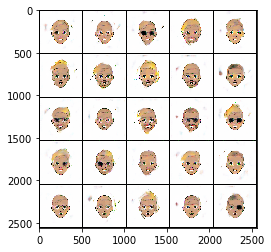

Epoch 25/50 Step 15110... Discriminator Loss: 0.4107... Generator Loss: 3.5580
Epoch 25/50 Step 15120... Discriminator Loss: 0.3958... Generator Loss: 3.1978
Epoch 25/50 Step 15130... Discriminator Loss: 0.4342... Generator Loss: 2.9072
Epoch 25/50 Step 15140... Discriminator Loss: 0.4321... Generator Loss: 3.0141
Epoch 25/50 Step 15150... Discriminator Loss: 0.4866... Generator Loss: 2.5244
Epoch 25/50 Step 15160... Discriminator Loss: 0.4782... Generator Loss: 3.1607
Epoch 25/50 Step 15170... Discriminator Loss: 0.4521... Generator Loss: 2.8721
Epoch 25/50 Step 15180... Discriminator Loss: 0.4344... Generator Loss: 2.8152
Epoch 25/50 Step 15190... Discriminator Loss: 0.4247... Generator Loss: 3.5273
Epoch 25/50 Step 15200... Discriminator Loss: 0.7609... Generator Loss: 1.5011


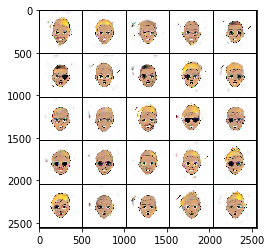

Epoch 25/50 Step 15210... Discriminator Loss: 0.3845... Generator Loss: 3.5768
Epoch 25/50 Step 15220... Discriminator Loss: 0.4353... Generator Loss: 4.0099
Epoch 25/50 Step 15230... Discriminator Loss: 0.4258... Generator Loss: 2.8533
Epoch 25/50 Step 15240... Discriminator Loss: 0.8192... Generator Loss: 1.5481
Epoch 25/50 Step 15250... Discriminator Loss: 0.5311... Generator Loss: 2.2571
Epoch 25/50 Step 15260... Discriminator Loss: 0.3941... Generator Loss: 3.7068
Epoch 25/50 Step 15270... Discriminator Loss: 0.4509... Generator Loss: 3.2931
Epoch 25/50 Step 15280... Discriminator Loss: 0.5254... Generator Loss: 4.1252
Epoch 25/50 Step 15290... Discriminator Loss: 0.3763... Generator Loss: 3.7612
Epoch 25/50 Step 15300... Discriminator Loss: 0.3944... Generator Loss: 3.7174


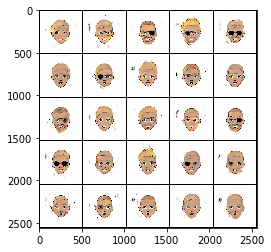

Epoch 25/50 Step 15310... Discriminator Loss: 0.4181... Generator Loss: 3.6056
Epoch 25/50 Step 15320... Discriminator Loss: 0.5933... Generator Loss: 5.8345
Epoch 25/50 Step 15330... Discriminator Loss: 0.4274... Generator Loss: 3.9442
Epoch 25/50 Step 15340... Discriminator Loss: 0.4214... Generator Loss: 3.6957
Epoch 25/50 Step 15350... Discriminator Loss: 0.4171... Generator Loss: 3.0904
Epoch 25/50 Step 15360... Discriminator Loss: 0.3954... Generator Loss: 3.3196
Epoch 25/50 Step 15370... Discriminator Loss: 0.3915... Generator Loss: 3.5633
Epoch 25/50 Step 15380... Discriminator Loss: 0.3992... Generator Loss: 3.5970
Epoch 25/50 Step 15390... Discriminator Loss: 0.3852... Generator Loss: 3.4789
Epoch 25/50 Step 15400... Discriminator Loss: 0.3966... Generator Loss: 3.4380


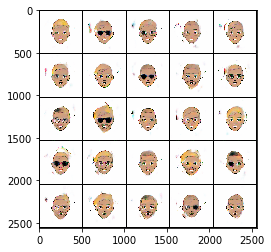

Epoch 25/50 Step 15410... Discriminator Loss: 0.3874... Generator Loss: 3.6637
Epoch 25/50 Step 15420... Discriminator Loss: 0.3714... Generator Loss: 4.1032
Epoch 25/50 Step 15430... Discriminator Loss: 0.4220... Generator Loss: 2.7584
Epoch 25/50 Step 15440... Discriminator Loss: 0.4038... Generator Loss: 3.5842
Epoch 25/50 Step 15450... Discriminator Loss: 0.3820... Generator Loss: 4.1921
Epoch 25/50 Step 15460... Discriminator Loss: 0.4077... Generator Loss: 3.9344
Epoch 25/50 Step 15470... Discriminator Loss: 0.3821... Generator Loss: 4.1997
Epoch 25/50 Step 15480... Discriminator Loss: 0.4463... Generator Loss: 4.6679
Epoch 25/50 Step 15490... Discriminator Loss: 0.4371... Generator Loss: 2.7581
Epoch 25/50 Step 15500... Discriminator Loss: 0.4219... Generator Loss: 3.5104


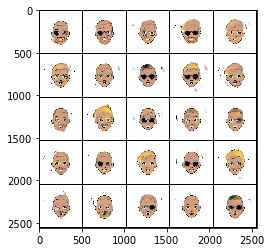

Epoch 25/50 Step 15510... Discriminator Loss: 0.3644... Generator Loss: 4.1761
Epoch 25/50 Step 15520... Discriminator Loss: 0.5181... Generator Loss: 2.1225
Epoch 25/50 Step 15530... Discriminator Loss: 0.4147... Generator Loss: 4.4064
Epoch 25/50 Step 15540... Discriminator Loss: 0.3724... Generator Loss: 4.4200
Epoch 25/50 Step 15550... Discriminator Loss: 0.3915... Generator Loss: 4.1347
Epoch 25/50 Step 15560... Discriminator Loss: 0.4453... Generator Loss: 2.9350
Epoch 25/50 Step 15570... Discriminator Loss: 0.4255... Generator Loss: 3.5508
Epoch 25/50 Step 15580... Discriminator Loss: 0.4294... Generator Loss: 3.2400
Epoch 25/50 Step 15590... Discriminator Loss: 0.3811... Generator Loss: 4.0566
Epoch 25/50 Step 15600... Discriminator Loss: 0.3858... Generator Loss: 3.4192


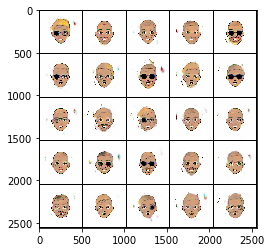

Epoch 25/50 Step 15610... Discriminator Loss: 0.3728... Generator Loss: 3.4740
Epoch 25/50 Step 15620... Discriminator Loss: 0.4235... Generator Loss: 3.0360
Epoch 26/50 Step 15630... Discriminator Loss: 0.3923... Generator Loss: 3.4522
Epoch 26/50 Step 15640... Discriminator Loss: 0.3842... Generator Loss: 4.0528
Epoch 26/50 Step 15650... Discriminator Loss: 1.4362... Generator Loss: 3.9089
Epoch 26/50 Step 15660... Discriminator Loss: 0.5401... Generator Loss: 3.8083
Epoch 26/50 Step 15670... Discriminator Loss: 0.5899... Generator Loss: 2.3580
Epoch 26/50 Step 15680... Discriminator Loss: 0.4419... Generator Loss: 2.9406
Epoch 26/50 Step 15690... Discriminator Loss: 0.5784... Generator Loss: 2.4154
Epoch 26/50 Step 15700... Discriminator Loss: 0.5153... Generator Loss: 2.1589


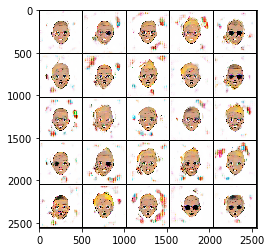

Epoch 26/50 Step 15710... Discriminator Loss: 0.5358... Generator Loss: 2.5913
Epoch 26/50 Step 15720... Discriminator Loss: 0.4465... Generator Loss: 3.4783
Epoch 26/50 Step 15730... Discriminator Loss: 0.4795... Generator Loss: 2.7636
Epoch 26/50 Step 15740... Discriminator Loss: 0.5322... Generator Loss: 3.3457
Epoch 26/50 Step 15750... Discriminator Loss: 0.4376... Generator Loss: 3.1385
Epoch 26/50 Step 15760... Discriminator Loss: 0.4647... Generator Loss: 2.8474
Epoch 26/50 Step 15770... Discriminator Loss: 0.4591... Generator Loss: 2.9452
Epoch 26/50 Step 15780... Discriminator Loss: 0.4286... Generator Loss: 2.9147
Epoch 26/50 Step 15790... Discriminator Loss: 0.4511... Generator Loss: 2.8236
Epoch 26/50 Step 15800... Discriminator Loss: 0.4305... Generator Loss: 2.9525


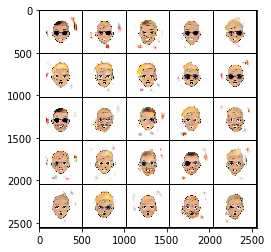

Epoch 26/50 Step 15810... Discriminator Loss: 0.3982... Generator Loss: 3.6668
Epoch 26/50 Step 15820... Discriminator Loss: 0.4654... Generator Loss: 2.4209
Epoch 26/50 Step 15830... Discriminator Loss: 0.4194... Generator Loss: 3.6191
Epoch 26/50 Step 15840... Discriminator Loss: 0.4493... Generator Loss: 3.5645
Epoch 26/50 Step 15850... Discriminator Loss: 0.4894... Generator Loss: 2.6678
Epoch 26/50 Step 15860... Discriminator Loss: 0.4323... Generator Loss: 2.9526
Epoch 26/50 Step 15870... Discriminator Loss: 0.4387... Generator Loss: 2.9726
Epoch 26/50 Step 15880... Discriminator Loss: 0.4069... Generator Loss: 3.0514
Epoch 26/50 Step 15890... Discriminator Loss: 0.4273... Generator Loss: 2.9742
Epoch 26/50 Step 15900... Discriminator Loss: 0.3909... Generator Loss: 3.3452


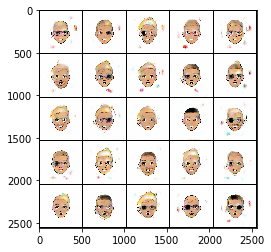

Epoch 26/50 Step 15910... Discriminator Loss: 0.3953... Generator Loss: 3.1775
Epoch 26/50 Step 15920... Discriminator Loss: 0.3866... Generator Loss: 3.7936
Epoch 26/50 Step 15930... Discriminator Loss: 0.3782... Generator Loss: 3.3014
Epoch 26/50 Step 15940... Discriminator Loss: 0.3909... Generator Loss: 4.0152
Epoch 26/50 Step 15950... Discriminator Loss: 0.4158... Generator Loss: 3.4494
Epoch 26/50 Step 15960... Discriminator Loss: 0.3977... Generator Loss: 4.3042
Epoch 26/50 Step 15970... Discriminator Loss: 0.3861... Generator Loss: 3.6092
Epoch 26/50 Step 15980... Discriminator Loss: 0.4039... Generator Loss: 4.5065
Epoch 26/50 Step 15990... Discriminator Loss: 0.3979... Generator Loss: 3.2557
Epoch 26/50 Step 16000... Discriminator Loss: 0.3859... Generator Loss: 3.5684


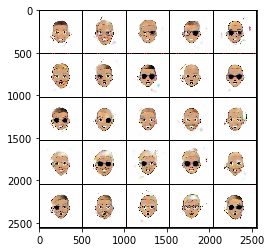

Epoch 26/50 Step 16010... Discriminator Loss: 0.4002... Generator Loss: 4.0438
Epoch 26/50 Step 16020... Discriminator Loss: 0.4129... Generator Loss: 3.0386
Epoch 26/50 Step 16030... Discriminator Loss: 0.4026... Generator Loss: 3.8430
Epoch 26/50 Step 16040... Discriminator Loss: 0.3733... Generator Loss: 3.4752
Epoch 26/50 Step 16050... Discriminator Loss: 0.3922... Generator Loss: 4.2113
Epoch 26/50 Step 16060... Discriminator Loss: 0.3729... Generator Loss: 4.2475
Epoch 26/50 Step 16070... Discriminator Loss: 0.3921... Generator Loss: 3.6839
Epoch 26/50 Step 16080... Discriminator Loss: 0.3983... Generator Loss: 3.1241
Epoch 26/50 Step 16090... Discriminator Loss: 0.3731... Generator Loss: 3.8169
Epoch 26/50 Step 16100... Discriminator Loss: 0.6680... Generator Loss: 1.8893


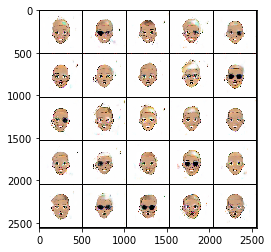

Epoch 26/50 Step 16110... Discriminator Loss: 0.4208... Generator Loss: 4.6289
Epoch 26/50 Step 16120... Discriminator Loss: 0.4150... Generator Loss: 3.3077
Epoch 26/50 Step 16130... Discriminator Loss: 0.3721... Generator Loss: 3.9964
Epoch 26/50 Step 16140... Discriminator Loss: 0.3662... Generator Loss: 4.4301
Epoch 26/50 Step 16150... Discriminator Loss: 0.3866... Generator Loss: 4.1488
Epoch 26/50 Step 16160... Discriminator Loss: 0.3865... Generator Loss: 3.9324
Epoch 26/50 Step 16170... Discriminator Loss: 0.3610... Generator Loss: 4.1198
Epoch 26/50 Step 16180... Discriminator Loss: 0.3768... Generator Loss: 3.5748
Epoch 26/50 Step 16190... Discriminator Loss: 0.3767... Generator Loss: 4.2215
Epoch 26/50 Step 16200... Discriminator Loss: 0.3739... Generator Loss: 4.0522


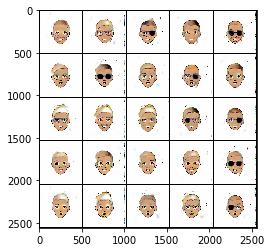

Epoch 26/50 Step 16210... Discriminator Loss: 0.3608... Generator Loss: 4.3335
Epoch 26/50 Step 16220... Discriminator Loss: 0.3730... Generator Loss: 4.0313
Epoch 26/50 Step 16230... Discriminator Loss: 0.3891... Generator Loss: 3.7479
Epoch 26/50 Step 16240... Discriminator Loss: 0.3654... Generator Loss: 4.4519
Epoch 26/50 Step 16250... Discriminator Loss: 0.4717... Generator Loss: 2.9728
Epoch 27/50 Step 16260... Discriminator Loss: 0.3565... Generator Loss: 4.6830
Epoch 27/50 Step 16270... Discriminator Loss: 0.4848... Generator Loss: 2.5927
Epoch 27/50 Step 16280... Discriminator Loss: 0.3438... Generator Loss: 4.4631
Epoch 27/50 Step 16290... Discriminator Loss: 0.3669... Generator Loss: 4.4309
Epoch 27/50 Step 16300... Discriminator Loss: 0.3697... Generator Loss: 3.7103


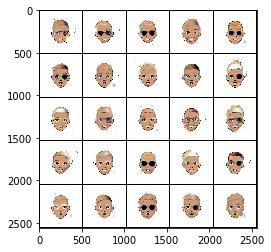

Epoch 27/50 Step 16310... Discriminator Loss: 0.3804... Generator Loss: 3.6544
Epoch 27/50 Step 16320... Discriminator Loss: 0.3721... Generator Loss: 3.9630
Epoch 27/50 Step 16330... Discriminator Loss: 0.3666... Generator Loss: 4.3970
Epoch 27/50 Step 16340... Discriminator Loss: 0.3704... Generator Loss: 4.4934
Epoch 27/50 Step 16350... Discriminator Loss: 0.3665... Generator Loss: 4.3717
Epoch 27/50 Step 16360... Discriminator Loss: 0.3520... Generator Loss: 4.1654
Epoch 27/50 Step 16370... Discriminator Loss: 0.3493... Generator Loss: 4.4291
Epoch 27/50 Step 16380... Discriminator Loss: 0.3604... Generator Loss: 3.9006
Epoch 27/50 Step 16390... Discriminator Loss: 0.3797... Generator Loss: 4.2402
Epoch 27/50 Step 16400... Discriminator Loss: 6.4528... Generator Loss: 14.2831


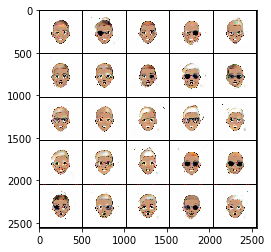

Epoch 27/50 Step 16410... Discriminator Loss: 0.5065... Generator Loss: 4.5259
Epoch 27/50 Step 16420... Discriminator Loss: 0.3998... Generator Loss: 4.4918
Epoch 27/50 Step 16430... Discriminator Loss: 0.3900... Generator Loss: 4.3611
Epoch 27/50 Step 16440... Discriminator Loss: 0.4152... Generator Loss: 4.2129
Epoch 27/50 Step 16450... Discriminator Loss: 0.3828... Generator Loss: 3.7996
Epoch 27/50 Step 16460... Discriminator Loss: 0.3615... Generator Loss: 4.3585
Epoch 27/50 Step 16470... Discriminator Loss: 0.3609... Generator Loss: 4.0901
Epoch 27/50 Step 16480... Discriminator Loss: 0.4142... Generator Loss: 3.1102
Epoch 27/50 Step 16490... Discriminator Loss: 0.3665... Generator Loss: 4.0778
Epoch 27/50 Step 16500... Discriminator Loss: 0.4061... Generator Loss: 3.2248


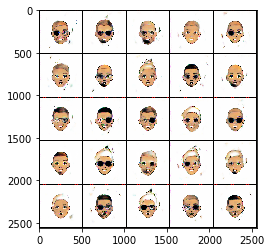

Epoch 27/50 Step 16510... Discriminator Loss: 0.3527... Generator Loss: 4.6498
Epoch 27/50 Step 16520... Discriminator Loss: 0.3658... Generator Loss: 3.9921
Epoch 27/50 Step 16530... Discriminator Loss: 0.3674... Generator Loss: 4.3771
Epoch 27/50 Step 16540... Discriminator Loss: 0.3911... Generator Loss: 3.5762
Epoch 27/50 Step 16550... Discriminator Loss: 0.3632... Generator Loss: 4.2285
Epoch 27/50 Step 16560... Discriminator Loss: 0.3797... Generator Loss: 3.7854
Epoch 27/50 Step 16570... Discriminator Loss: 1.7414... Generator Loss: 0.6625
Epoch 27/50 Step 16580... Discriminator Loss: 0.4086... Generator Loss: 4.5170
Epoch 27/50 Step 16590... Discriminator Loss: 0.3758... Generator Loss: 4.7457
Epoch 27/50 Step 16600... Discriminator Loss: 0.3692... Generator Loss: 4.5507


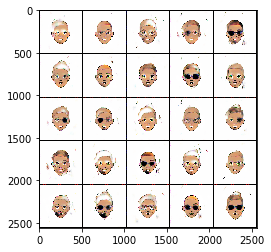

Epoch 27/50 Step 16610... Discriminator Loss: 0.4317... Generator Loss: 3.2200
Epoch 27/50 Step 16620... Discriminator Loss: 0.3738... Generator Loss: 4.6559
Epoch 27/50 Step 16630... Discriminator Loss: 0.3688... Generator Loss: 4.2465
Epoch 27/50 Step 16640... Discriminator Loss: 0.3695... Generator Loss: 4.0731
Epoch 27/50 Step 16650... Discriminator Loss: 0.3757... Generator Loss: 4.1229
Epoch 27/50 Step 16660... Discriminator Loss: 0.3580... Generator Loss: 4.7005
Epoch 27/50 Step 16670... Discriminator Loss: 0.3507... Generator Loss: 4.8127
Epoch 27/50 Step 16680... Discriminator Loss: 0.4320... Generator Loss: 3.1123
Epoch 27/50 Step 16690... Discriminator Loss: 0.3967... Generator Loss: 3.8853
Epoch 27/50 Step 16700... Discriminator Loss: 0.3489... Generator Loss: 4.6942


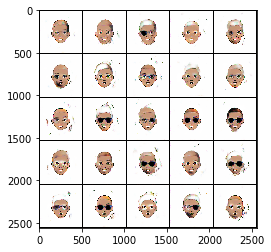

Epoch 27/50 Step 16710... Discriminator Loss: 0.4854... Generator Loss: 3.0626
Epoch 27/50 Step 16720... Discriminator Loss: 0.3829... Generator Loss: 4.3476
Epoch 27/50 Step 16730... Discriminator Loss: 0.3890... Generator Loss: 4.9078
Epoch 27/50 Step 16740... Discriminator Loss: 0.3896... Generator Loss: 4.8388
Epoch 27/50 Step 16750... Discriminator Loss: 0.4280... Generator Loss: 3.9121
Epoch 27/50 Step 16760... Discriminator Loss: 0.3719... Generator Loss: 5.4135
Epoch 27/50 Step 16770... Discriminator Loss: 0.4071... Generator Loss: 3.3480
Epoch 27/50 Step 16780... Discriminator Loss: 0.3622... Generator Loss: 4.5815
Epoch 27/50 Step 16790... Discriminator Loss: 0.3592... Generator Loss: 5.0957
Epoch 27/50 Step 16800... Discriminator Loss: 0.3702... Generator Loss: 4.5395


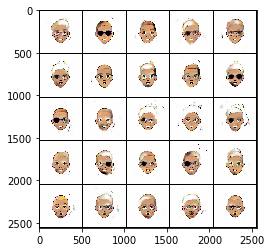

Epoch 27/50 Step 16810... Discriminator Loss: 0.3717... Generator Loss: 3.8918
Epoch 27/50 Step 16820... Discriminator Loss: 0.3666... Generator Loss: 4.5598
Epoch 27/50 Step 16830... Discriminator Loss: 0.3555... Generator Loss: 4.3910
Epoch 27/50 Step 16840... Discriminator Loss: 0.3511... Generator Loss: 4.4821
Epoch 27/50 Step 16850... Discriminator Loss: 0.3472... Generator Loss: 5.1095
Epoch 27/50 Step 16860... Discriminator Loss: 0.3405... Generator Loss: 5.0752
Epoch 27/50 Step 16870... Discriminator Loss: 0.3512... Generator Loss: 5.2407
Epoch 28/50 Step 16880... Discriminator Loss: 0.3617... Generator Loss: 4.0084
Epoch 28/50 Step 16890... Discriminator Loss: 0.3538... Generator Loss: 4.5067
Epoch 28/50 Step 16900... Discriminator Loss: 0.3645... Generator Loss: 4.9375


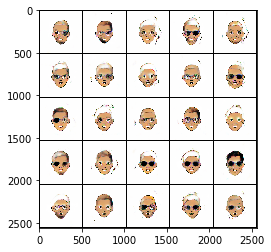

Epoch 28/50 Step 16910... Discriminator Loss: 0.3449... Generator Loss: 4.9032
Epoch 28/50 Step 16920... Discriminator Loss: 0.3535... Generator Loss: 4.2739
Epoch 28/50 Step 16930... Discriminator Loss: 0.3458... Generator Loss: 5.1274
Epoch 28/50 Step 16940... Discriminator Loss: 0.3599... Generator Loss: 4.1269
Epoch 28/50 Step 16950... Discriminator Loss: 0.3573... Generator Loss: 4.5062
Epoch 28/50 Step 16960... Discriminator Loss: 0.3742... Generator Loss: 3.8820
Epoch 28/50 Step 16970... Discriminator Loss: 0.3699... Generator Loss: 5.4243
Epoch 28/50 Step 16980... Discriminator Loss: 0.3642... Generator Loss: 4.5139
Epoch 28/50 Step 16990... Discriminator Loss: 0.3616... Generator Loss: 5.0014
Epoch 28/50 Step 17000... Discriminator Loss: 0.3493... Generator Loss: 4.7550


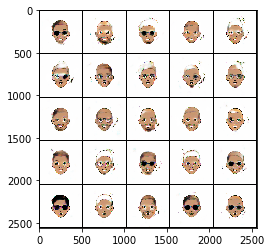

Epoch 28/50 Step 17010... Discriminator Loss: 0.3628... Generator Loss: 4.3797
Epoch 28/50 Step 17020... Discriminator Loss: 0.3741... Generator Loss: 5.0402
Epoch 28/50 Step 17030... Discriminator Loss: 0.4030... Generator Loss: 3.7333
Epoch 28/50 Step 17040... Discriminator Loss: 0.3654... Generator Loss: 4.2225
Epoch 28/50 Step 17050... Discriminator Loss: 0.3530... Generator Loss: 4.5781
Epoch 28/50 Step 17060... Discriminator Loss: 0.5133... Generator Loss: 2.8749
Epoch 28/50 Step 17070... Discriminator Loss: 0.3675... Generator Loss: 4.0954
Epoch 28/50 Step 17080... Discriminator Loss: 0.3877... Generator Loss: 5.7339
Epoch 28/50 Step 17090... Discriminator Loss: 0.3559... Generator Loss: 4.4369
Epoch 28/50 Step 17100... Discriminator Loss: 0.3913... Generator Loss: 3.6021


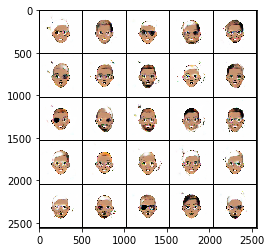

Epoch 28/50 Step 17110... Discriminator Loss: 0.4732... Generator Loss: 3.0700
Epoch 28/50 Step 17120... Discriminator Loss: 0.3763... Generator Loss: 4.0343
Epoch 28/50 Step 17130... Discriminator Loss: 0.8909... Generator Loss: 1.7903
Epoch 28/50 Step 17140... Discriminator Loss: 57.3669... Generator Loss: 54.8285
Epoch 28/50 Step 17150... Discriminator Loss: 2.3255... Generator Loss: 8.3708
Epoch 28/50 Step 17160... Discriminator Loss: 0.7141... Generator Loss: 2.8739
Epoch 28/50 Step 17170... Discriminator Loss: 0.7346... Generator Loss: 2.4928
Epoch 28/50 Step 17180... Discriminator Loss: 0.5742... Generator Loss: 2.3955
Epoch 28/50 Step 17190... Discriminator Loss: 0.6307... Generator Loss: 3.4288
Epoch 28/50 Step 17200... Discriminator Loss: 0.5608... Generator Loss: 2.5263


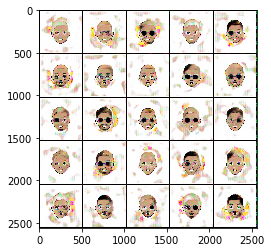

Epoch 28/50 Step 17210... Discriminator Loss: 0.4350... Generator Loss: 3.5123
Epoch 28/50 Step 17220... Discriminator Loss: 0.4859... Generator Loss: 3.3734
Epoch 28/50 Step 17230... Discriminator Loss: 0.5928... Generator Loss: 1.8292
Epoch 28/50 Step 17240... Discriminator Loss: 0.5901... Generator Loss: 2.2909
Epoch 28/50 Step 17250... Discriminator Loss: 0.5777... Generator Loss: 2.1148
Epoch 28/50 Step 17260... Discriminator Loss: 0.5925... Generator Loss: 2.1282
Epoch 28/50 Step 17270... Discriminator Loss: 0.4665... Generator Loss: 3.4295
Epoch 28/50 Step 17280... Discriminator Loss: 0.4244... Generator Loss: 4.0579
Epoch 28/50 Step 17290... Discriminator Loss: 0.4322... Generator Loss: 3.0567
Epoch 28/50 Step 17300... Discriminator Loss: 0.4248... Generator Loss: 3.0756


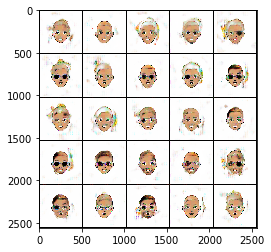

Epoch 28/50 Step 17310... Discriminator Loss: 0.4468... Generator Loss: 2.9218
Epoch 28/50 Step 17320... Discriminator Loss: 0.4137... Generator Loss: 3.1457
Epoch 28/50 Step 17330... Discriminator Loss: 0.4469... Generator Loss: 2.7790
Epoch 28/50 Step 17340... Discriminator Loss: 0.4173... Generator Loss: 3.1945
Epoch 28/50 Step 17350... Discriminator Loss: 0.6803... Generator Loss: 1.6819
Epoch 28/50 Step 17360... Discriminator Loss: 0.4137... Generator Loss: 4.0599
Epoch 28/50 Step 17370... Discriminator Loss: 0.4432... Generator Loss: 2.9218
Epoch 28/50 Step 17380... Discriminator Loss: 0.4356... Generator Loss: 2.9536
Epoch 28/50 Step 17390... Discriminator Loss: 0.3706... Generator Loss: 3.7842
Epoch 28/50 Step 17400... Discriminator Loss: 0.3873... Generator Loss: 3.4321


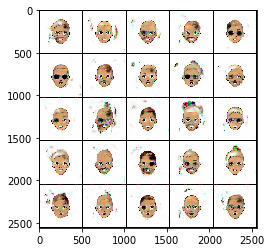

Epoch 28/50 Step 17410... Discriminator Loss: 0.4177... Generator Loss: 2.8599
Epoch 28/50 Step 17420... Discriminator Loss: 0.4009... Generator Loss: 3.2305
Epoch 28/50 Step 17430... Discriminator Loss: 0.3822... Generator Loss: 3.7791
Epoch 28/50 Step 17440... Discriminator Loss: 0.4928... Generator Loss: 2.2790
Epoch 28/50 Step 17450... Discriminator Loss: 0.4009... Generator Loss: 4.4165
Epoch 28/50 Step 17460... Discriminator Loss: 0.4224... Generator Loss: 2.7838
Epoch 28/50 Step 17470... Discriminator Loss: 0.3776... Generator Loss: 3.8604
Epoch 28/50 Step 17480... Discriminator Loss: 0.3989... Generator Loss: 3.2514
Epoch 28/50 Step 17490... Discriminator Loss: 0.3723... Generator Loss: 3.9002
Epoch 28/50 Step 17500... Discriminator Loss: 0.4949... Generator Loss: 2.6467


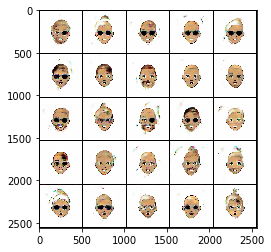

Epoch 29/50 Step 17510... Discriminator Loss: 0.3642... Generator Loss: 4.1452
Epoch 29/50 Step 17520... Discriminator Loss: 0.5526... Generator Loss: 2.1699
Epoch 29/50 Step 17530... Discriminator Loss: 0.3611... Generator Loss: 4.4294
Epoch 29/50 Step 17540... Discriminator Loss: 0.3855... Generator Loss: 4.0583
Epoch 29/50 Step 17550... Discriminator Loss: 0.3966... Generator Loss: 3.1848
Epoch 29/50 Step 17560... Discriminator Loss: 0.3695... Generator Loss: 3.6775
Epoch 29/50 Step 17570... Discriminator Loss: 0.3911... Generator Loss: 4.1665
Epoch 29/50 Step 17580... Discriminator Loss: 0.3885... Generator Loss: 4.2097
Epoch 29/50 Step 17590... Discriminator Loss: 0.3808... Generator Loss: 3.7071
Epoch 29/50 Step 17600... Discriminator Loss: 0.3812... Generator Loss: 4.5511


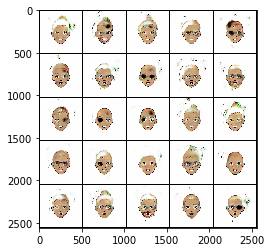

Epoch 29/50 Step 17610... Discriminator Loss: 0.3646... Generator Loss: 4.0403
Epoch 29/50 Step 17620... Discriminator Loss: 0.3833... Generator Loss: 4.3249
Epoch 29/50 Step 17630... Discriminator Loss: 0.3915... Generator Loss: 3.8167
Epoch 29/50 Step 17640... Discriminator Loss: 0.3771... Generator Loss: 3.8236
Epoch 29/50 Step 17650... Discriminator Loss: 0.3989... Generator Loss: 3.4470
Epoch 29/50 Step 17660... Discriminator Loss: 0.3855... Generator Loss: 3.9184
Epoch 29/50 Step 17670... Discriminator Loss: 0.3726... Generator Loss: 3.9205
Epoch 29/50 Step 17680... Discriminator Loss: 0.3793... Generator Loss: 3.9375
Epoch 29/50 Step 17690... Discriminator Loss: 0.3844... Generator Loss: 4.5879
Epoch 29/50 Step 17700... Discriminator Loss: 0.4536... Generator Loss: 2.7413


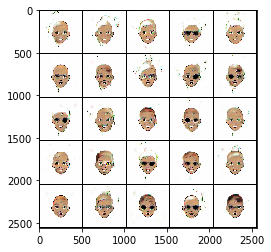

Epoch 29/50 Step 17710... Discriminator Loss: 0.3507... Generator Loss: 4.6543
Epoch 29/50 Step 17720... Discriminator Loss: 0.3650... Generator Loss: 4.0998
Epoch 29/50 Step 17730... Discriminator Loss: 0.4876... Generator Loss: 2.8925
Epoch 29/50 Step 17740... Discriminator Loss: 0.3506... Generator Loss: 4.3173
Epoch 29/50 Step 17750... Discriminator Loss: 0.3767... Generator Loss: 3.8801
Epoch 29/50 Step 17760... Discriminator Loss: 0.3603... Generator Loss: 4.3673
Epoch 29/50 Step 17770... Discriminator Loss: 0.3770... Generator Loss: 3.5185
Epoch 29/50 Step 17780... Discriminator Loss: 0.3826... Generator Loss: 3.5826
Epoch 29/50 Step 17790... Discriminator Loss: 0.4018... Generator Loss: 3.4834
Epoch 29/50 Step 17800... Discriminator Loss: 0.4690... Generator Loss: 7.2730


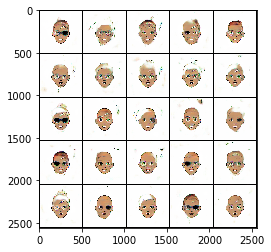

Epoch 29/50 Step 17810... Discriminator Loss: 0.3994... Generator Loss: 4.0129
Epoch 29/50 Step 17820... Discriminator Loss: 0.3517... Generator Loss: 4.5590
Epoch 29/50 Step 17830... Discriminator Loss: 0.3720... Generator Loss: 4.2880
Epoch 29/50 Step 17840... Discriminator Loss: 0.3667... Generator Loss: 4.9056
Epoch 29/50 Step 17850... Discriminator Loss: 0.3770... Generator Loss: 4.7493
Epoch 29/50 Step 17860... Discriminator Loss: 0.3777... Generator Loss: 3.9300
Epoch 29/50 Step 17870... Discriminator Loss: 0.3535... Generator Loss: 4.6679
Epoch 29/50 Step 17880... Discriminator Loss: 0.3542... Generator Loss: 4.3583
Epoch 29/50 Step 17890... Discriminator Loss: 0.3533... Generator Loss: 4.0341
Epoch 29/50 Step 17900... Discriminator Loss: 0.3635... Generator Loss: 5.0978


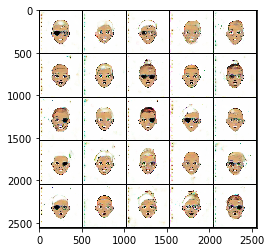

Epoch 29/50 Step 17910... Discriminator Loss: 0.3454... Generator Loss: 4.6163
Epoch 29/50 Step 17920... Discriminator Loss: 0.3501... Generator Loss: 5.1408
Epoch 29/50 Step 17930... Discriminator Loss: 0.4983... Generator Loss: 2.5000
Epoch 29/50 Step 17940... Discriminator Loss: 0.3754... Generator Loss: 4.2980
Epoch 29/50 Step 17950... Discriminator Loss: 0.3580... Generator Loss: 4.4891
Epoch 29/50 Step 17960... Discriminator Loss: 0.3445... Generator Loss: 5.1185
Epoch 29/50 Step 17970... Discriminator Loss: 0.3564... Generator Loss: 5.0401
Epoch 29/50 Step 17980... Discriminator Loss: 0.3519... Generator Loss: 4.9360
Epoch 29/50 Step 17990... Discriminator Loss: 0.3662... Generator Loss: 5.1580
Epoch 29/50 Step 18000... Discriminator Loss: 0.3767... Generator Loss: 4.0133


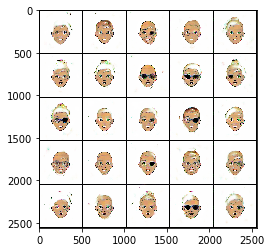

Epoch 29/50 Step 18010... Discriminator Loss: 0.3407... Generator Loss: 4.9064
Epoch 29/50 Step 18020... Discriminator Loss: 0.3880... Generator Loss: 3.5566
Epoch 29/50 Step 18030... Discriminator Loss: 0.3574... Generator Loss: 4.7500
Epoch 29/50 Step 18040... Discriminator Loss: 0.3534... Generator Loss: 4.7572
Epoch 29/50 Step 18050... Discriminator Loss: 0.3710... Generator Loss: 4.7376
Epoch 29/50 Step 18060... Discriminator Loss: 0.3930... Generator Loss: 3.7001
Epoch 29/50 Step 18070... Discriminator Loss: 0.3993... Generator Loss: 5.5643
Epoch 29/50 Step 18080... Discriminator Loss: 0.3565... Generator Loss: 4.5887
Epoch 29/50 Step 18090... Discriminator Loss: 0.3550... Generator Loss: 5.2267
Epoch 29/50 Step 18100... Discriminator Loss: 0.3414... Generator Loss: 5.4340


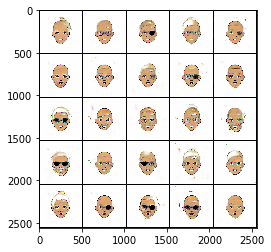

Epoch 29/50 Step 18110... Discriminator Loss: 0.3541... Generator Loss: 4.7734
Epoch 29/50 Step 18120... Discriminator Loss: 0.3542... Generator Loss: 4.3444
Epoch 30/50 Step 18130... Discriminator Loss: 0.3441... Generator Loss: 5.3315
Epoch 30/50 Step 18140... Discriminator Loss: 0.3446... Generator Loss: 5.0058
Epoch 30/50 Step 18150... Discriminator Loss: 0.6755... Generator Loss: 2.4762
Epoch 30/50 Step 18160... Discriminator Loss: 0.3465... Generator Loss: 5.1026
Epoch 30/50 Step 18170... Discriminator Loss: 0.3700... Generator Loss: 5.5186
Epoch 30/50 Step 18180... Discriminator Loss: 0.3474... Generator Loss: 4.9475
Epoch 30/50 Step 18190... Discriminator Loss: 0.3566... Generator Loss: 4.6438
Epoch 30/50 Step 18200... Discriminator Loss: 0.3460... Generator Loss: 4.6826


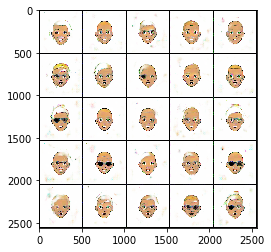

Epoch 30/50 Step 18210... Discriminator Loss: 0.3701... Generator Loss: 4.2397
Epoch 30/50 Step 18220... Discriminator Loss: 0.3491... Generator Loss: 4.9286
Epoch 30/50 Step 18230... Discriminator Loss: 0.3468... Generator Loss: 5.2947
Epoch 30/50 Step 18240... Discriminator Loss: 0.3521... Generator Loss: 4.9290
Epoch 30/50 Step 18250... Discriminator Loss: 0.3475... Generator Loss: 4.2934
Epoch 30/50 Step 18260... Discriminator Loss: 0.3571... Generator Loss: 4.1333
Epoch 30/50 Step 18270... Discriminator Loss: 0.3705... Generator Loss: 4.7733
Epoch 30/50 Step 18280... Discriminator Loss: 0.3837... Generator Loss: 4.9821
Epoch 30/50 Step 18290... Discriminator Loss: 0.3997... Generator Loss: 3.7855
Epoch 30/50 Step 18300... Discriminator Loss: 0.3495... Generator Loss: 4.9834


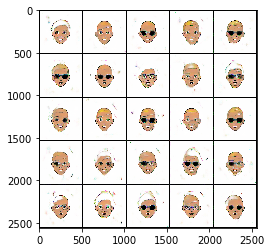

Epoch 30/50 Step 18310... Discriminator Loss: 0.3931... Generator Loss: 4.8503
Epoch 30/50 Step 18320... Discriminator Loss: 0.3917... Generator Loss: 3.7980
Epoch 30/50 Step 18330... Discriminator Loss: 0.3567... Generator Loss: 5.3991
Epoch 30/50 Step 18340... Discriminator Loss: 0.3447... Generator Loss: 5.1209
Epoch 30/50 Step 18350... Discriminator Loss: 0.3582... Generator Loss: 4.3538
Epoch 30/50 Step 18360... Discriminator Loss: 0.3426... Generator Loss: 4.4695
Epoch 30/50 Step 18370... Discriminator Loss: 0.3741... Generator Loss: 4.3307
Epoch 30/50 Step 18380... Discriminator Loss: 0.3456... Generator Loss: 4.9544
Epoch 30/50 Step 18390... Discriminator Loss: 0.3699... Generator Loss: 3.9140
Epoch 30/50 Step 18400... Discriminator Loss: 0.3583... Generator Loss: 4.5504


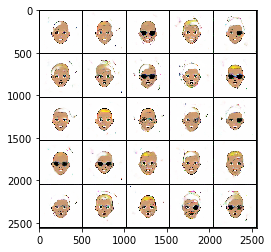

Epoch 30/50 Step 18410... Discriminator Loss: 0.3419... Generator Loss: 4.5816
Epoch 30/50 Step 18420... Discriminator Loss: 0.3743... Generator Loss: 5.7495
Epoch 30/50 Step 18430... Discriminator Loss: 0.3508... Generator Loss: 5.2926
Epoch 30/50 Step 18440... Discriminator Loss: 0.3545... Generator Loss: 5.3477
Epoch 30/50 Step 18450... Discriminator Loss: 0.3492... Generator Loss: 4.7180
Epoch 30/50 Step 18460... Discriminator Loss: 0.3525... Generator Loss: 4.8168
Epoch 30/50 Step 18470... Discriminator Loss: 0.3544... Generator Loss: 4.3143
Epoch 30/50 Step 18480... Discriminator Loss: 0.3551... Generator Loss: 4.0871
Epoch 30/50 Step 18490... Discriminator Loss: 0.3502... Generator Loss: 4.8189
Epoch 30/50 Step 18500... Discriminator Loss: 0.3423... Generator Loss: 5.2294


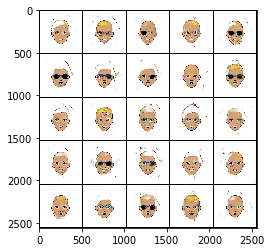

Epoch 30/50 Step 18510... Discriminator Loss: 0.3417... Generator Loss: 4.9805
Epoch 30/50 Step 18520... Discriminator Loss: 0.3786... Generator Loss: 3.9885
Epoch 30/50 Step 18530... Discriminator Loss: 0.3403... Generator Loss: 5.5930
Epoch 30/50 Step 18540... Discriminator Loss: 0.4777... Generator Loss: 3.1363
Epoch 30/50 Step 18550... Discriminator Loss: 5.3411... Generator Loss: 14.3174
Epoch 30/50 Step 18560... Discriminator Loss: 1.1365... Generator Loss: 7.3503
Epoch 30/50 Step 18570... Discriminator Loss: 0.4763... Generator Loss: 5.8863
Epoch 30/50 Step 18580... Discriminator Loss: 0.5518... Generator Loss: 3.2539
Epoch 30/50 Step 18590... Discriminator Loss: 0.4273... Generator Loss: 4.1284
Epoch 30/50 Step 18600... Discriminator Loss: 0.9633... Generator Loss: 1.2025


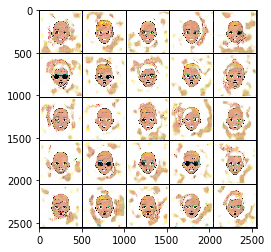

Epoch 30/50 Step 18610... Discriminator Loss: 0.3895... Generator Loss: 4.3868
Epoch 30/50 Step 18620... Discriminator Loss: 0.4586... Generator Loss: 2.7806
Epoch 30/50 Step 18630... Discriminator Loss: 0.4144... Generator Loss: 3.5542
Epoch 30/50 Step 18640... Discriminator Loss: 0.3622... Generator Loss: 4.2974
Epoch 30/50 Step 18650... Discriminator Loss: 0.4006... Generator Loss: 3.3840
Epoch 30/50 Step 18660... Discriminator Loss: 0.3702... Generator Loss: 4.0203
Epoch 30/50 Step 18670... Discriminator Loss: 0.3555... Generator Loss: 4.4786
Epoch 30/50 Step 18680... Discriminator Loss: 0.3684... Generator Loss: 4.2078
Epoch 30/50 Step 18690... Discriminator Loss: 0.3703... Generator Loss: 4.3686
Epoch 30/50 Step 18700... Discriminator Loss: 0.3658... Generator Loss: 4.6097


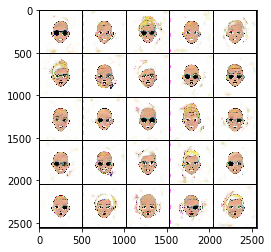

Epoch 30/50 Step 18710... Discriminator Loss: 0.3560... Generator Loss: 4.0614
Epoch 30/50 Step 18720... Discriminator Loss: 0.3661... Generator Loss: 3.6922
Epoch 30/50 Step 18730... Discriminator Loss: 0.3786... Generator Loss: 4.1703
Epoch 30/50 Step 18740... Discriminator Loss: 0.3523... Generator Loss: 4.6042
Epoch 30/50 Step 18750... Discriminator Loss: 0.4353... Generator Loss: 3.1691
Epoch 31/50 Step 18760... Discriminator Loss: 0.3489... Generator Loss: 5.4101
Epoch 31/50 Step 18770... Discriminator Loss: 0.7557... Generator Loss: 1.6079
Epoch 31/50 Step 18780... Discriminator Loss: 0.3566... Generator Loss: 4.1936
Epoch 31/50 Step 18790... Discriminator Loss: 0.3697... Generator Loss: 4.5088
Epoch 31/50 Step 18800... Discriminator Loss: 0.3652... Generator Loss: 4.2245


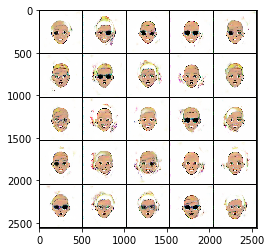

Epoch 31/50 Step 18810... Discriminator Loss: 0.3527... Generator Loss: 4.7428
Epoch 31/50 Step 18820... Discriminator Loss: 0.3762... Generator Loss: 3.8215
Epoch 31/50 Step 18830... Discriminator Loss: 0.3684... Generator Loss: 4.0620
Epoch 31/50 Step 18840... Discriminator Loss: 0.3440... Generator Loss: 4.8223
Epoch 31/50 Step 18850... Discriminator Loss: 0.3471... Generator Loss: 4.8603
Epoch 31/50 Step 18860... Discriminator Loss: 0.3455... Generator Loss: 4.6155
Epoch 31/50 Step 18870... Discriminator Loss: 0.3483... Generator Loss: 4.7697
Epoch 31/50 Step 18880... Discriminator Loss: 0.3802... Generator Loss: 3.7134
Epoch 31/50 Step 18890... Discriminator Loss: 0.3678... Generator Loss: 3.9633
Epoch 31/50 Step 18900... Discriminator Loss: 0.3885... Generator Loss: 3.6431


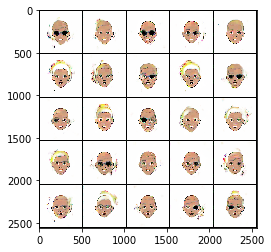

Epoch 31/50 Step 18910... Discriminator Loss: 0.3572... Generator Loss: 4.8002
Epoch 31/50 Step 18920... Discriminator Loss: 0.4051... Generator Loss: 6.0231
Epoch 31/50 Step 18930... Discriminator Loss: 0.4969... Generator Loss: 2.9923
Epoch 31/50 Step 18940... Discriminator Loss: 0.3485... Generator Loss: 5.3196
Epoch 31/50 Step 18950... Discriminator Loss: 0.3542... Generator Loss: 4.5120
Epoch 31/50 Step 18960... Discriminator Loss: 0.3423... Generator Loss: 4.8672
Epoch 31/50 Step 18970... Discriminator Loss: 0.3517... Generator Loss: 4.6692
Epoch 31/50 Step 18980... Discriminator Loss: 0.3613... Generator Loss: 4.6115
Epoch 31/50 Step 18990... Discriminator Loss: 0.3538... Generator Loss: 4.3858
Epoch 31/50 Step 19000... Discriminator Loss: 0.3500... Generator Loss: 4.6228


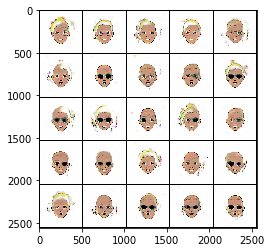

Epoch 31/50 Step 19010... Discriminator Loss: 0.3402... Generator Loss: 5.1243
Epoch 31/50 Step 19020... Discriminator Loss: 0.3410... Generator Loss: 4.7100
Epoch 31/50 Step 19030... Discriminator Loss: 0.4077... Generator Loss: 3.7757
Epoch 31/50 Step 19040... Discriminator Loss: 0.3832... Generator Loss: 4.4190
Epoch 31/50 Step 19050... Discriminator Loss: 0.3407... Generator Loss: 5.4520
Epoch 31/50 Step 19060... Discriminator Loss: 0.3547... Generator Loss: 5.0990
Epoch 31/50 Step 19070... Discriminator Loss: 0.3914... Generator Loss: 5.8072
Epoch 31/50 Step 19080... Discriminator Loss: 0.5453... Generator Loss: 3.4077
Epoch 31/50 Step 19090... Discriminator Loss: 0.3536... Generator Loss: 5.3403
Epoch 31/50 Step 19100... Discriminator Loss: 0.3482... Generator Loss: 4.9955


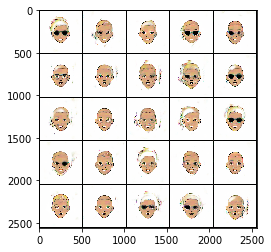

Epoch 31/50 Step 19110... Discriminator Loss: 0.3431... Generator Loss: 5.0594
Epoch 31/50 Step 19120... Discriminator Loss: 0.3378... Generator Loss: 5.3469
Epoch 31/50 Step 19130... Discriminator Loss: 0.3485... Generator Loss: 5.3797
Epoch 31/50 Step 19140... Discriminator Loss: 0.3414... Generator Loss: 4.9972
Epoch 31/50 Step 19150... Discriminator Loss: 0.3431... Generator Loss: 5.0827
Epoch 31/50 Step 19160... Discriminator Loss: 0.3421... Generator Loss: 5.5118
Epoch 31/50 Step 19170... Discriminator Loss: 0.3477... Generator Loss: 5.2218
Epoch 31/50 Step 19180... Discriminator Loss: 1.9947... Generator Loss: 0.5491
Epoch 31/50 Step 19190... Discriminator Loss: 0.6344... Generator Loss: 3.2283
Epoch 31/50 Step 19200... Discriminator Loss: 0.3905... Generator Loss: 4.1804


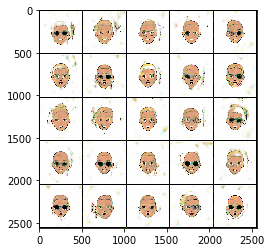

Epoch 31/50 Step 19210... Discriminator Loss: 0.3806... Generator Loss: 3.6304
Epoch 31/50 Step 19220... Discriminator Loss: 0.3780... Generator Loss: 4.4684
Epoch 31/50 Step 19230... Discriminator Loss: 0.3605... Generator Loss: 4.2757
Epoch 31/50 Step 19240... Discriminator Loss: 0.3711... Generator Loss: 4.7776
Epoch 31/50 Step 19250... Discriminator Loss: 0.3808... Generator Loss: 3.8168
Epoch 31/50 Step 19260... Discriminator Loss: 0.3505... Generator Loss: 4.8071
Epoch 31/50 Step 19270... Discriminator Loss: 0.3641... Generator Loss: 3.9882
Epoch 31/50 Step 19280... Discriminator Loss: 0.3772... Generator Loss: 3.7184
Epoch 31/50 Step 19290... Discriminator Loss: 0.3545... Generator Loss: 5.0231
Epoch 31/50 Step 19300... Discriminator Loss: 0.3419... Generator Loss: 5.3014


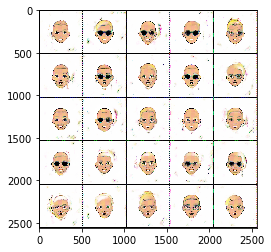

Epoch 31/50 Step 19310... Discriminator Loss: 0.3775... Generator Loss: 4.0465
Epoch 31/50 Step 19320... Discriminator Loss: 0.3563... Generator Loss: 4.9629
Epoch 31/50 Step 19330... Discriminator Loss: 0.3474... Generator Loss: 5.0468
Epoch 31/50 Step 19340... Discriminator Loss: 0.3424... Generator Loss: 5.7588
Epoch 31/50 Step 19350... Discriminator Loss: 0.3452... Generator Loss: 5.2809
Epoch 31/50 Step 19360... Discriminator Loss: 0.3539... Generator Loss: 4.8822
Epoch 31/50 Step 19370... Discriminator Loss: 0.3395... Generator Loss: 4.9460
Epoch 32/50 Step 19380... Discriminator Loss: 0.3582... Generator Loss: 5.8979
Epoch 32/50 Step 19390... Discriminator Loss: 0.3375... Generator Loss: 5.4722
Epoch 32/50 Step 19400... Discriminator Loss: 0.4180... Generator Loss: 6.0594


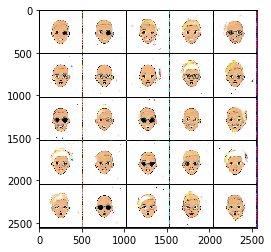

Epoch 32/50 Step 19410... Discriminator Loss: 0.3615... Generator Loss: 4.6845
Epoch 32/50 Step 19420... Discriminator Loss: 0.3518... Generator Loss: 5.9549
Epoch 32/50 Step 19430... Discriminator Loss: 0.3458... Generator Loss: 5.9860
Epoch 32/50 Step 19440... Discriminator Loss: 0.3540... Generator Loss: 4.5776
Epoch 32/50 Step 19450... Discriminator Loss: 0.3501... Generator Loss: 4.9035
Epoch 32/50 Step 19460... Discriminator Loss: 0.3638... Generator Loss: 4.5210
Epoch 32/50 Step 19470... Discriminator Loss: 0.3603... Generator Loss: 5.9056
Epoch 32/50 Step 19480... Discriminator Loss: 0.3517... Generator Loss: 5.0360
Epoch 32/50 Step 19490... Discriminator Loss: 0.3421... Generator Loss: 4.8060
Epoch 32/50 Step 19500... Discriminator Loss: 0.3438... Generator Loss: 5.0156


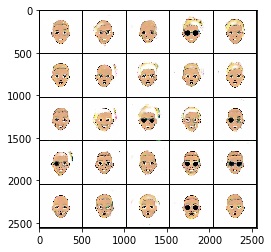

Epoch 32/50 Step 19510... Discriminator Loss: 0.3497... Generator Loss: 4.5645
Epoch 32/50 Step 19520... Discriminator Loss: 0.3514... Generator Loss: 5.1983
Epoch 32/50 Step 19530... Discriminator Loss: 0.3643... Generator Loss: 4.7272
Epoch 32/50 Step 19540... Discriminator Loss: 0.8193... Generator Loss: 1.9935
Epoch 32/50 Step 19550... Discriminator Loss: 0.3557... Generator Loss: 5.0591
Epoch 32/50 Step 19560... Discriminator Loss: 0.3492... Generator Loss: 5.1670
Epoch 32/50 Step 19570... Discriminator Loss: 0.3693... Generator Loss: 4.4324
Epoch 32/50 Step 19580... Discriminator Loss: 0.3570... Generator Loss: 6.6151
Epoch 32/50 Step 19590... Discriminator Loss: 0.3541... Generator Loss: 5.7548
Epoch 32/50 Step 19600... Discriminator Loss: 0.3539... Generator Loss: 4.9080


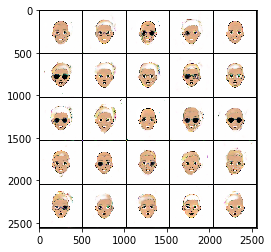

Epoch 32/50 Step 19610... Discriminator Loss: 0.3395... Generator Loss: 5.2407
Epoch 32/50 Step 19620... Discriminator Loss: 0.3562... Generator Loss: 4.9436
Epoch 32/50 Step 19630... Discriminator Loss: 0.3357... Generator Loss: 6.0934
Epoch 32/50 Step 19640... Discriminator Loss: 0.3436... Generator Loss: 4.9368
Epoch 32/50 Step 19650... Discriminator Loss: 0.3342... Generator Loss: 5.7459
Epoch 32/50 Step 19660... Discriminator Loss: 0.3388... Generator Loss: 5.4743
Epoch 32/50 Step 19670... Discriminator Loss: 0.3434... Generator Loss: 6.0351
Epoch 32/50 Step 19680... Discriminator Loss: 0.3468... Generator Loss: 5.3636
Epoch 32/50 Step 19690... Discriminator Loss: 0.3373... Generator Loss: 5.8154
Epoch 32/50 Step 19700... Discriminator Loss: 0.4300... Generator Loss: 3.7370


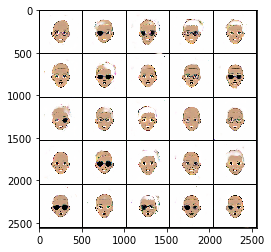

Epoch 32/50 Step 19710... Discriminator Loss: 0.4237... Generator Loss: 6.3447
Epoch 32/50 Step 19720... Discriminator Loss: 0.3600... Generator Loss: 5.1603
Epoch 32/50 Step 19730... Discriminator Loss: 0.3539... Generator Loss: 4.8151
Epoch 32/50 Step 19740... Discriminator Loss: 0.3533... Generator Loss: 4.9159
Epoch 32/50 Step 19750... Discriminator Loss: 0.3519... Generator Loss: 4.9940
Epoch 32/50 Step 19760... Discriminator Loss: 0.3545... Generator Loss: 5.1827
Epoch 32/50 Step 19770... Discriminator Loss: 0.3610... Generator Loss: 4.8331
Epoch 32/50 Step 19780... Discriminator Loss: 0.3439... Generator Loss: 5.3624
Epoch 32/50 Step 19790... Discriminator Loss: 0.3335... Generator Loss: 5.6498
Epoch 32/50 Step 19800... Discriminator Loss: 0.3380... Generator Loss: 5.5151


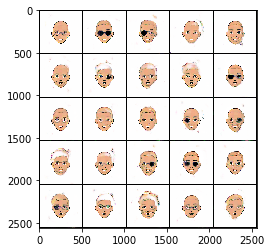

Epoch 32/50 Step 19810... Discriminator Loss: 0.4134... Generator Loss: 7.2489
Epoch 32/50 Step 19820... Discriminator Loss: 0.3388... Generator Loss: 5.8184
Epoch 32/50 Step 19830... Discriminator Loss: 0.3405... Generator Loss: 5.5112
Epoch 32/50 Step 19840... Discriminator Loss: 0.3413... Generator Loss: 5.4837
Epoch 32/50 Step 19850... Discriminator Loss: 0.3651... Generator Loss: 4.8517
Epoch 32/50 Step 19860... Discriminator Loss: 0.3392... Generator Loss: 5.5166
Epoch 32/50 Step 19870... Discriminator Loss: 0.3350... Generator Loss: 5.7126
Epoch 32/50 Step 19880... Discriminator Loss: 0.3807... Generator Loss: 3.9432
Epoch 32/50 Step 19890... Discriminator Loss: 0.3656... Generator Loss: 4.7704
Epoch 32/50 Step 19900... Discriminator Loss: 0.3535... Generator Loss: 5.0080


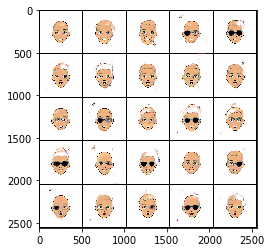

Epoch 32/50 Step 19910... Discriminator Loss: 0.3358... Generator Loss: 5.6477
Epoch 32/50 Step 19920... Discriminator Loss: 0.3347... Generator Loss: 5.5280
Epoch 32/50 Step 19930... Discriminator Loss: 0.3488... Generator Loss: 4.6985
Epoch 32/50 Step 19940... Discriminator Loss: 0.3415... Generator Loss: 5.8665
Epoch 32/50 Step 19950... Discriminator Loss: 0.3372... Generator Loss: 5.8818
Epoch 32/50 Step 19960... Discriminator Loss: 0.3392... Generator Loss: 5.4251
Epoch 32/50 Step 19970... Discriminator Loss: 0.3511... Generator Loss: 4.7003
Epoch 32/50 Step 19980... Discriminator Loss: 0.3452... Generator Loss: 5.2250
Epoch 32/50 Step 19990... Discriminator Loss: 0.3412... Generator Loss: 5.3214
Epoch 32/50 Step 20000... Discriminator Loss: 0.3478... Generator Loss: 5.1603


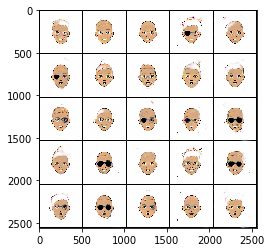

Epoch 33/50 Step 20010... Discriminator Loss: 0.3709... Generator Loss: 5.8796
Epoch 33/50 Step 20020... Discriminator Loss: 1.9520... Generator Loss: 9.0231
Epoch 33/50 Step 20030... Discriminator Loss: 0.7407... Generator Loss: 5.0742
Epoch 33/50 Step 20040... Discriminator Loss: 0.4202... Generator Loss: 5.0315
Epoch 33/50 Step 20050... Discriminator Loss: 0.4371... Generator Loss: 3.4534
Epoch 33/50 Step 20060... Discriminator Loss: 0.4024... Generator Loss: 3.6757
Epoch 33/50 Step 20070... Discriminator Loss: 0.4093... Generator Loss: 3.9482
Epoch 33/50 Step 20080... Discriminator Loss: 0.4196... Generator Loss: 3.4532
Epoch 33/50 Step 20090... Discriminator Loss: 0.3619... Generator Loss: 4.6276
Epoch 33/50 Step 20100... Discriminator Loss: 0.3885... Generator Loss: 3.5660


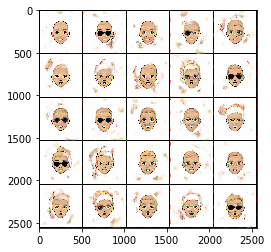

Epoch 33/50 Step 20110... Discriminator Loss: 0.3549... Generator Loss: 4.6067
Epoch 33/50 Step 20120... Discriminator Loss: 0.3585... Generator Loss: 4.3577
Epoch 33/50 Step 20130... Discriminator Loss: 0.4883... Generator Loss: 2.6120
Epoch 33/50 Step 20140... Discriminator Loss: 0.3503... Generator Loss: 4.6108
Epoch 33/50 Step 20150... Discriminator Loss: 0.4004... Generator Loss: 3.7185
Epoch 33/50 Step 20160... Discriminator Loss: 0.3656... Generator Loss: 4.3437
Epoch 33/50 Step 20170... Discriminator Loss: 0.3496... Generator Loss: 4.7745
Epoch 33/50 Step 20180... Discriminator Loss: 0.3981... Generator Loss: 3.6879
Epoch 33/50 Step 20190... Discriminator Loss: 0.3550... Generator Loss: 4.7881
Epoch 33/50 Step 20200... Discriminator Loss: 0.5577... Generator Loss: 2.5422


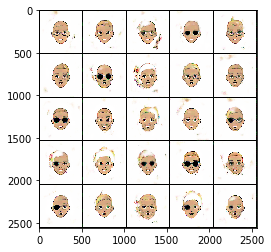

Epoch 33/50 Step 20210... Discriminator Loss: 0.3477... Generator Loss: 4.4800
Epoch 33/50 Step 20220... Discriminator Loss: 0.3539... Generator Loss: 4.4222
Epoch 33/50 Step 20230... Discriminator Loss: 0.3442... Generator Loss: 5.1925
Epoch 33/50 Step 20240... Discriminator Loss: 0.3518... Generator Loss: 4.3002
Epoch 33/50 Step 20250... Discriminator Loss: 0.3428... Generator Loss: 5.1781
Epoch 33/50 Step 20260... Discriminator Loss: 0.3394... Generator Loss: 5.1522
Epoch 33/50 Step 20270... Discriminator Loss: 0.3368... Generator Loss: 5.4822
Epoch 33/50 Step 20280... Discriminator Loss: 0.3486... Generator Loss: 4.8392
Epoch 33/50 Step 20290... Discriminator Loss: 0.3454... Generator Loss: 5.0017
Epoch 33/50 Step 20300... Discriminator Loss: 0.3427... Generator Loss: 5.0999


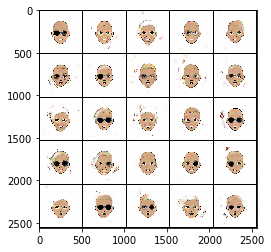

Epoch 33/50 Step 20310... Discriminator Loss: 0.3471... Generator Loss: 4.9134
Epoch 33/50 Step 20320... Discriminator Loss: 0.3732... Generator Loss: 6.0459
Epoch 33/50 Step 20330... Discriminator Loss: 0.4067... Generator Loss: 5.7946
Epoch 33/50 Step 20340... Discriminator Loss: 0.3427... Generator Loss: 5.1945
Epoch 33/50 Step 20350... Discriminator Loss: 0.3381... Generator Loss: 5.4540
Epoch 33/50 Step 20360... Discriminator Loss: 0.3731... Generator Loss: 3.9759
Epoch 33/50 Step 20370... Discriminator Loss: 0.3611... Generator Loss: 4.8131
Epoch 33/50 Step 20380... Discriminator Loss: 0.3415... Generator Loss: 5.1316
Epoch 33/50 Step 20390... Discriminator Loss: 0.3389... Generator Loss: 5.2931
Epoch 33/50 Step 20400... Discriminator Loss: 0.3518... Generator Loss: 5.1758


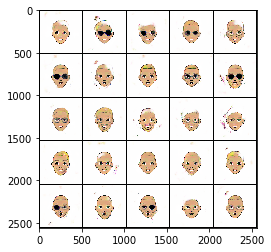

Epoch 33/50 Step 20410... Discriminator Loss: 0.3519... Generator Loss: 5.4832
Epoch 33/50 Step 20420... Discriminator Loss: 0.3411... Generator Loss: 5.8206
Epoch 33/50 Step 20430... Discriminator Loss: 0.6558... Generator Loss: 2.3185
Epoch 33/50 Step 20440... Discriminator Loss: 0.3651... Generator Loss: 4.8719
Epoch 33/50 Step 20450... Discriminator Loss: 0.3404... Generator Loss: 5.2673
Epoch 33/50 Step 20460... Discriminator Loss: 0.3392... Generator Loss: 5.5538
Epoch 33/50 Step 20470... Discriminator Loss: 0.3413... Generator Loss: 5.4567
Epoch 33/50 Step 20480... Discriminator Loss: 0.3394... Generator Loss: 5.2861
Epoch 33/50 Step 20490... Discriminator Loss: 0.3550... Generator Loss: 5.7190
Epoch 33/50 Step 20500... Discriminator Loss: 0.3451... Generator Loss: 5.3049


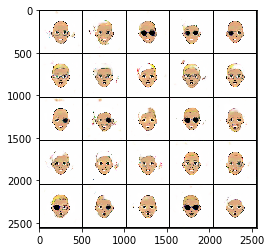

Epoch 33/50 Step 20510... Discriminator Loss: 0.3344... Generator Loss: 6.0563
Epoch 33/50 Step 20520... Discriminator Loss: 0.3417... Generator Loss: 5.4374
Epoch 33/50 Step 20530... Discriminator Loss: 0.3560... Generator Loss: 5.9145
Epoch 33/50 Step 20540... Discriminator Loss: 0.3450... Generator Loss: 5.1052
Epoch 33/50 Step 20550... Discriminator Loss: 0.3433... Generator Loss: 5.6677
Epoch 33/50 Step 20560... Discriminator Loss: 0.3620... Generator Loss: 4.6091
Epoch 33/50 Step 20570... Discriminator Loss: 0.3542... Generator Loss: 6.1427
Epoch 33/50 Step 20580... Discriminator Loss: 0.3464... Generator Loss: 4.7566
Epoch 33/50 Step 20590... Discriminator Loss: 0.3391... Generator Loss: 5.1955
Epoch 33/50 Step 20600... Discriminator Loss: 0.3468... Generator Loss: 5.9844


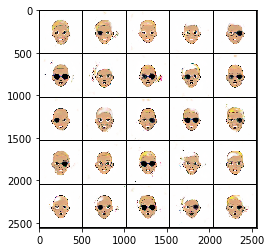

Epoch 33/50 Step 20610... Discriminator Loss: 0.3506... Generator Loss: 5.1605
Epoch 33/50 Step 20620... Discriminator Loss: 0.3364... Generator Loss: 5.4287
Epoch 34/50 Step 20630... Discriminator Loss: 0.3406... Generator Loss: 5.6238
Epoch 34/50 Step 20640... Discriminator Loss: 0.3338... Generator Loss: 5.6772
Epoch 34/50 Step 20650... Discriminator Loss: 0.4488... Generator Loss: 7.0360
Epoch 34/50 Step 20660... Discriminator Loss: 0.3925... Generator Loss: 5.0514
Epoch 34/50 Step 20670... Discriminator Loss: 0.3390... Generator Loss: 5.9800
Epoch 34/50 Step 20680... Discriminator Loss: 0.3368... Generator Loss: 5.8233
Epoch 34/50 Step 20690... Discriminator Loss: 0.3420... Generator Loss: 4.8698
Epoch 34/50 Step 20700... Discriminator Loss: 0.3508... Generator Loss: 4.9898


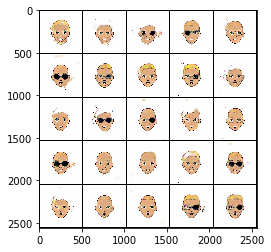

Epoch 34/50 Step 20710... Discriminator Loss: 0.3466... Generator Loss: 4.7513
Epoch 34/50 Step 20720... Discriminator Loss: 0.3406... Generator Loss: 5.8685
Epoch 34/50 Step 20730... Discriminator Loss: 0.3386... Generator Loss: 6.1153
Epoch 34/50 Step 20740... Discriminator Loss: 0.3372... Generator Loss: 5.3760
Epoch 34/50 Step 20750... Discriminator Loss: 0.3347... Generator Loss: 5.5601
Epoch 34/50 Step 20760... Discriminator Loss: 0.3361... Generator Loss: 5.8821
Epoch 34/50 Step 20770... Discriminator Loss: 0.3406... Generator Loss: 5.5841
Epoch 34/50 Step 20780... Discriminator Loss: 0.3658... Generator Loss: 6.5633
Epoch 34/50 Step 20790... Discriminator Loss: 0.8110... Generator Loss: 2.1439
Epoch 34/50 Step 20800... Discriminator Loss: 0.3533... Generator Loss: 4.7377


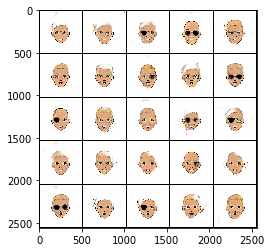

Epoch 34/50 Step 20810... Discriminator Loss: 0.3439... Generator Loss: 5.6713
Epoch 34/50 Step 20820... Discriminator Loss: 0.3425... Generator Loss: 5.6117
Epoch 34/50 Step 20830... Discriminator Loss: 0.3726... Generator Loss: 5.8394
Epoch 34/50 Step 20840... Discriminator Loss: 0.3452... Generator Loss: 6.2155
Epoch 34/50 Step 20850... Discriminator Loss: 0.3488... Generator Loss: 4.9120
Epoch 34/50 Step 20860... Discriminator Loss: 0.3388... Generator Loss: 5.7766
Epoch 34/50 Step 20870... Discriminator Loss: 0.3426... Generator Loss: 5.1674
Epoch 34/50 Step 20880... Discriminator Loss: 0.3409... Generator Loss: 6.0017
Epoch 34/50 Step 20890... Discriminator Loss: 0.3437... Generator Loss: 5.1857
Epoch 34/50 Step 20900... Discriminator Loss: 0.3396... Generator Loss: 6.1082


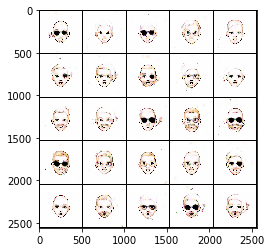

Epoch 34/50 Step 20910... Discriminator Loss: 0.3411... Generator Loss: 5.3474
Epoch 34/50 Step 20920... Discriminator Loss: 0.3350... Generator Loss: 5.4355
Epoch 34/50 Step 20930... Discriminator Loss: 0.3395... Generator Loss: 5.5637
Epoch 34/50 Step 20940... Discriminator Loss: 0.3404... Generator Loss: 6.4346
Epoch 34/50 Step 20950... Discriminator Loss: 0.3923... Generator Loss: 4.6842
Epoch 34/50 Step 20960... Discriminator Loss: 2.1004... Generator Loss: 1.2795
Epoch 34/50 Step 20970... Discriminator Loss: 65.5875... Generator Loss: 0.0000
Epoch 34/50 Step 20980... Discriminator Loss: 3.3710... Generator Loss: 5.7794
Epoch 34/50 Step 20990... Discriminator Loss: 2.2185... Generator Loss: 7.0999
Epoch 34/50 Step 21000... Discriminator Loss: 1.1522... Generator Loss: 2.5193


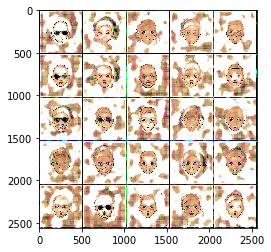

Epoch 34/50 Step 21010... Discriminator Loss: 1.0004... Generator Loss: 3.2452
Epoch 34/50 Step 21020... Discriminator Loss: 0.7390... Generator Loss: 2.3500
Epoch 34/50 Step 21030... Discriminator Loss: 0.4974... Generator Loss: 4.1574
Epoch 34/50 Step 21040... Discriminator Loss: 0.5172... Generator Loss: 3.8394
Epoch 34/50 Step 21050... Discriminator Loss: 0.5763... Generator Loss: 1.9930
Epoch 34/50 Step 21060... Discriminator Loss: 0.6040... Generator Loss: 2.2868
Epoch 34/50 Step 21070... Discriminator Loss: 0.4624... Generator Loss: 2.8598
Epoch 34/50 Step 21080... Discriminator Loss: 0.6693... Generator Loss: 1.9648
Epoch 34/50 Step 21090... Discriminator Loss: 0.5036... Generator Loss: 4.5358
Epoch 34/50 Step 21100... Discriminator Loss: 0.6389... Generator Loss: 1.9385


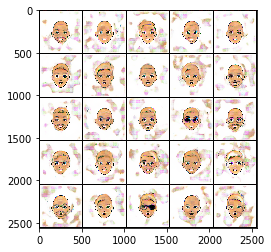

Epoch 34/50 Step 21110... Discriminator Loss: 0.5580... Generator Loss: 4.4054
Epoch 34/50 Step 21120... Discriminator Loss: 0.4469... Generator Loss: 3.4426
Epoch 34/50 Step 21130... Discriminator Loss: 0.5332... Generator Loss: 2.3201
Epoch 34/50 Step 21140... Discriminator Loss: 0.4157... Generator Loss: 4.9058
Epoch 34/50 Step 21150... Discriminator Loss: 0.5351... Generator Loss: 2.2807
Epoch 34/50 Step 21160... Discriminator Loss: 0.5002... Generator Loss: 2.6207
Epoch 34/50 Step 21170... Discriminator Loss: 0.4463... Generator Loss: 3.3573
Epoch 34/50 Step 21180... Discriminator Loss: 0.3934... Generator Loss: 3.4849
Epoch 34/50 Step 21190... Discriminator Loss: 0.4294... Generator Loss: 3.1128
Epoch 34/50 Step 21200... Discriminator Loss: 0.4769... Generator Loss: 3.9554


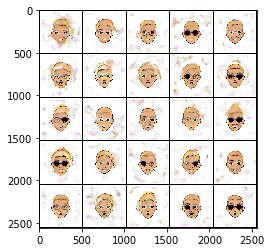

Epoch 34/50 Step 21210... Discriminator Loss: 0.4513... Generator Loss: 2.7666
Epoch 34/50 Step 21220... Discriminator Loss: 0.4730... Generator Loss: 2.4997
Epoch 34/50 Step 21230... Discriminator Loss: 1.8666... Generator Loss: 9.5875
Epoch 34/50 Step 21240... Discriminator Loss: 0.4530... Generator Loss: 4.2770
Epoch 34/50 Step 21250... Discriminator Loss: 0.7107... Generator Loss: 1.6850
Epoch 35/50 Step 21260... Discriminator Loss: 0.4465... Generator Loss: 4.6915
Epoch 35/50 Step 21270... Discriminator Loss: 0.4822... Generator Loss: 3.0844
Epoch 35/50 Step 21280... Discriminator Loss: 0.3738... Generator Loss: 4.6900
Epoch 35/50 Step 21290... Discriminator Loss: 0.4561... Generator Loss: 3.6202
Epoch 35/50 Step 21300... Discriminator Loss: 0.4223... Generator Loss: 3.4732


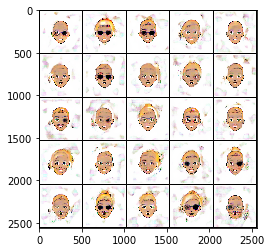

Epoch 35/50 Step 21310... Discriminator Loss: 0.4083... Generator Loss: 3.5593
Epoch 35/50 Step 21320... Discriminator Loss: 0.4002... Generator Loss: 3.2857
Epoch 35/50 Step 21330... Discriminator Loss: 0.4445... Generator Loss: 3.2157
Epoch 35/50 Step 21340... Discriminator Loss: 0.4327... Generator Loss: 3.4399
Epoch 35/50 Step 21350... Discriminator Loss: 0.4073... Generator Loss: 3.3038
Epoch 35/50 Step 21360... Discriminator Loss: 0.3815... Generator Loss: 3.9629
Epoch 35/50 Step 21370... Discriminator Loss: 0.3698... Generator Loss: 4.2441
Epoch 35/50 Step 21380... Discriminator Loss: 0.4448... Generator Loss: 3.0173
Epoch 35/50 Step 21390... Discriminator Loss: 1.3584... Generator Loss: 1.0118
Epoch 35/50 Step 21400... Discriminator Loss: 0.5193... Generator Loss: 2.5939


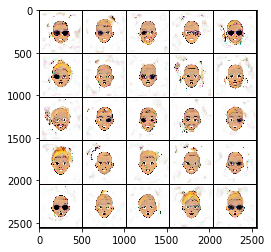

Epoch 35/50 Step 21410... Discriminator Loss: 0.4409... Generator Loss: 3.0620
Epoch 35/50 Step 21420... Discriminator Loss: 0.4212... Generator Loss: 3.2563
Epoch 35/50 Step 21430... Discriminator Loss: 0.3904... Generator Loss: 3.6290
Epoch 35/50 Step 21440... Discriminator Loss: 0.3879... Generator Loss: 3.6647
Epoch 35/50 Step 21450... Discriminator Loss: 0.4436... Generator Loss: 2.8178
Epoch 35/50 Step 21460... Discriminator Loss: 0.3889... Generator Loss: 3.5178
Epoch 35/50 Step 21470... Discriminator Loss: 0.3635... Generator Loss: 3.8565
Epoch 35/50 Step 21480... Discriminator Loss: 0.4066... Generator Loss: 3.4718
Epoch 35/50 Step 21490... Discriminator Loss: 0.4004... Generator Loss: 3.1278
Epoch 35/50 Step 21500... Discriminator Loss: 0.3932... Generator Loss: 3.4904


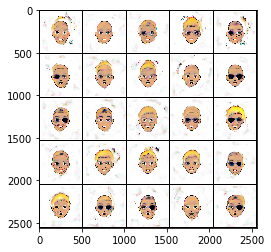

Epoch 35/50 Step 21510... Discriminator Loss: 0.3535... Generator Loss: 4.5555
Epoch 35/50 Step 21520... Discriminator Loss: 0.4030... Generator Loss: 3.5550
Epoch 35/50 Step 21530... Discriminator Loss: 0.3711... Generator Loss: 4.0058
Epoch 35/50 Step 21540... Discriminator Loss: 0.4755... Generator Loss: 3.4572
Epoch 35/50 Step 21550... Discriminator Loss: 0.4141... Generator Loss: 3.6994
Epoch 35/50 Step 21560... Discriminator Loss: 0.3832... Generator Loss: 3.9994
Epoch 35/50 Step 21570... Discriminator Loss: 0.3570... Generator Loss: 3.9027
Epoch 35/50 Step 21580... Discriminator Loss: 0.3714... Generator Loss: 4.3022
Epoch 35/50 Step 21590... Discriminator Loss: 0.3527... Generator Loss: 4.1917
Epoch 35/50 Step 21600... Discriminator Loss: 0.3671... Generator Loss: 4.1203


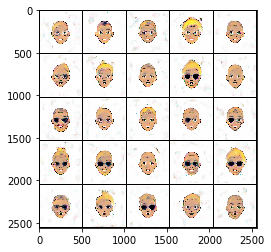

Epoch 35/50 Step 21610... Discriminator Loss: 0.4017... Generator Loss: 3.4098
Epoch 35/50 Step 21620... Discriminator Loss: 0.3688... Generator Loss: 4.4085
Epoch 35/50 Step 21630... Discriminator Loss: 0.3864... Generator Loss: 3.6045
Epoch 35/50 Step 21640... Discriminator Loss: 0.3781... Generator Loss: 3.5980
Epoch 35/50 Step 21650... Discriminator Loss: 0.3655... Generator Loss: 4.8791
Epoch 35/50 Step 21660... Discriminator Loss: 0.3624... Generator Loss: 4.0975
Epoch 35/50 Step 21670... Discriminator Loss: 0.3580... Generator Loss: 4.3461
Epoch 35/50 Step 21680... Discriminator Loss: 0.4710... Generator Loss: 2.6498
Epoch 35/50 Step 21690... Discriminator Loss: 0.4194... Generator Loss: 3.7538
Epoch 35/50 Step 21700... Discriminator Loss: 0.3637... Generator Loss: 4.4107


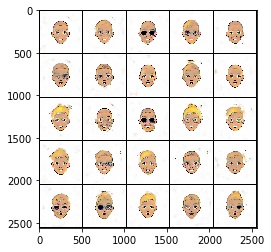

Epoch 35/50 Step 21710... Discriminator Loss: 0.3707... Generator Loss: 4.5268
Epoch 35/50 Step 21720... Discriminator Loss: 0.3597... Generator Loss: 4.7164
Epoch 35/50 Step 21730... Discriminator Loss: 0.3556... Generator Loss: 4.4221
Epoch 35/50 Step 21740... Discriminator Loss: 0.3497... Generator Loss: 4.9404
Epoch 35/50 Step 21750... Discriminator Loss: 0.3593... Generator Loss: 4.6238
Epoch 35/50 Step 21760... Discriminator Loss: 0.3836... Generator Loss: 5.3368
Epoch 35/50 Step 21770... Discriminator Loss: 0.4083... Generator Loss: 3.2519
Epoch 35/50 Step 21780... Discriminator Loss: 0.3645... Generator Loss: 3.8535
Epoch 35/50 Step 21790... Discriminator Loss: 0.3624... Generator Loss: 4.8714
Epoch 35/50 Step 21800... Discriminator Loss: 0.3619... Generator Loss: 4.4513


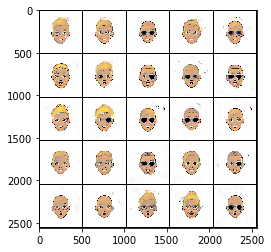

Epoch 35/50 Step 21810... Discriminator Loss: 0.5128... Generator Loss: 3.6886
Epoch 35/50 Step 21820... Discriminator Loss: 0.4028... Generator Loss: 4.1719
Epoch 35/50 Step 21830... Discriminator Loss: 0.4073... Generator Loss: 3.8961
Epoch 35/50 Step 21840... Discriminator Loss: 0.3643... Generator Loss: 4.1723
Epoch 35/50 Step 21850... Discriminator Loss: 0.3565... Generator Loss: 4.5563
Epoch 35/50 Step 21860... Discriminator Loss: 0.3442... Generator Loss: 4.8539
Epoch 35/50 Step 21870... Discriminator Loss: 0.3582... Generator Loss: 4.0927
Epoch 36/50 Step 21880... Discriminator Loss: 0.3469... Generator Loss: 4.5088
Epoch 36/50 Step 21890... Discriminator Loss: 0.3494... Generator Loss: 4.6642
Epoch 36/50 Step 21900... Discriminator Loss: 0.3623... Generator Loss: 4.5271


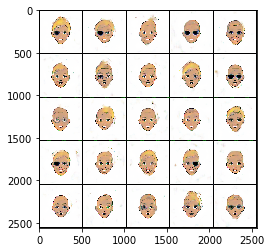

Epoch 36/50 Step 21910... Discriminator Loss: 0.3395... Generator Loss: 4.7262
Epoch 36/50 Step 21920... Discriminator Loss: 0.3482... Generator Loss: 4.9721
Epoch 36/50 Step 21930... Discriminator Loss: 0.3537... Generator Loss: 5.3592
Epoch 36/50 Step 21940... Discriminator Loss: 0.3696... Generator Loss: 3.9421
Epoch 36/50 Step 21950... Discriminator Loss: 0.3511... Generator Loss: 4.7646
Epoch 36/50 Step 21960... Discriminator Loss: 0.3693... Generator Loss: 4.0260
Epoch 36/50 Step 21970... Discriminator Loss: 0.3628... Generator Loss: 5.2222
Epoch 36/50 Step 21980... Discriminator Loss: 0.3520... Generator Loss: 4.6762
Epoch 36/50 Step 21990... Discriminator Loss: 0.3616... Generator Loss: 4.3560
Epoch 36/50 Step 22000... Discriminator Loss: 0.3800... Generator Loss: 3.6702


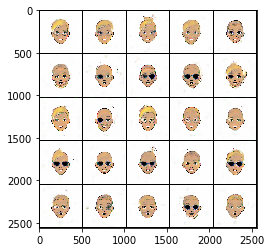

Epoch 36/50 Step 22010... Discriminator Loss: 0.3550... Generator Loss: 4.8868
Epoch 36/50 Step 22020... Discriminator Loss: 0.3622... Generator Loss: 4.4667
Epoch 36/50 Step 22030... Discriminator Loss: 0.3817... Generator Loss: 4.9256
Epoch 36/50 Step 22040... Discriminator Loss: 0.3986... Generator Loss: 3.6964
Epoch 36/50 Step 22050... Discriminator Loss: 0.3599... Generator Loss: 4.3435
Epoch 36/50 Step 22060... Discriminator Loss: 0.3439... Generator Loss: 4.4082
Epoch 36/50 Step 22070... Discriminator Loss: 0.3725... Generator Loss: 3.7696
Epoch 36/50 Step 22080... Discriminator Loss: 0.3695... Generator Loss: 4.9511
Epoch 36/50 Step 22090... Discriminator Loss: 0.3910... Generator Loss: 5.5194
Epoch 36/50 Step 22100... Discriminator Loss: 0.3736... Generator Loss: 3.8739


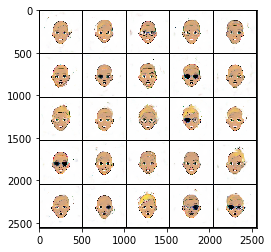

Epoch 36/50 Step 22110... Discriminator Loss: 0.3560... Generator Loss: 4.0080
Epoch 36/50 Step 22120... Discriminator Loss: 0.3693... Generator Loss: 4.4045
Epoch 36/50 Step 22130... Discriminator Loss: 0.3497... Generator Loss: 4.7840
Epoch 36/50 Step 22140... Discriminator Loss: 0.3604... Generator Loss: 4.2146
Epoch 36/50 Step 22150... Discriminator Loss: 0.3508... Generator Loss: 5.3179
Epoch 36/50 Step 22160... Discriminator Loss: 0.4539... Generator Loss: 3.0942
Epoch 36/50 Step 22170... Discriminator Loss: 0.3503... Generator Loss: 5.2099
Epoch 36/50 Step 22180... Discriminator Loss: 0.3532... Generator Loss: 4.5526
Epoch 36/50 Step 22190... Discriminator Loss: 0.3987... Generator Loss: 6.3519
Epoch 36/50 Step 22200... Discriminator Loss: 0.4752... Generator Loss: 4.4678


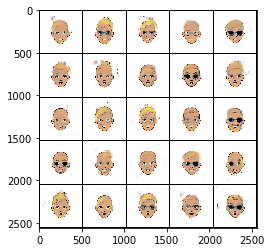

Epoch 36/50 Step 22210... Discriminator Loss: 0.3949... Generator Loss: 3.6461
Epoch 36/50 Step 22220... Discriminator Loss: 0.3559... Generator Loss: 4.3419
Epoch 36/50 Step 22230... Discriminator Loss: 0.3564... Generator Loss: 4.2344
Epoch 36/50 Step 22240... Discriminator Loss: 0.3733... Generator Loss: 4.1803
Epoch 36/50 Step 22250... Discriminator Loss: 0.3515... Generator Loss: 4.7764
Epoch 36/50 Step 22260... Discriminator Loss: 0.3485... Generator Loss: 4.6552
Epoch 36/50 Step 22270... Discriminator Loss: 0.3793... Generator Loss: 3.8225
Epoch 36/50 Step 22280... Discriminator Loss: 0.3456... Generator Loss: 5.1255
Epoch 36/50 Step 22290... Discriminator Loss: 0.3644... Generator Loss: 4.2798
Epoch 36/50 Step 22300... Discriminator Loss: 0.3463... Generator Loss: 4.7005


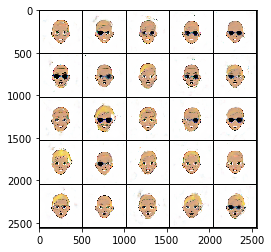

Epoch 36/50 Step 22310... Discriminator Loss: 0.3758... Generator Loss: 5.9439
Epoch 36/50 Step 22320... Discriminator Loss: 0.3570... Generator Loss: 4.7212
Epoch 36/50 Step 22330... Discriminator Loss: 0.3422... Generator Loss: 5.0664
Epoch 36/50 Step 22340... Discriminator Loss: 0.3409... Generator Loss: 5.0945
Epoch 36/50 Step 22350... Discriminator Loss: 0.3433... Generator Loss: 4.9123
Epoch 36/50 Step 22360... Discriminator Loss: 0.3443... Generator Loss: 5.1448
Epoch 36/50 Step 22370... Discriminator Loss: 0.3516... Generator Loss: 4.7390
Epoch 36/50 Step 22380... Discriminator Loss: 0.3713... Generator Loss: 3.9916
Epoch 36/50 Step 22390... Discriminator Loss: 0.3422... Generator Loss: 5.3346
Epoch 36/50 Step 22400... Discriminator Loss: 0.4118... Generator Loss: 3.9134


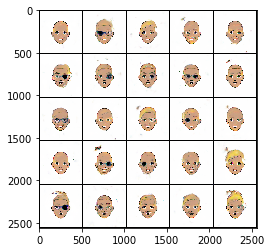

Epoch 36/50 Step 22410... Discriminator Loss: 0.3574... Generator Loss: 4.7783
Epoch 36/50 Step 22420... Discriminator Loss: 0.3353... Generator Loss: 5.4939
Epoch 36/50 Step 22430... Discriminator Loss: 0.3576... Generator Loss: 4.5712
Epoch 36/50 Step 22440... Discriminator Loss: 0.3456... Generator Loss: 4.5045
Epoch 36/50 Step 22450... Discriminator Loss: 0.3478... Generator Loss: 5.3895
Epoch 36/50 Step 22460... Discriminator Loss: 0.3398... Generator Loss: 5.2199
Epoch 36/50 Step 22470... Discriminator Loss: 0.3614... Generator Loss: 4.5237
Epoch 36/50 Step 22480... Discriminator Loss: 0.3465... Generator Loss: 4.9061
Epoch 36/50 Step 22490... Discriminator Loss: 0.3404... Generator Loss: 5.4662
Epoch 36/50 Step 22500... Discriminator Loss: 0.4042... Generator Loss: 3.5104


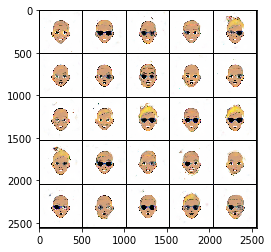

Epoch 37/50 Step 22510... Discriminator Loss: 0.3453... Generator Loss: 5.2133
Epoch 37/50 Step 22520... Discriminator Loss: 7.7659... Generator Loss: 17.8687
Epoch 37/50 Step 22530... Discriminator Loss: 0.4695... Generator Loss: 4.4918
Epoch 37/50 Step 22540... Discriminator Loss: 0.4020... Generator Loss: 3.5792
Epoch 37/50 Step 22550... Discriminator Loss: 0.4191... Generator Loss: 3.3008
Epoch 37/50 Step 22560... Discriminator Loss: 0.3724... Generator Loss: 4.4078
Epoch 37/50 Step 22570... Discriminator Loss: 0.3573... Generator Loss: 4.2607
Epoch 37/50 Step 22580... Discriminator Loss: 0.3950... Generator Loss: 3.6124
Epoch 37/50 Step 22590... Discriminator Loss: 0.3644... Generator Loss: 4.0782
Epoch 37/50 Step 22600... Discriminator Loss: 0.3743... Generator Loss: 4.4087


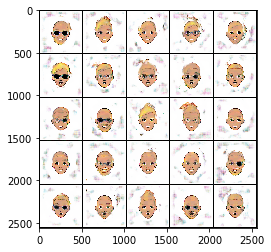

Epoch 37/50 Step 22610... Discriminator Loss: 0.3472... Generator Loss: 4.5391
Epoch 37/50 Step 22620... Discriminator Loss: 0.3533... Generator Loss: 4.5157
Epoch 37/50 Step 22630... Discriminator Loss: 0.3772... Generator Loss: 3.6235
Epoch 37/50 Step 22640... Discriminator Loss: 0.3635... Generator Loss: 4.0696
Epoch 37/50 Step 22650... Discriminator Loss: 0.3660... Generator Loss: 4.0882
Epoch 37/50 Step 22660... Discriminator Loss: 0.3548... Generator Loss: 4.4742
Epoch 37/50 Step 22670... Discriminator Loss: 0.3588... Generator Loss: 5.2192
Epoch 37/50 Step 22680... Discriminator Loss: 0.3509... Generator Loss: 4.7857
Epoch 37/50 Step 22690... Discriminator Loss: 0.3426... Generator Loss: 5.0926
Epoch 37/50 Step 22700... Discriminator Loss: 0.3619... Generator Loss: 3.9099


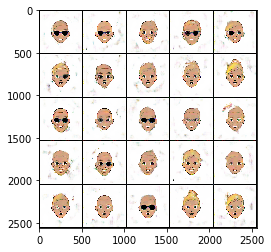

Epoch 37/50 Step 22710... Discriminator Loss: 0.3421... Generator Loss: 5.0269
Epoch 37/50 Step 22720... Discriminator Loss: 0.3477... Generator Loss: 4.3707
Epoch 37/50 Step 22730... Discriminator Loss: 0.3655... Generator Loss: 4.5614
Epoch 37/50 Step 22740... Discriminator Loss: 0.3434... Generator Loss: 5.0463
Epoch 37/50 Step 22750... Discriminator Loss: 0.3466... Generator Loss: 5.0425
Epoch 37/50 Step 22760... Discriminator Loss: 0.3446... Generator Loss: 5.4410
Epoch 37/50 Step 22770... Discriminator Loss: 0.3507... Generator Loss: 4.6469
Epoch 37/50 Step 22780... Discriminator Loss: 0.3451... Generator Loss: 4.7628
Epoch 37/50 Step 22790... Discriminator Loss: 0.3378... Generator Loss: 4.9218
Epoch 37/50 Step 22800... Discriminator Loss: 0.3443... Generator Loss: 5.2919


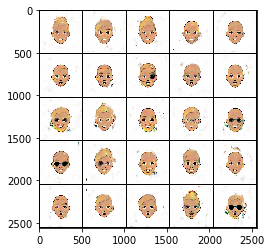

Epoch 37/50 Step 22810... Discriminator Loss: 0.3484... Generator Loss: 4.7078
Epoch 37/50 Step 22820... Discriminator Loss: 0.3710... Generator Loss: 5.7508
Epoch 37/50 Step 22830... Discriminator Loss: 0.3973... Generator Loss: 5.8102
Epoch 37/50 Step 22840... Discriminator Loss: 0.3651... Generator Loss: 4.8994
Epoch 37/50 Step 22850... Discriminator Loss: 0.3532... Generator Loss: 4.3911
Epoch 37/50 Step 22860... Discriminator Loss: 0.3597... Generator Loss: 4.3699
Epoch 37/50 Step 22870... Discriminator Loss: 0.3469... Generator Loss: 5.1916
Epoch 37/50 Step 22880... Discriminator Loss: 0.3509... Generator Loss: 4.9130
Epoch 37/50 Step 22890... Discriminator Loss: 0.3425... Generator Loss: 4.4505
Epoch 37/50 Step 22900... Discriminator Loss: 0.3455... Generator Loss: 4.7127


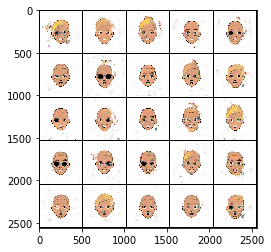

Epoch 37/50 Step 22910... Discriminator Loss: 0.3555... Generator Loss: 4.5522
Epoch 37/50 Step 22920... Discriminator Loss: 0.3383... Generator Loss: 5.0096
Epoch 37/50 Step 22930... Discriminator Loss: 0.3883... Generator Loss: 3.6326
Epoch 37/50 Step 22940... Discriminator Loss: 0.3533... Generator Loss: 4.5391
Epoch 37/50 Step 22950... Discriminator Loss: 0.3432... Generator Loss: 5.0133
Epoch 37/50 Step 22960... Discriminator Loss: 0.3465... Generator Loss: 5.0331
Epoch 37/50 Step 22970... Discriminator Loss: 0.3468... Generator Loss: 4.8875
Epoch 37/50 Step 22980... Discriminator Loss: 0.3444... Generator Loss: 4.9886
Epoch 37/50 Step 22990... Discriminator Loss: 0.3423... Generator Loss: 5.2530
Epoch 37/50 Step 23000... Discriminator Loss: 0.3443... Generator Loss: 4.9527


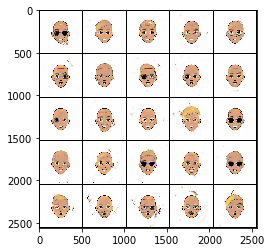

Epoch 37/50 Step 23010... Discriminator Loss: 0.3356... Generator Loss: 5.5707
Epoch 37/50 Step 23020... Discriminator Loss: 0.4060... Generator Loss: 3.5186
Epoch 37/50 Step 23030... Discriminator Loss: 0.3449... Generator Loss: 4.8181
Epoch 37/50 Step 23040... Discriminator Loss: 0.3410... Generator Loss: 5.4825
Epoch 37/50 Step 23050... Discriminator Loss: 0.3569... Generator Loss: 5.1100
Epoch 37/50 Step 23060... Discriminator Loss: 0.3488... Generator Loss: 4.5596
Epoch 37/50 Step 23070... Discriminator Loss: 0.3480... Generator Loss: 4.9730
Epoch 37/50 Step 23080... Discriminator Loss: 0.3494... Generator Loss: 5.0764
Epoch 37/50 Step 23090... Discriminator Loss: 0.3507... Generator Loss: 4.4932
Epoch 37/50 Step 23100... Discriminator Loss: 0.3537... Generator Loss: 5.9855


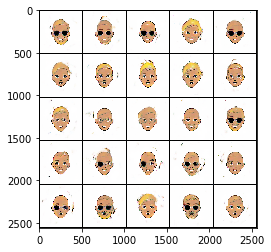

Epoch 37/50 Step 23110... Discriminator Loss: 0.3388... Generator Loss: 5.2512
Epoch 37/50 Step 23120... Discriminator Loss: 0.3375... Generator Loss: 5.2938
Epoch 38/50 Step 23130... Discriminator Loss: 0.3648... Generator Loss: 4.6410
Epoch 38/50 Step 23140... Discriminator Loss: 0.3394... Generator Loss: 5.0722
Epoch 38/50 Step 23150... Discriminator Loss: 0.5330... Generator Loss: 4.6240
Epoch 38/50 Step 23160... Discriminator Loss: 0.3843... Generator Loss: 4.6331
Epoch 38/50 Step 23170... Discriminator Loss: 0.3535... Generator Loss: 5.0347
Epoch 38/50 Step 23180... Discriminator Loss: 0.3531... Generator Loss: 4.7770
Epoch 38/50 Step 23190... Discriminator Loss: 0.3602... Generator Loss: 4.3775
Epoch 38/50 Step 23200... Discriminator Loss: 0.3578... Generator Loss: 4.4972


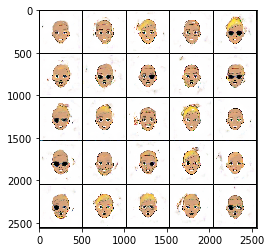

Epoch 38/50 Step 23210... Discriminator Loss: 0.3481... Generator Loss: 4.6076
Epoch 38/50 Step 23220... Discriminator Loss: 0.3457... Generator Loss: 4.7620
Epoch 38/50 Step 23230... Discriminator Loss: 0.3394... Generator Loss: 5.1759
Epoch 38/50 Step 23240... Discriminator Loss: 0.3471... Generator Loss: 5.1304
Epoch 38/50 Step 23250... Discriminator Loss: 0.3400... Generator Loss: 5.4109
Epoch 38/50 Step 23260... Discriminator Loss: 0.3414... Generator Loss: 5.1832
Epoch 38/50 Step 23270... Discriminator Loss: 0.3449... Generator Loss: 4.8881
Epoch 38/50 Step 23280... Discriminator Loss: 0.3553... Generator Loss: 5.0616
Epoch 38/50 Step 23290... Discriminator Loss: 0.3487... Generator Loss: 4.9661
Epoch 38/50 Step 23300... Discriminator Loss: 0.3435... Generator Loss: 5.0778


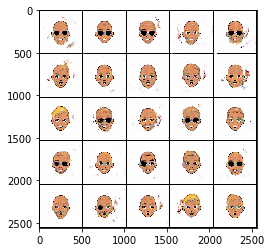

Epoch 38/50 Step 23310... Discriminator Loss: 0.3415... Generator Loss: 5.2280
Epoch 38/50 Step 23320... Discriminator Loss: 0.3584... Generator Loss: 4.3179
Epoch 38/50 Step 23330... Discriminator Loss: 0.3452... Generator Loss: 6.1461
Epoch 38/50 Step 23340... Discriminator Loss: 0.3417... Generator Loss: 5.7447
Epoch 38/50 Step 23350... Discriminator Loss: 0.3467... Generator Loss: 4.9609
Epoch 38/50 Step 23360... Discriminator Loss: 0.3547... Generator Loss: 4.6626
Epoch 38/50 Step 23370... Discriminator Loss: 0.3453... Generator Loss: 5.2103
Epoch 38/50 Step 23380... Discriminator Loss: 0.3400... Generator Loss: 6.0424
Epoch 38/50 Step 23390... Discriminator Loss: 0.3408... Generator Loss: 5.2186
Epoch 38/50 Step 23400... Discriminator Loss: 0.3455... Generator Loss: 4.8212


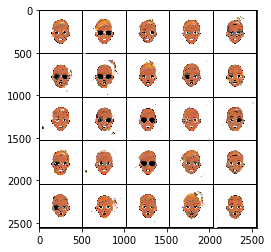

Epoch 38/50 Step 23410... Discriminator Loss: 0.3433... Generator Loss: 4.9715
Epoch 38/50 Step 23420... Discriminator Loss: 0.3392... Generator Loss: 5.3100
Epoch 38/50 Step 23430... Discriminator Loss: 0.7181... Generator Loss: 9.6418
Epoch 38/50 Step 23440... Discriminator Loss: 0.3826... Generator Loss: 6.5742
Epoch 38/50 Step 23450... Discriminator Loss: 0.3559... Generator Loss: 5.7195
Epoch 38/50 Step 23460... Discriminator Loss: 0.3393... Generator Loss: 5.9440
Epoch 38/50 Step 23470... Discriminator Loss: 0.3326... Generator Loss: 6.1510
Epoch 38/50 Step 23480... Discriminator Loss: 0.7636... Generator Loss: 1.8349
Epoch 38/50 Step 23490... Discriminator Loss: 5.4744... Generator Loss: 0.1619
Epoch 38/50 Step 23500... Discriminator Loss: 1.0551... Generator Loss: 5.0139


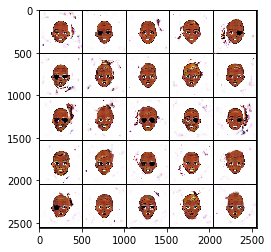

Epoch 38/50 Step 23510... Discriminator Loss: 0.7160... Generator Loss: 1.6867
Epoch 38/50 Step 23520... Discriminator Loss: 0.5151... Generator Loss: 2.5313
Epoch 38/50 Step 23530... Discriminator Loss: 0.3966... Generator Loss: 3.7676
Epoch 38/50 Step 23540... Discriminator Loss: 0.3734... Generator Loss: 4.3405
Epoch 38/50 Step 23550... Discriminator Loss: 0.3815... Generator Loss: 4.3005
Epoch 38/50 Step 23560... Discriminator Loss: 0.3650... Generator Loss: 4.0222
Epoch 38/50 Step 23570... Discriminator Loss: 0.3541... Generator Loss: 4.0529
Epoch 38/50 Step 23580... Discriminator Loss: 0.4097... Generator Loss: 3.1430
Epoch 38/50 Step 23590... Discriminator Loss: 0.3530... Generator Loss: 4.3688
Epoch 38/50 Step 23600... Discriminator Loss: 0.3692... Generator Loss: 4.0314


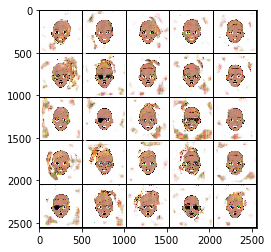

Epoch 38/50 Step 23610... Discriminator Loss: 0.3656... Generator Loss: 4.0697
Epoch 38/50 Step 23620... Discriminator Loss: 0.3667... Generator Loss: 4.0260
Epoch 38/50 Step 23630... Discriminator Loss: 0.3562... Generator Loss: 4.0802
Epoch 38/50 Step 23640... Discriminator Loss: 0.3460... Generator Loss: 4.8512
Epoch 38/50 Step 23650... Discriminator Loss: 0.3747... Generator Loss: 3.9959
Epoch 38/50 Step 23660... Discriminator Loss: 0.3515... Generator Loss: 4.1910
Epoch 38/50 Step 23670... Discriminator Loss: 0.3435... Generator Loss: 4.8783
Epoch 38/50 Step 23680... Discriminator Loss: 0.3571... Generator Loss: 4.6359
Epoch 38/50 Step 23690... Discriminator Loss: 0.3553... Generator Loss: 4.1702
Epoch 38/50 Step 23700... Discriminator Loss: 0.3563... Generator Loss: 5.1175


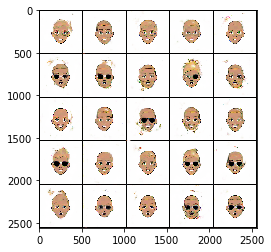

Epoch 38/50 Step 23710... Discriminator Loss: 0.3594... Generator Loss: 3.8580
Epoch 38/50 Step 23720... Discriminator Loss: 0.3476... Generator Loss: 4.4746
Epoch 38/50 Step 23730... Discriminator Loss: 0.3591... Generator Loss: 5.1485
Epoch 38/50 Step 23740... Discriminator Loss: 0.3461... Generator Loss: 5.1093
Epoch 38/50 Step 23750... Discriminator Loss: 0.3632... Generator Loss: 4.0885
Epoch 39/50 Step 23760... Discriminator Loss: 0.3380... Generator Loss: 5.6383
Epoch 39/50 Step 23770... Discriminator Loss: 0.3644... Generator Loss: 4.4617
Epoch 39/50 Step 23780... Discriminator Loss: 0.3436... Generator Loss: 5.7324
Epoch 39/50 Step 23790... Discriminator Loss: 0.3460... Generator Loss: 4.8981
Epoch 39/50 Step 23800... Discriminator Loss: 0.3392... Generator Loss: 4.8763


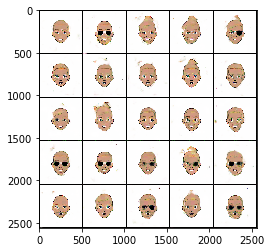

Epoch 39/50 Step 23810... Discriminator Loss: 0.3562... Generator Loss: 6.0401
Epoch 39/50 Step 23820... Discriminator Loss: 0.3418... Generator Loss: 5.4272
Epoch 39/50 Step 23830... Discriminator Loss: 0.4370... Generator Loss: 3.2572
Epoch 39/50 Step 23840... Discriminator Loss: 0.3374... Generator Loss: 5.4830
Epoch 39/50 Step 23850... Discriminator Loss: 0.3475... Generator Loss: 6.1458
Epoch 39/50 Step 23860... Discriminator Loss: 0.3379... Generator Loss: 5.1593
Epoch 39/50 Step 23870... Discriminator Loss: 0.3444... Generator Loss: 5.2968
Epoch 39/50 Step 23880... Discriminator Loss: 0.3490... Generator Loss: 4.4789
Epoch 39/50 Step 23890... Discriminator Loss: 0.3647... Generator Loss: 4.2240
Epoch 39/50 Step 23900... Discriminator Loss: 0.5648... Generator Loss: 2.8281


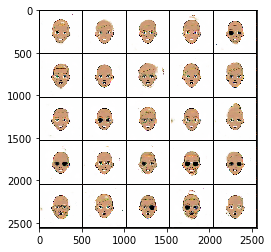

Epoch 39/50 Step 23910... Discriminator Loss: 0.3583... Generator Loss: 4.6178
Epoch 39/50 Step 23920... Discriminator Loss: 0.4122... Generator Loss: 6.4633
Epoch 39/50 Step 23930... Discriminator Loss: 0.3526... Generator Loss: 4.8295
Epoch 39/50 Step 23940... Discriminator Loss: 0.3408... Generator Loss: 5.4150
Epoch 39/50 Step 23950... Discriminator Loss: 0.3544... Generator Loss: 4.7465
Epoch 39/50 Step 23960... Discriminator Loss: 0.3387... Generator Loss: 5.4558
Epoch 39/50 Step 23970... Discriminator Loss: 0.3493... Generator Loss: 4.8293
Epoch 39/50 Step 23980... Discriminator Loss: 0.3734... Generator Loss: 5.8261
Epoch 39/50 Step 23990... Discriminator Loss: 0.3457... Generator Loss: 4.6669
Epoch 39/50 Step 24000... Discriminator Loss: 0.3470... Generator Loss: 4.6733


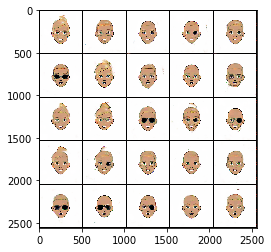

Epoch 39/50 Step 24010... Discriminator Loss: 0.3596... Generator Loss: 4.7246
Epoch 39/50 Step 24020... Discriminator Loss: 0.3417... Generator Loss: 5.1983
Epoch 39/50 Step 24030... Discriminator Loss: 0.3345... Generator Loss: 5.7332
Epoch 39/50 Step 24040... Discriminator Loss: 0.3364... Generator Loss: 5.4590
Epoch 39/50 Step 24050... Discriminator Loss: 0.3335... Generator Loss: 5.6001
Epoch 39/50 Step 24060... Discriminator Loss: 0.3359... Generator Loss: 5.2774
Epoch 39/50 Step 24070... Discriminator Loss: 1.0022... Generator Loss: 8.4923
Epoch 39/50 Step 24080... Discriminator Loss: 0.3851... Generator Loss: 4.2830
Epoch 39/50 Step 24090... Discriminator Loss: 0.3878... Generator Loss: 5.7311
Epoch 39/50 Step 24100... Discriminator Loss: 0.3445... Generator Loss: 5.3962


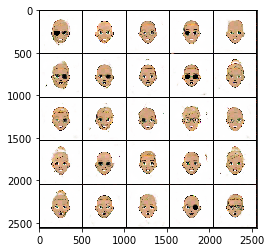

Epoch 39/50 Step 24110... Discriminator Loss: 0.3415... Generator Loss: 5.4255
Epoch 39/50 Step 24120... Discriminator Loss: 0.3462... Generator Loss: 5.1917
Epoch 39/50 Step 24130... Discriminator Loss: 0.3463... Generator Loss: 5.4098
Epoch 39/50 Step 24140... Discriminator Loss: 0.3471... Generator Loss: 5.1552
Epoch 39/50 Step 24150... Discriminator Loss: 0.3516... Generator Loss: 5.3147
Epoch 39/50 Step 24160... Discriminator Loss: 0.3412... Generator Loss: 5.3546
Epoch 39/50 Step 24170... Discriminator Loss: 0.3396... Generator Loss: 5.3081
Epoch 39/50 Step 24180... Discriminator Loss: 0.4108... Generator Loss: 3.9858
Epoch 39/50 Step 24190... Discriminator Loss: 0.3412... Generator Loss: 5.4721
Epoch 39/50 Step 24200... Discriminator Loss: 0.3395... Generator Loss: 5.9278


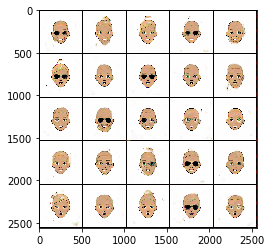

Epoch 39/50 Step 24210... Discriminator Loss: 0.3391... Generator Loss: 5.7531
Epoch 39/50 Step 24220... Discriminator Loss: 0.3341... Generator Loss: 5.5483
Epoch 39/50 Step 24230... Discriminator Loss: 0.3405... Generator Loss: 5.5423
Epoch 39/50 Step 24240... Discriminator Loss: 0.3325... Generator Loss: 5.8702
Epoch 39/50 Step 24250... Discriminator Loss: 0.3332... Generator Loss: 5.8196
Epoch 39/50 Step 24260... Discriminator Loss: 0.3334... Generator Loss: 6.0106
Epoch 39/50 Step 24270... Discriminator Loss: 0.3513... Generator Loss: 4.8454
Epoch 39/50 Step 24280... Discriminator Loss: 0.3390... Generator Loss: 5.7782
Epoch 39/50 Step 24290... Discriminator Loss: 0.3364... Generator Loss: 5.7114
Epoch 39/50 Step 24300... Discriminator Loss: 0.3347... Generator Loss: 5.3127


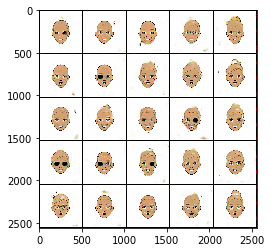

Epoch 39/50 Step 24310... Discriminator Loss: 0.3420... Generator Loss: 4.9541
Epoch 39/50 Step 24320... Discriminator Loss: 0.3472... Generator Loss: 5.7709
Epoch 39/50 Step 24330... Discriminator Loss: 0.3411... Generator Loss: 5.2626
Epoch 39/50 Step 24340... Discriminator Loss: 0.3381... Generator Loss: 5.7432
Epoch 39/50 Step 24350... Discriminator Loss: 0.3353... Generator Loss: 5.8208
Epoch 39/50 Step 24360... Discriminator Loss: 0.3318... Generator Loss: 6.2764
Epoch 39/50 Step 24370... Discriminator Loss: 0.3338... Generator Loss: 5.5302
Epoch 40/50 Step 24380... Discriminator Loss: 0.3411... Generator Loss: 5.9611
Epoch 40/50 Step 24390... Discriminator Loss: 0.3338... Generator Loss: 5.5709
Epoch 40/50 Step 24400... Discriminator Loss: 0.3360... Generator Loss: 5.6640


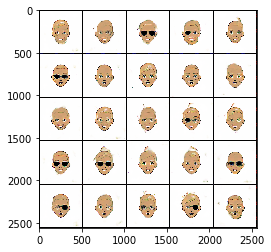

Epoch 40/50 Step 24410... Discriminator Loss: 0.3318... Generator Loss: 6.1569
Epoch 40/50 Step 24420... Discriminator Loss: 0.3360... Generator Loss: 6.2338
Epoch 40/50 Step 24430... Discriminator Loss: 0.3299... Generator Loss: 5.9436
Epoch 40/50 Step 24440... Discriminator Loss: 0.3452... Generator Loss: 5.4799
Epoch 40/50 Step 24450... Discriminator Loss: 0.3409... Generator Loss: 5.7466
Epoch 40/50 Step 24460... Discriminator Loss: 0.3393... Generator Loss: 5.8195
Epoch 40/50 Step 24470... Discriminator Loss: 0.3429... Generator Loss: 5.9490
Epoch 40/50 Step 24480... Discriminator Loss: 0.3387... Generator Loss: 6.5169
Epoch 40/50 Step 24490... Discriminator Loss: 0.3499... Generator Loss: 5.5301
Epoch 40/50 Step 24500... Discriminator Loss: 0.3438... Generator Loss: 5.1173


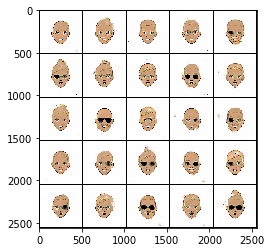

Epoch 40/50 Step 24510... Discriminator Loss: 0.3544... Generator Loss: 4.9458
Epoch 40/50 Step 24520... Discriminator Loss: 0.3428... Generator Loss: 6.2218
Epoch 40/50 Step 24530... Discriminator Loss: 0.3570... Generator Loss: 5.1239
Epoch 40/50 Step 24540... Discriminator Loss: 0.3693... Generator Loss: 4.6026
Epoch 40/50 Step 24550... Discriminator Loss: 0.3454... Generator Loss: 5.0304
Epoch 40/50 Step 24560... Discriminator Loss: 0.3405... Generator Loss: 5.3635
Epoch 40/50 Step 24570... Discriminator Loss: 0.3417... Generator Loss: 4.9035
Epoch 40/50 Step 24580... Discriminator Loss: 0.3448... Generator Loss: 6.4201
Epoch 40/50 Step 24590... Discriminator Loss: 0.3390... Generator Loss: 5.4840
Epoch 40/50 Step 24600... Discriminator Loss: 0.3387... Generator Loss: 5.0810


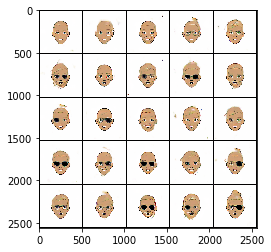

Epoch 40/50 Step 24610... Discriminator Loss: 0.3450... Generator Loss: 6.0184
Epoch 40/50 Step 24620... Discriminator Loss: 0.3413... Generator Loss: 5.5284
Epoch 40/50 Step 24630... Discriminator Loss: 0.3391... Generator Loss: 6.3638
Epoch 40/50 Step 24640... Discriminator Loss: 0.3442... Generator Loss: 5.7421
Epoch 40/50 Step 24650... Discriminator Loss: 0.3337... Generator Loss: 6.0485
Epoch 40/50 Step 24660... Discriminator Loss: 0.5071... Generator Loss: 3.4776
Epoch 40/50 Step 24670... Discriminator Loss: 1.1042... Generator Loss: 6.7861
Epoch 40/50 Step 24680... Discriminator Loss: 0.5267... Generator Loss: 5.3599
Epoch 40/50 Step 24690... Discriminator Loss: 0.4782... Generator Loss: 6.3228
Epoch 40/50 Step 24700... Discriminator Loss: 0.5138... Generator Loss: 2.5205


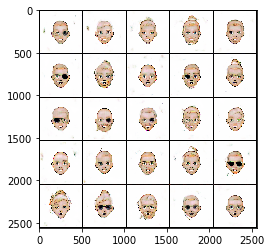

Epoch 40/50 Step 24710... Discriminator Loss: 0.3755... Generator Loss: 3.7676
Epoch 40/50 Step 24720... Discriminator Loss: 0.3663... Generator Loss: 4.2394
Epoch 40/50 Step 24730... Discriminator Loss: 0.3462... Generator Loss: 4.5786
Epoch 40/50 Step 24740... Discriminator Loss: 0.3743... Generator Loss: 4.7085
Epoch 40/50 Step 24750... Discriminator Loss: 0.3552... Generator Loss: 4.3959
Epoch 40/50 Step 24760... Discriminator Loss: 0.3578... Generator Loss: 4.3529
Epoch 40/50 Step 24770... Discriminator Loss: 0.3821... Generator Loss: 3.9467
Epoch 40/50 Step 24780... Discriminator Loss: 0.3465... Generator Loss: 4.8131
Epoch 40/50 Step 24790... Discriminator Loss: 0.3875... Generator Loss: 3.8555
Epoch 40/50 Step 24800... Discriminator Loss: 0.3465... Generator Loss: 5.0101


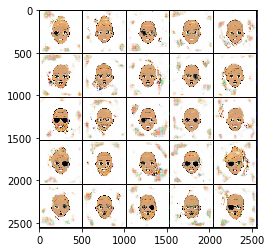

Epoch 40/50 Step 24810... Discriminator Loss: 0.3574... Generator Loss: 5.6281
Epoch 40/50 Step 24820... Discriminator Loss: 0.3382... Generator Loss: 5.4614
Epoch 40/50 Step 24830... Discriminator Loss: 0.3406... Generator Loss: 5.4659
Epoch 40/50 Step 24840... Discriminator Loss: 0.3372... Generator Loss: 5.2627
Epoch 40/50 Step 24850... Discriminator Loss: 0.3354... Generator Loss: 5.1763
Epoch 40/50 Step 24860... Discriminator Loss: 0.3468... Generator Loss: 4.8971
Epoch 40/50 Step 24870... Discriminator Loss: 0.3372... Generator Loss: 5.3524
Epoch 40/50 Step 24880... Discriminator Loss: 0.3483... Generator Loss: 4.9519
Epoch 40/50 Step 24890... Discriminator Loss: 0.3389... Generator Loss: 5.7061
Epoch 40/50 Step 24900... Discriminator Loss: 0.3393... Generator Loss: 5.0886


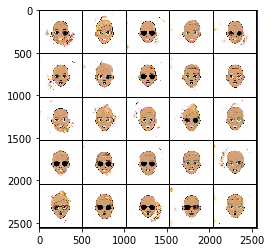

Epoch 40/50 Step 24910... Discriminator Loss: 0.3355... Generator Loss: 5.7616
Epoch 40/50 Step 24920... Discriminator Loss: 0.3328... Generator Loss: 6.2927
Epoch 40/50 Step 24930... Discriminator Loss: 0.3367... Generator Loss: 5.9976
Epoch 40/50 Step 24940... Discriminator Loss: 0.3373... Generator Loss: 5.3020
Epoch 40/50 Step 24950... Discriminator Loss: 0.3388... Generator Loss: 5.4879
Epoch 40/50 Step 24960... Discriminator Loss: 0.3310... Generator Loss: 5.7555
Epoch 40/50 Step 24970... Discriminator Loss: 0.3366... Generator Loss: 5.2741
Epoch 40/50 Step 24980... Discriminator Loss: 0.3401... Generator Loss: 5.6850
Epoch 40/50 Step 24990... Discriminator Loss: 0.3380... Generator Loss: 5.8169
Epoch 40/50 Step 25000... Discriminator Loss: 0.3434... Generator Loss: 5.5158


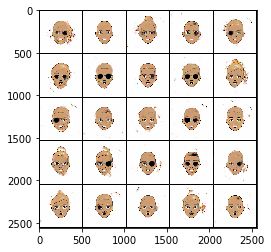

Epoch 41/50 Step 25010... Discriminator Loss: 0.3375... Generator Loss: 5.3772
Epoch 41/50 Step 25020... Discriminator Loss: 0.3724... Generator Loss: 4.9064
Epoch 41/50 Step 25030... Discriminator Loss: 0.3325... Generator Loss: 6.0459
Epoch 41/50 Step 25040... Discriminator Loss: 0.3383... Generator Loss: 5.7481
Epoch 41/50 Step 25050... Discriminator Loss: 0.3303... Generator Loss: 5.8050
Epoch 41/50 Step 25060... Discriminator Loss: 0.3330... Generator Loss: 6.4078
Epoch 41/50 Step 25070... Discriminator Loss: 0.3349... Generator Loss: 5.5964
Epoch 41/50 Step 25080... Discriminator Loss: 0.3323... Generator Loss: 5.6876
Epoch 41/50 Step 25090... Discriminator Loss: 0.3572... Generator Loss: 5.0739
Epoch 41/50 Step 25100... Discriminator Loss: 0.3450... Generator Loss: 6.2805


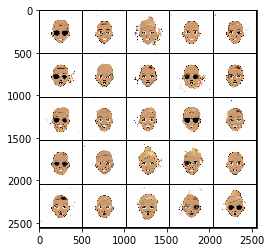

Epoch 41/50 Step 25110... Discriminator Loss: 0.3326... Generator Loss: 5.6721
Epoch 41/50 Step 25120... Discriminator Loss: 0.3413... Generator Loss: 6.1495
Epoch 41/50 Step 25130... Discriminator Loss: 0.3411... Generator Loss: 5.4421
Epoch 41/50 Step 25140... Discriminator Loss: 0.3340... Generator Loss: 5.6763
Epoch 41/50 Step 25150... Discriminator Loss: 0.3395... Generator Loss: 5.8157
Epoch 41/50 Step 25160... Discriminator Loss: 0.3424... Generator Loss: 5.0061
Epoch 41/50 Step 25170... Discriminator Loss: 0.3377... Generator Loss: 6.5251
Epoch 41/50 Step 25180... Discriminator Loss: 0.3579... Generator Loss: 4.9891
Epoch 41/50 Step 25190... Discriminator Loss: 0.3316... Generator Loss: 6.0087
Epoch 41/50 Step 25200... Discriminator Loss: 0.3356... Generator Loss: 6.1623


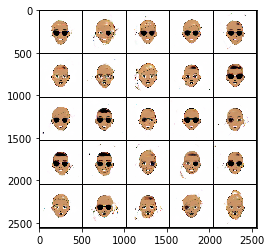

Epoch 41/50 Step 25210... Discriminator Loss: 0.3319... Generator Loss: 5.8804
Epoch 41/50 Step 25220... Discriminator Loss: 0.3811... Generator Loss: 4.5945
Epoch 41/50 Step 25230... Discriminator Loss: 0.3707... Generator Loss: 5.3487
Epoch 41/50 Step 25240... Discriminator Loss: 0.3351... Generator Loss: 5.4878
Epoch 41/50 Step 25250... Discriminator Loss: 0.3414... Generator Loss: 5.5444
Epoch 41/50 Step 25260... Discriminator Loss: 0.3294... Generator Loss: 6.5222
Epoch 41/50 Step 25270... Discriminator Loss: 0.3328... Generator Loss: 5.9166
Epoch 41/50 Step 25280... Discriminator Loss: 0.3474... Generator Loss: 5.6307
Epoch 41/50 Step 25290... Discriminator Loss: 0.3534... Generator Loss: 6.0194
Epoch 41/50 Step 25300... Discriminator Loss: 0.3374... Generator Loss: 6.1090


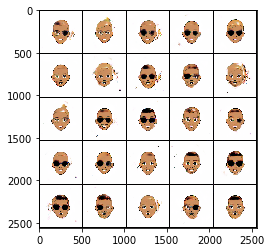

Epoch 41/50 Step 25310... Discriminator Loss: 0.3309... Generator Loss: 5.7752
Epoch 41/50 Step 25320... Discriminator Loss: 0.3333... Generator Loss: 6.0808
Epoch 41/50 Step 25330... Discriminator Loss: 0.3330... Generator Loss: 6.3787
Epoch 41/50 Step 25340... Discriminator Loss: 0.3496... Generator Loss: 4.9896
Epoch 41/50 Step 25350... Discriminator Loss: 0.3677... Generator Loss: 5.8775
Epoch 41/50 Step 25360... Discriminator Loss: 0.3474... Generator Loss: 5.1673
Epoch 41/50 Step 25370... Discriminator Loss: 0.3644... Generator Loss: 6.4921
Epoch 41/50 Step 25380... Discriminator Loss: 1.7075... Generator Loss: 0.5920
Epoch 41/50 Step 25390... Discriminator Loss: 1992.7485... Generator Loss: 1953.0151
Epoch 41/50 Step 25400... Discriminator Loss: 17.8887... Generator Loss: 2.1255


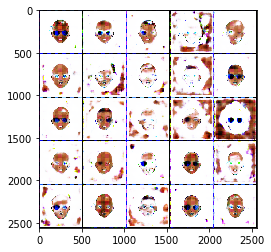

Epoch 41/50 Step 25410... Discriminator Loss: 6.0246... Generator Loss: 4.1394
Epoch 41/50 Step 25420... Discriminator Loss: 1.8000... Generator Loss: 5.0897
Epoch 41/50 Step 25430... Discriminator Loss: 3.4061... Generator Loss: 0.6255
Epoch 41/50 Step 25440... Discriminator Loss: 0.9973... Generator Loss: 3.0197
Epoch 41/50 Step 25450... Discriminator Loss: 1.1625... Generator Loss: 3.5362
Epoch 41/50 Step 25460... Discriminator Loss: 0.8619... Generator Loss: 2.8410
Epoch 41/50 Step 25470... Discriminator Loss: 0.8048... Generator Loss: 2.1321
Epoch 41/50 Step 25480... Discriminator Loss: 0.9429... Generator Loss: 1.9931
Epoch 41/50 Step 25490... Discriminator Loss: 0.6881... Generator Loss: 3.2985
Epoch 41/50 Step 25500... Discriminator Loss: 2.2711... Generator Loss: 0.3897


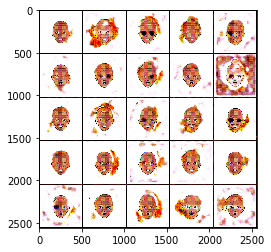

Epoch 41/50 Step 25510... Discriminator Loss: 0.5892... Generator Loss: 2.0695
Epoch 41/50 Step 25520... Discriminator Loss: 1.4236... Generator Loss: 0.7692
Epoch 41/50 Step 25530... Discriminator Loss: 0.7479... Generator Loss: 2.9469
Epoch 41/50 Step 25540... Discriminator Loss: 0.9923... Generator Loss: 4.1646
Epoch 41/50 Step 25550... Discriminator Loss: 0.5955... Generator Loss: 4.1482
Epoch 41/50 Step 25560... Discriminator Loss: 1.0694... Generator Loss: 1.4179
Epoch 41/50 Step 25570... Discriminator Loss: 0.6708... Generator Loss: 3.9032
Epoch 41/50 Step 25580... Discriminator Loss: 0.6096... Generator Loss: 2.7836
Epoch 41/50 Step 25590... Discriminator Loss: 0.5600... Generator Loss: 2.7450
Epoch 41/50 Step 25600... Discriminator Loss: 0.8337... Generator Loss: 3.6956


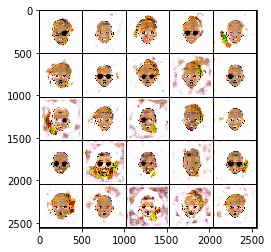

Epoch 41/50 Step 25610... Discriminator Loss: 0.5042... Generator Loss: 3.3961
Epoch 41/50 Step 25620... Discriminator Loss: 0.6639... Generator Loss: 1.7598
Epoch 42/50 Step 25630... Discriminator Loss: 0.5690... Generator Loss: 2.7693
Epoch 42/50 Step 25640... Discriminator Loss: 0.6095... Generator Loss: 2.0440
Epoch 42/50 Step 25650... Discriminator Loss: 0.5246... Generator Loss: 3.2859
Epoch 42/50 Step 25660... Discriminator Loss: 0.4339... Generator Loss: 3.2071
Epoch 42/50 Step 25670... Discriminator Loss: 0.4710... Generator Loss: 2.4091
Epoch 42/50 Step 25680... Discriminator Loss: 0.4492... Generator Loss: 3.5478
Epoch 42/50 Step 25690... Discriminator Loss: 0.5745... Generator Loss: 2.2485
Epoch 42/50 Step 25700... Discriminator Loss: 0.5017... Generator Loss: 2.5440


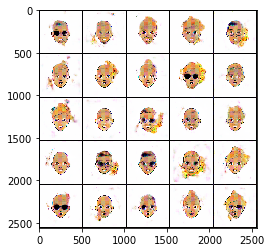

Epoch 42/50 Step 25710... Discriminator Loss: 0.7314... Generator Loss: 1.6032
Epoch 42/50 Step 25720... Discriminator Loss: 0.5788... Generator Loss: 2.8986
Epoch 42/50 Step 25730... Discriminator Loss: 0.5245... Generator Loss: 2.5134
Epoch 42/50 Step 25740... Discriminator Loss: 0.6148... Generator Loss: 3.4390
Epoch 42/50 Step 25750... Discriminator Loss: 0.5601... Generator Loss: 2.4088
Epoch 42/50 Step 25760... Discriminator Loss: 0.5296... Generator Loss: 2.7791
Epoch 42/50 Step 25770... Discriminator Loss: 0.5113... Generator Loss: 2.4549
Epoch 42/50 Step 25780... Discriminator Loss: 0.5368... Generator Loss: 2.1314
Epoch 42/50 Step 25790... Discriminator Loss: 0.5863... Generator Loss: 2.0133
Epoch 42/50 Step 25800... Discriminator Loss: 0.4863... Generator Loss: 2.7910


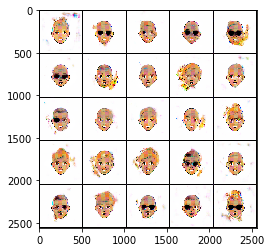

Epoch 42/50 Step 25810... Discriminator Loss: 0.4845... Generator Loss: 2.4474
Epoch 42/50 Step 25820... Discriminator Loss: 0.5143... Generator Loss: 2.9301
Epoch 42/50 Step 25830... Discriminator Loss: 0.5451... Generator Loss: 3.7096
Epoch 42/50 Step 25840... Discriminator Loss: 0.5529... Generator Loss: 3.9129
Epoch 42/50 Step 25850... Discriminator Loss: 0.4930... Generator Loss: 3.1235
Epoch 42/50 Step 25860... Discriminator Loss: 0.4437... Generator Loss: 2.6010
Epoch 42/50 Step 25870... Discriminator Loss: 0.5365... Generator Loss: 2.2791
Epoch 42/50 Step 25880... Discriminator Loss: 0.5308... Generator Loss: 2.2450
Epoch 42/50 Step 25890... Discriminator Loss: 0.4580... Generator Loss: 2.9088
Epoch 42/50 Step 25900... Discriminator Loss: 0.4835... Generator Loss: 4.3536


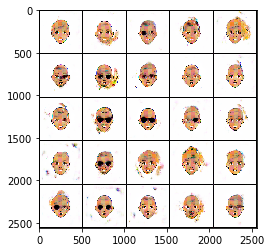

Epoch 42/50 Step 25910... Discriminator Loss: 0.4448... Generator Loss: 2.5397
Epoch 42/50 Step 25920... Discriminator Loss: 0.5190... Generator Loss: 2.1683
Epoch 42/50 Step 25930... Discriminator Loss: 0.4287... Generator Loss: 3.4545
Epoch 42/50 Step 25940... Discriminator Loss: 0.5745... Generator Loss: 2.0367
Epoch 42/50 Step 25950... Discriminator Loss: 0.4994... Generator Loss: 2.6904
Epoch 42/50 Step 25960... Discriminator Loss: 0.4089... Generator Loss: 3.1436
Epoch 42/50 Step 25970... Discriminator Loss: 0.4226... Generator Loss: 3.4301
Epoch 42/50 Step 25980... Discriminator Loss: 0.4285... Generator Loss: 3.8416
Epoch 42/50 Step 25990... Discriminator Loss: 0.4412... Generator Loss: 3.1321
Epoch 42/50 Step 26000... Discriminator Loss: 0.4559... Generator Loss: 2.6561


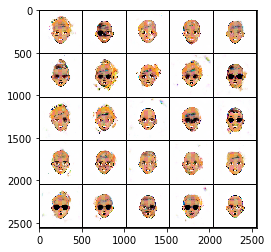

Epoch 42/50 Step 26010... Discriminator Loss: 0.5531... Generator Loss: 4.0972
Epoch 42/50 Step 26020... Discriminator Loss: 0.5384... Generator Loss: 2.4603
Epoch 42/50 Step 26030... Discriminator Loss: 0.3981... Generator Loss: 3.3226
Epoch 42/50 Step 26040... Discriminator Loss: 0.4232... Generator Loss: 3.2100
Epoch 42/50 Step 26050... Discriminator Loss: 0.3949... Generator Loss: 3.6321
Epoch 42/50 Step 26060... Discriminator Loss: 0.3745... Generator Loss: 3.7185
Epoch 42/50 Step 26070... Discriminator Loss: 0.4498... Generator Loss: 2.7561
Epoch 42/50 Step 26080... Discriminator Loss: 0.4693... Generator Loss: 2.5371
Epoch 42/50 Step 26090... Discriminator Loss: 0.4297... Generator Loss: 3.2729
Epoch 42/50 Step 26100... Discriminator Loss: 0.8426... Generator Loss: 1.2556


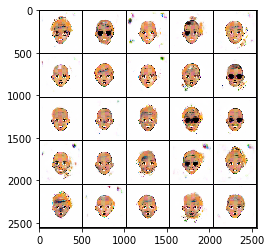

Epoch 42/50 Step 26110... Discriminator Loss: 0.3999... Generator Loss: 3.5866
Epoch 42/50 Step 26120... Discriminator Loss: 0.4487... Generator Loss: 3.1807
Epoch 42/50 Step 26130... Discriminator Loss: 0.4291... Generator Loss: 3.1240
Epoch 42/50 Step 26140... Discriminator Loss: 0.4043... Generator Loss: 4.3711
Epoch 42/50 Step 26150... Discriminator Loss: 0.4444... Generator Loss: 3.1162
Epoch 42/50 Step 26160... Discriminator Loss: 0.4610... Generator Loss: 2.4726
Epoch 42/50 Step 26170... Discriminator Loss: 0.3950... Generator Loss: 3.7553
Epoch 42/50 Step 26180... Discriminator Loss: 0.3916... Generator Loss: 3.6642
Epoch 42/50 Step 26190... Discriminator Loss: 0.4120... Generator Loss: 3.7973
Epoch 42/50 Step 26200... Discriminator Loss: 0.4113... Generator Loss: 3.8805


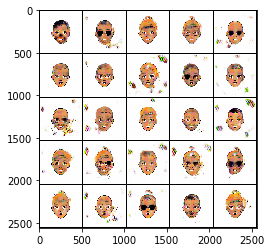

Epoch 42/50 Step 26210... Discriminator Loss: 0.3943... Generator Loss: 3.1259
Epoch 42/50 Step 26220... Discriminator Loss: 0.3997... Generator Loss: 4.1374
Epoch 42/50 Step 26230... Discriminator Loss: 0.3891... Generator Loss: 3.6782
Epoch 42/50 Step 26240... Discriminator Loss: 0.4047... Generator Loss: 4.3499
Epoch 42/50 Step 26250... Discriminator Loss: 0.6324... Generator Loss: 2.0449
Epoch 43/50 Step 26260... Discriminator Loss: 0.4353... Generator Loss: 3.2784
Epoch 43/50 Step 26270... Discriminator Loss: 1.4394... Generator Loss: 0.6966
Epoch 43/50 Step 26280... Discriminator Loss: 0.3803... Generator Loss: 4.1564
Epoch 43/50 Step 26290... Discriminator Loss: 0.4011... Generator Loss: 3.6445
Epoch 43/50 Step 26300... Discriminator Loss: 0.3987... Generator Loss: 3.5786


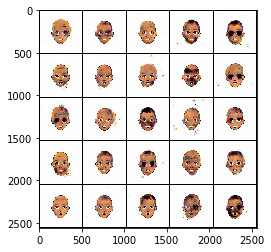

Epoch 43/50 Step 26310... Discriminator Loss: 0.4282... Generator Loss: 3.1670
Epoch 43/50 Step 26320... Discriminator Loss: 0.3913... Generator Loss: 4.0107
Epoch 43/50 Step 26330... Discriminator Loss: 0.4094... Generator Loss: 3.5926
Epoch 43/50 Step 26340... Discriminator Loss: 0.4161... Generator Loss: 3.5756
Epoch 43/50 Step 26350... Discriminator Loss: 0.4143... Generator Loss: 3.9748
Epoch 43/50 Step 26360... Discriminator Loss: 0.3980... Generator Loss: 4.3414
Epoch 43/50 Step 26370... Discriminator Loss: 0.3741... Generator Loss: 4.1489
Epoch 43/50 Step 26380... Discriminator Loss: 0.5158... Generator Loss: 2.2332
Epoch 43/50 Step 26390... Discriminator Loss: 0.5134... Generator Loss: 2.3459
Epoch 43/50 Step 26400... Discriminator Loss: 0.4313... Generator Loss: 3.3198


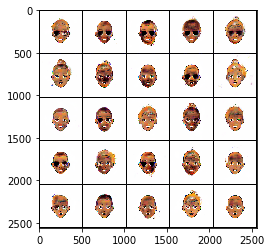

Epoch 43/50 Step 26410... Discriminator Loss: 0.4368... Generator Loss: 3.4765
Epoch 43/50 Step 26420... Discriminator Loss: 0.3824... Generator Loss: 4.2075
Epoch 43/50 Step 26430... Discriminator Loss: 0.5276... Generator Loss: 2.1490
Epoch 43/50 Step 26440... Discriminator Loss: 0.4170... Generator Loss: 4.5191
Epoch 43/50 Step 26450... Discriminator Loss: 0.5442... Generator Loss: 2.3484
Epoch 43/50 Step 26460... Discriminator Loss: 0.4283... Generator Loss: 4.9065
Epoch 43/50 Step 26470... Discriminator Loss: 0.3790... Generator Loss: 4.2952
Epoch 43/50 Step 26480... Discriminator Loss: 0.3710... Generator Loss: 4.1316
Epoch 43/50 Step 26490... Discriminator Loss: 0.3792... Generator Loss: 3.8581
Epoch 43/50 Step 26500... Discriminator Loss: 0.4202... Generator Loss: 3.2401


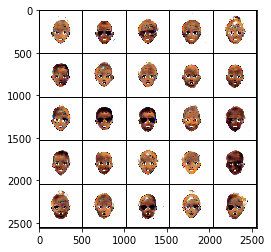

Epoch 43/50 Step 26510... Discriminator Loss: 0.3774... Generator Loss: 4.3819
Epoch 43/50 Step 26520... Discriminator Loss: 0.4116... Generator Loss: 3.4363
Epoch 43/50 Step 26530... Discriminator Loss: 0.4090... Generator Loss: 4.4522
Epoch 43/50 Step 26540... Discriminator Loss: 0.3952... Generator Loss: 4.3184
Epoch 43/50 Step 26550... Discriminator Loss: 0.3768... Generator Loss: 3.6737
Epoch 43/50 Step 26560... Discriminator Loss: 0.3749... Generator Loss: 4.0222
Epoch 43/50 Step 26570... Discriminator Loss: 0.3586... Generator Loss: 4.4684
Epoch 43/50 Step 26580... Discriminator Loss: 0.4456... Generator Loss: 4.5043
Epoch 43/50 Step 26590... Discriminator Loss: 0.4065... Generator Loss: 4.0799
Epoch 43/50 Step 26600... Discriminator Loss: 0.4181... Generator Loss: 4.1755


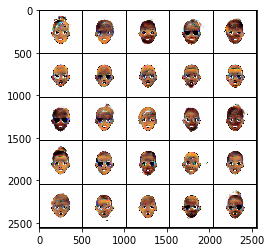

Epoch 43/50 Step 26610... Discriminator Loss: 0.4294... Generator Loss: 2.9623
Epoch 43/50 Step 26620... Discriminator Loss: 0.3861... Generator Loss: 3.5010
Epoch 43/50 Step 26630... Discriminator Loss: 0.3933... Generator Loss: 4.4228
Epoch 43/50 Step 26640... Discriminator Loss: 0.4306... Generator Loss: 4.7020
Epoch 43/50 Step 26650... Discriminator Loss: 0.3773... Generator Loss: 4.3022
Epoch 43/50 Step 26660... Discriminator Loss: 0.3777... Generator Loss: 4.4868
Epoch 43/50 Step 26670... Discriminator Loss: 0.4060... Generator Loss: 3.7648
Epoch 43/50 Step 26680... Discriminator Loss: 0.3796... Generator Loss: 3.8863
Epoch 43/50 Step 26690... Discriminator Loss: 0.3798... Generator Loss: 3.8476
Epoch 43/50 Step 26700... Discriminator Loss: 0.4106... Generator Loss: 4.1310


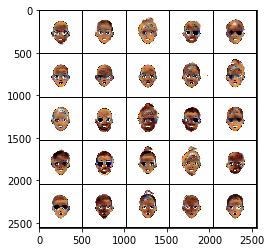

Epoch 43/50 Step 26710... Discriminator Loss: 0.5282... Generator Loss: 2.7575
Epoch 43/50 Step 26720... Discriminator Loss: 0.3463... Generator Loss: 4.7902
Epoch 43/50 Step 26730... Discriminator Loss: 0.3819... Generator Loss: 3.9281
Epoch 43/50 Step 26740... Discriminator Loss: 0.3589... Generator Loss: 4.6548
Epoch 43/50 Step 26750... Discriminator Loss: 0.4041... Generator Loss: 3.2794
Epoch 43/50 Step 26760... Discriminator Loss: 0.3647... Generator Loss: 4.9977
Epoch 43/50 Step 26770... Discriminator Loss: 0.3996... Generator Loss: 4.2204
Epoch 43/50 Step 26780... Discriminator Loss: 0.4411... Generator Loss: 4.6700
Epoch 43/50 Step 26790... Discriminator Loss: 0.4515... Generator Loss: 5.2228
Epoch 43/50 Step 26800... Discriminator Loss: 0.3849... Generator Loss: 5.0492


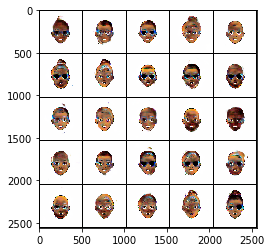

Epoch 43/50 Step 26810... Discriminator Loss: 0.4828... Generator Loss: 2.6094
Epoch 43/50 Step 26820... Discriminator Loss: 0.3868... Generator Loss: 4.2972
Epoch 43/50 Step 26830... Discriminator Loss: 0.3712... Generator Loss: 4.5633
Epoch 43/50 Step 26840... Discriminator Loss: 0.3728... Generator Loss: 4.3305
Epoch 43/50 Step 26850... Discriminator Loss: 0.3614... Generator Loss: 4.9396
Epoch 43/50 Step 26860... Discriminator Loss: 0.3857... Generator Loss: 4.8630
Epoch 43/50 Step 26870... Discriminator Loss: 0.3639... Generator Loss: 4.6877
Epoch 44/50 Step 26880... Discriminator Loss: 0.3717... Generator Loss: 3.8131
Epoch 44/50 Step 26890... Discriminator Loss: 0.3604... Generator Loss: 5.0282
Epoch 44/50 Step 26900... Discriminator Loss: 0.3607... Generator Loss: 5.1696


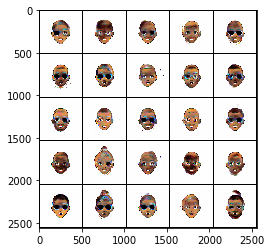

Epoch 44/50 Step 26910... Discriminator Loss: 0.3581... Generator Loss: 4.7951
Epoch 44/50 Step 26920... Discriminator Loss: 0.4024... Generator Loss: 5.0020
Epoch 44/50 Step 26930... Discriminator Loss: 0.3676... Generator Loss: 4.9887
Epoch 44/50 Step 26940... Discriminator Loss: 0.4034... Generator Loss: 3.6568
Epoch 44/50 Step 26950... Discriminator Loss: 0.3642... Generator Loss: 4.8468
Epoch 44/50 Step 26960... Discriminator Loss: 0.4343... Generator Loss: 3.2358
Epoch 44/50 Step 26970... Discriminator Loss: 0.3828... Generator Loss: 4.1566
Epoch 44/50 Step 26980... Discriminator Loss: 0.3692... Generator Loss: 4.5720
Epoch 44/50 Step 26990... Discriminator Loss: 0.4024... Generator Loss: 4.8437
Epoch 44/50 Step 27000... Discriminator Loss: 0.3753... Generator Loss: 3.8753


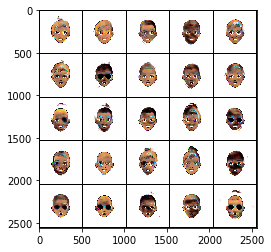

Epoch 44/50 Step 27010... Discriminator Loss: 0.4415... Generator Loss: 3.1739
Epoch 44/50 Step 27020... Discriminator Loss: 0.3733... Generator Loss: 4.3113
Epoch 44/50 Step 27030... Discriminator Loss: 0.4167... Generator Loss: 3.6575
Epoch 44/50 Step 27040... Discriminator Loss: 0.4015... Generator Loss: 3.8178
Epoch 44/50 Step 27050... Discriminator Loss: 0.3605... Generator Loss: 4.2197
Epoch 44/50 Step 27060... Discriminator Loss: 0.4012... Generator Loss: 5.2592
Epoch 44/50 Step 27070... Discriminator Loss: 0.3792... Generator Loss: 3.7490
Epoch 44/50 Step 27080... Discriminator Loss: 0.3739... Generator Loss: 4.9903
Epoch 44/50 Step 27090... Discriminator Loss: 0.3528... Generator Loss: 4.8990
Epoch 44/50 Step 27100... Discriminator Loss: 0.3566... Generator Loss: 4.9565


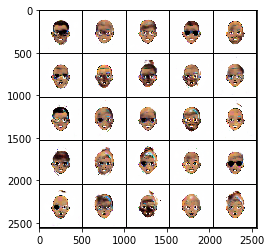

Epoch 44/50 Step 27110... Discriminator Loss: 0.7161... Generator Loss: 2.0877
Epoch 44/50 Step 27120... Discriminator Loss: 0.4184... Generator Loss: 4.7850
Epoch 44/50 Step 27130... Discriminator Loss: 0.3532... Generator Loss: 4.7568
Epoch 44/50 Step 27140... Discriminator Loss: 0.3602... Generator Loss: 4.7986
Epoch 44/50 Step 27150... Discriminator Loss: 0.3579... Generator Loss: 4.2299
Epoch 44/50 Step 27160... Discriminator Loss: 0.3507... Generator Loss: 4.5405
Epoch 44/50 Step 27170... Discriminator Loss: 0.4068... Generator Loss: 5.7917
Epoch 44/50 Step 27180... Discriminator Loss: 0.3471... Generator Loss: 5.1743
Epoch 44/50 Step 27190... Discriminator Loss: 0.3967... Generator Loss: 5.6596
Epoch 44/50 Step 27200... Discriminator Loss: 0.3697... Generator Loss: 4.8207


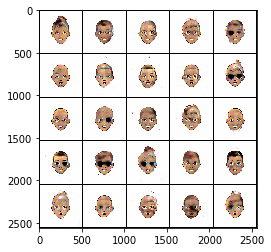

Epoch 44/50 Step 27210... Discriminator Loss: 0.3424... Generator Loss: 5.0280
Epoch 44/50 Step 27220... Discriminator Loss: 0.4716... Generator Loss: 2.9584
Epoch 44/50 Step 27230... Discriminator Loss: 0.3595... Generator Loss: 5.0669
Epoch 44/50 Step 27240... Discriminator Loss: 0.3658... Generator Loss: 4.2447
Epoch 44/50 Step 27250... Discriminator Loss: 0.3554... Generator Loss: 5.0258
Epoch 44/50 Step 27260... Discriminator Loss: 0.4486... Generator Loss: 5.4260
Epoch 44/50 Step 27270... Discriminator Loss: 0.3800... Generator Loss: 3.8176
Epoch 44/50 Step 27280... Discriminator Loss: 0.3570... Generator Loss: 5.0745
Epoch 44/50 Step 27290... Discriminator Loss: 0.3482... Generator Loss: 4.3641
Epoch 44/50 Step 27300... Discriminator Loss: 0.4122... Generator Loss: 5.1906


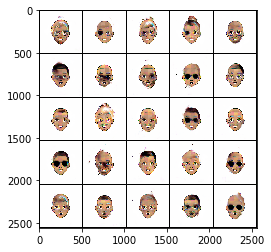

Epoch 44/50 Step 27310... Discriminator Loss: 0.3536... Generator Loss: 4.9650
Epoch 44/50 Step 27320... Discriminator Loss: 0.3563... Generator Loss: 4.5623
Epoch 44/50 Step 27330... Discriminator Loss: 0.3838... Generator Loss: 5.1047
Epoch 44/50 Step 27340... Discriminator Loss: 0.3721... Generator Loss: 4.0589
Epoch 44/50 Step 27350... Discriminator Loss: 0.7528... Generator Loss: 1.8033
Epoch 44/50 Step 27360... Discriminator Loss: 0.5515... Generator Loss: 4.4551
Epoch 44/50 Step 27370... Discriminator Loss: 0.4301... Generator Loss: 3.9599
Epoch 44/50 Step 27380... Discriminator Loss: 0.3771... Generator Loss: 4.7910
Epoch 44/50 Step 27390... Discriminator Loss: 0.3663... Generator Loss: 4.4770
Epoch 44/50 Step 27400... Discriminator Loss: 0.3881... Generator Loss: 3.7322


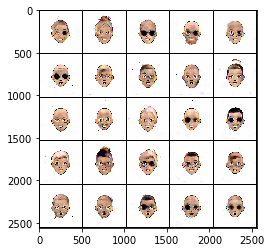

Epoch 44/50 Step 27410... Discriminator Loss: 0.3945... Generator Loss: 3.2702
Epoch 44/50 Step 27420... Discriminator Loss: 0.3510... Generator Loss: 4.5448
Epoch 44/50 Step 27430... Discriminator Loss: 0.3989... Generator Loss: 3.7009
Epoch 44/50 Step 27440... Discriminator Loss: 0.3728... Generator Loss: 5.2094
Epoch 44/50 Step 27450... Discriminator Loss: 0.3668... Generator Loss: 4.4183
Epoch 44/50 Step 27460... Discriminator Loss: 0.3628... Generator Loss: 4.2421
Epoch 44/50 Step 27470... Discriminator Loss: 0.3519... Generator Loss: 4.6717
Epoch 44/50 Step 27480... Discriminator Loss: 0.3495... Generator Loss: 4.9544
Epoch 44/50 Step 27490... Discriminator Loss: 0.3514... Generator Loss: 4.5418
Epoch 44/50 Step 27500... Discriminator Loss: 0.5498... Generator Loss: 2.4658


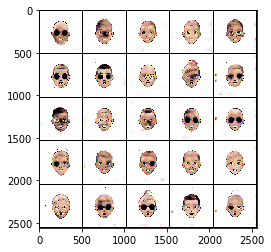

Epoch 45/50 Step 27510... Discriminator Loss: 0.3539... Generator Loss: 4.4540
Epoch 45/50 Step 27520... Discriminator Loss: 0.3740... Generator Loss: 3.9249
Epoch 45/50 Step 27530... Discriminator Loss: 0.3758... Generator Loss: 5.8012
Epoch 45/50 Step 27540... Discriminator Loss: 0.3533... Generator Loss: 5.3107
Epoch 45/50 Step 27550... Discriminator Loss: 0.3584... Generator Loss: 4.3044
Epoch 45/50 Step 27560... Discriminator Loss: 0.3474... Generator Loss: 4.7323
Epoch 45/50 Step 27570... Discriminator Loss: 0.4296... Generator Loss: 3.7480
Epoch 45/50 Step 27580... Discriminator Loss: 0.3707... Generator Loss: 4.9176
Epoch 45/50 Step 27590... Discriminator Loss: 0.3593... Generator Loss: 4.4020
Epoch 45/50 Step 27600... Discriminator Loss: 0.3555... Generator Loss: 5.1459


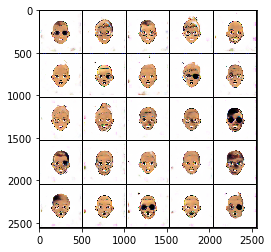

Epoch 45/50 Step 27610... Discriminator Loss: 0.3469... Generator Loss: 4.9107
Epoch 45/50 Step 27620... Discriminator Loss: 0.3465... Generator Loss: 5.0832
Epoch 45/50 Step 27630... Discriminator Loss: 0.3569... Generator Loss: 4.2862
Epoch 45/50 Step 27640... Discriminator Loss: 0.3636... Generator Loss: 4.5997
Epoch 45/50 Step 27650... Discriminator Loss: 0.4653... Generator Loss: 3.2072
Epoch 45/50 Step 27660... Discriminator Loss: 0.3735... Generator Loss: 4.3493
Epoch 45/50 Step 27670... Discriminator Loss: 0.3517... Generator Loss: 5.3453
Epoch 45/50 Step 27680... Discriminator Loss: 0.3881... Generator Loss: 3.8070
Epoch 45/50 Step 27690... Discriminator Loss: 0.3690... Generator Loss: 5.7725
Epoch 45/50 Step 27700... Discriminator Loss: 0.3480... Generator Loss: 5.0851


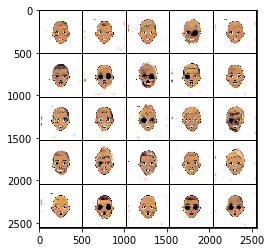

Epoch 45/50 Step 27710... Discriminator Loss: 0.3549... Generator Loss: 5.3117
Epoch 45/50 Step 27720... Discriminator Loss: 0.3474... Generator Loss: 5.8100
Epoch 45/50 Step 27730... Discriminator Loss: 0.3714... Generator Loss: 5.1571
Epoch 45/50 Step 27740... Discriminator Loss: 0.3490... Generator Loss: 5.5218
Epoch 45/50 Step 27750... Discriminator Loss: 0.3619... Generator Loss: 4.5836
Epoch 45/50 Step 27760... Discriminator Loss: 0.3686... Generator Loss: 5.6907
Epoch 45/50 Step 27770... Discriminator Loss: 0.3881... Generator Loss: 3.5417
Epoch 45/50 Step 27780... Discriminator Loss: 0.3574... Generator Loss: 5.4577
Epoch 45/50 Step 27790... Discriminator Loss: 0.3876... Generator Loss: 3.8817
Epoch 45/50 Step 27800... Discriminator Loss: 0.3408... Generator Loss: 5.5176


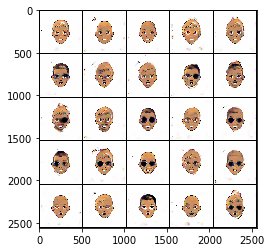

Epoch 45/50 Step 27810... Discriminator Loss: 0.3446... Generator Loss: 4.3658
Epoch 45/50 Step 27820... Discriminator Loss: 0.4133... Generator Loss: 5.3922
Epoch 45/50 Step 27830... Discriminator Loss: 0.3515... Generator Loss: 5.3308
Epoch 45/50 Step 27840... Discriminator Loss: 0.6989... Generator Loss: 2.8679
Epoch 45/50 Step 27850... Discriminator Loss: 0.3573... Generator Loss: 5.5064
Epoch 45/50 Step 27860... Discriminator Loss: 0.3579... Generator Loss: 4.6885
Epoch 45/50 Step 27870... Discriminator Loss: 0.3558... Generator Loss: 5.5761
Epoch 45/50 Step 27880... Discriminator Loss: 0.3571... Generator Loss: 5.2505
Epoch 45/50 Step 27890... Discriminator Loss: 0.3952... Generator Loss: 3.7253
Epoch 45/50 Step 27900... Discriminator Loss: 0.3404... Generator Loss: 5.3254


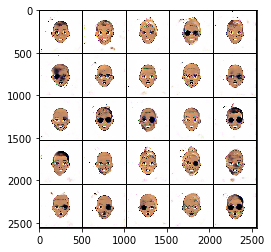

Epoch 45/50 Step 27910... Discriminator Loss: 0.3398... Generator Loss: 5.3510
Epoch 45/50 Step 27920... Discriminator Loss: 0.3515... Generator Loss: 5.0687
Epoch 45/50 Step 27930... Discriminator Loss: 0.4009... Generator Loss: 3.7695
Epoch 45/50 Step 27940... Discriminator Loss: 0.3538... Generator Loss: 5.1153
Epoch 45/50 Step 27950... Discriminator Loss: 0.3541... Generator Loss: 5.6092
Epoch 45/50 Step 27960... Discriminator Loss: 0.3452... Generator Loss: 5.1147
Epoch 45/50 Step 27970... Discriminator Loss: 0.3454... Generator Loss: 4.9747
Epoch 45/50 Step 27980... Discriminator Loss: 0.3498... Generator Loss: 4.4136
Epoch 45/50 Step 27990... Discriminator Loss: 0.3420... Generator Loss: 5.7034
Epoch 45/50 Step 28000... Discriminator Loss: 0.3589... Generator Loss: 4.2654


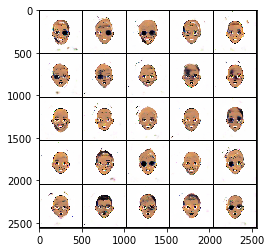

Epoch 45/50 Step 28010... Discriminator Loss: 0.3470... Generator Loss: 5.4307
Epoch 45/50 Step 28020... Discriminator Loss: 0.3498... Generator Loss: 5.1383
Epoch 45/50 Step 28030... Discriminator Loss: 0.3476... Generator Loss: 4.7171
Epoch 45/50 Step 28040... Discriminator Loss: 0.3629... Generator Loss: 5.7159
Epoch 45/50 Step 28050... Discriminator Loss: 0.5123... Generator Loss: 3.3387
Epoch 45/50 Step 28060... Discriminator Loss: 0.4363... Generator Loss: 5.4333
Epoch 45/50 Step 28070... Discriminator Loss: 0.3577... Generator Loss: 5.6622
Epoch 45/50 Step 28080... Discriminator Loss: 0.3504... Generator Loss: 5.1090
Epoch 45/50 Step 28090... Discriminator Loss: 0.3553... Generator Loss: 5.5172
Epoch 45/50 Step 28100... Discriminator Loss: 0.3433... Generator Loss: 5.2947


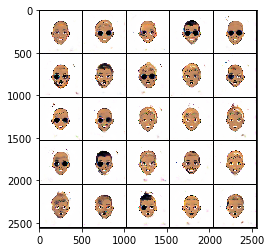

Epoch 45/50 Step 28110... Discriminator Loss: 0.3389... Generator Loss: 5.3769
Epoch 45/50 Step 28120... Discriminator Loss: 0.3340... Generator Loss: 5.6743
Epoch 46/50 Step 28130... Discriminator Loss: 0.3415... Generator Loss: 4.9795
Epoch 46/50 Step 28140... Discriminator Loss: 0.3397... Generator Loss: 5.2843
Epoch 46/50 Step 28150... Discriminator Loss: 0.6484... Generator Loss: 4.3863
Epoch 46/50 Step 28160... Discriminator Loss: 0.4229... Generator Loss: 6.4678
Epoch 46/50 Step 28170... Discriminator Loss: 0.3746... Generator Loss: 5.5615
Epoch 46/50 Step 28180... Discriminator Loss: 0.3554... Generator Loss: 5.7445
Epoch 46/50 Step 28190... Discriminator Loss: 0.3639... Generator Loss: 4.5110
Epoch 46/50 Step 28200... Discriminator Loss: 0.3579... Generator Loss: 4.4751


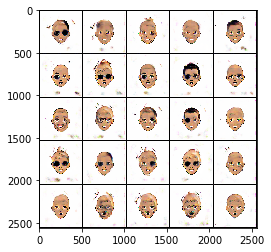

Epoch 46/50 Step 28210... Discriminator Loss: 0.3758... Generator Loss: 4.1286
Epoch 46/50 Step 28220... Discriminator Loss: 0.3607... Generator Loss: 4.8992
Epoch 46/50 Step 28230... Discriminator Loss: 0.3480... Generator Loss: 5.0311
Epoch 46/50 Step 28240... Discriminator Loss: 0.3627... Generator Loss: 4.8514
Epoch 46/50 Step 28250... Discriminator Loss: 0.3539... Generator Loss: 4.6247
Epoch 46/50 Step 28260... Discriminator Loss: 0.3558... Generator Loss: 4.9805
Epoch 46/50 Step 28270... Discriminator Loss: 0.3499... Generator Loss: 5.0546
Epoch 46/50 Step 28280... Discriminator Loss: 0.3725... Generator Loss: 5.2326
Epoch 46/50 Step 28290... Discriminator Loss: 0.3612... Generator Loss: 4.9374
Epoch 46/50 Step 28300... Discriminator Loss: 0.3433... Generator Loss: 4.9140


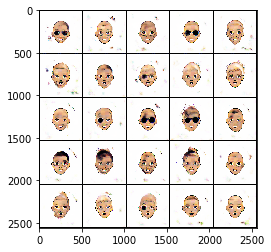

Epoch 46/50 Step 28310... Discriminator Loss: 0.3643... Generator Loss: 4.5286
Epoch 46/50 Step 28320... Discriminator Loss: 0.3692... Generator Loss: 3.9428
Epoch 46/50 Step 28330... Discriminator Loss: 0.3497... Generator Loss: 5.8471
Epoch 46/50 Step 28340... Discriminator Loss: 0.3598... Generator Loss: 5.1449
Epoch 46/50 Step 28350... Discriminator Loss: 0.3510... Generator Loss: 4.4671
Epoch 46/50 Step 28360... Discriminator Loss: 0.3744... Generator Loss: 4.1315
Epoch 46/50 Step 28370... Discriminator Loss: 0.3529... Generator Loss: 4.9586
Epoch 46/50 Step 28380... Discriminator Loss: 0.3460... Generator Loss: 5.2033
Epoch 46/50 Step 28390... Discriminator Loss: 0.4154... Generator Loss: 3.3157
Epoch 46/50 Step 28400... Discriminator Loss: 0.3452... Generator Loss: 5.3909


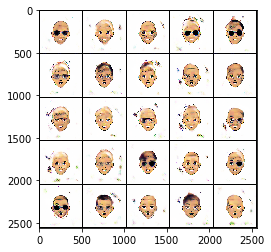

Epoch 46/50 Step 28410... Discriminator Loss: 0.3395... Generator Loss: 5.0774
Epoch 46/50 Step 28420... Discriminator Loss: 0.3425... Generator Loss: 5.1365
Epoch 46/50 Step 28430... Discriminator Loss: 0.3411... Generator Loss: 4.9929
Epoch 46/50 Step 28440... Discriminator Loss: 0.3930... Generator Loss: 6.3477
Epoch 46/50 Step 28450... Discriminator Loss: 1.7169... Generator Loss: 8.3962
Epoch 46/50 Step 28460... Discriminator Loss: 0.6052... Generator Loss: 2.7497
Epoch 46/50 Step 28470... Discriminator Loss: 0.3768... Generator Loss: 4.1651
Epoch 46/50 Step 28480... Discriminator Loss: 0.3806... Generator Loss: 5.2183
Epoch 46/50 Step 28490... Discriminator Loss: 0.3763... Generator Loss: 4.5699
Epoch 46/50 Step 28500... Discriminator Loss: 0.3697... Generator Loss: 3.7666


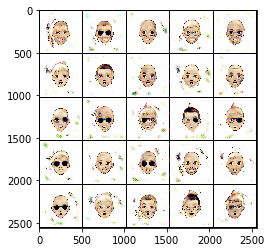

Epoch 46/50 Step 28510... Discriminator Loss: 0.3626... Generator Loss: 4.3721
Epoch 46/50 Step 28520... Discriminator Loss: 0.3660... Generator Loss: 4.5627
Epoch 46/50 Step 28530... Discriminator Loss: 0.3678... Generator Loss: 4.0466
Epoch 46/50 Step 28540... Discriminator Loss: 0.3637... Generator Loss: 4.5746
Epoch 46/50 Step 28550... Discriminator Loss: 0.3520... Generator Loss: 4.9036
Epoch 46/50 Step 28560... Discriminator Loss: 0.3396... Generator Loss: 5.0971
Epoch 46/50 Step 28570... Discriminator Loss: 0.3526... Generator Loss: 4.8201
Epoch 46/50 Step 28580... Discriminator Loss: 0.3475... Generator Loss: 4.9629
Epoch 46/50 Step 28590... Discriminator Loss: 0.3425... Generator Loss: 5.0025
Epoch 46/50 Step 28600... Discriminator Loss: 0.3505... Generator Loss: 4.5228


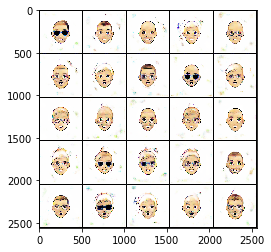

Epoch 46/50 Step 28610... Discriminator Loss: 0.3435... Generator Loss: 5.6001
Epoch 46/50 Step 28620... Discriminator Loss: 0.3417... Generator Loss: 5.0208
Epoch 46/50 Step 28630... Discriminator Loss: 0.3806... Generator Loss: 4.1915
Epoch 46/50 Step 28640... Discriminator Loss: 0.3420... Generator Loss: 5.3315
Epoch 46/50 Step 28650... Discriminator Loss: 0.3592... Generator Loss: 4.4898
Epoch 46/50 Step 28660... Discriminator Loss: 0.3415... Generator Loss: 5.0764
Epoch 46/50 Step 28670... Discriminator Loss: 0.3369... Generator Loss: 5.4355
Epoch 46/50 Step 28680... Discriminator Loss: 0.3418... Generator Loss: 5.3410
Epoch 46/50 Step 28690... Discriminator Loss: 0.3830... Generator Loss: 6.0972
Epoch 46/50 Step 28700... Discriminator Loss: 0.3351... Generator Loss: 5.9649


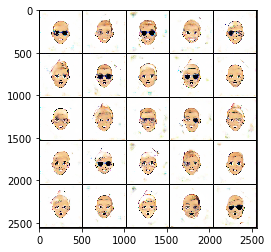

Epoch 46/50 Step 28710... Discriminator Loss: 0.3400... Generator Loss: 5.0084
Epoch 46/50 Step 28720... Discriminator Loss: 0.3352... Generator Loss: 5.3677
Epoch 46/50 Step 28730... Discriminator Loss: 0.3364... Generator Loss: 5.5543
Epoch 46/50 Step 28740... Discriminator Loss: 0.3377... Generator Loss: 5.6242
Epoch 46/50 Step 28750... Discriminator Loss: 0.5194... Generator Loss: 2.9348
Epoch 47/50 Step 28760... Discriminator Loss: 0.3416... Generator Loss: 4.7285
Epoch 47/50 Step 28770... Discriminator Loss: 0.3494... Generator Loss: 5.2871
Epoch 47/50 Step 28780... Discriminator Loss: 0.3437... Generator Loss: 5.8564
Epoch 47/50 Step 28790... Discriminator Loss: 0.3400... Generator Loss: 5.2943
Epoch 47/50 Step 28800... Discriminator Loss: 0.3346... Generator Loss: 5.1575


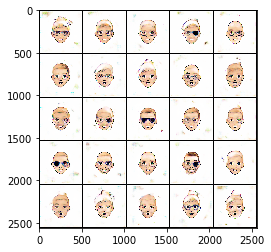

Epoch 47/50 Step 28810... Discriminator Loss: 0.3382... Generator Loss: 5.4957
Epoch 47/50 Step 28820... Discriminator Loss: 0.3404... Generator Loss: 5.5185
Epoch 47/50 Step 28830... Discriminator Loss: 0.3427... Generator Loss: 5.6681
Epoch 47/50 Step 28840... Discriminator Loss: 0.3694... Generator Loss: 4.5373
Epoch 47/50 Step 28850... Discriminator Loss: 0.3495... Generator Loss: 5.9427
Epoch 47/50 Step 28860... Discriminator Loss: 0.3455... Generator Loss: 5.0821
Epoch 47/50 Step 28870... Discriminator Loss: 0.3386... Generator Loss: 5.0467
Epoch 47/50 Step 28880... Discriminator Loss: 0.3513... Generator Loss: 5.3596
Epoch 47/50 Step 28890... Discriminator Loss: 0.3481... Generator Loss: 6.1367
Epoch 47/50 Step 28900... Discriminator Loss: 0.5083... Generator Loss: 3.1503


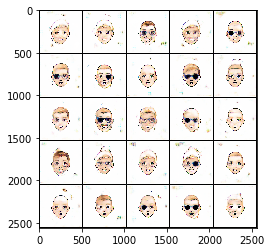

Epoch 47/50 Step 28910... Discriminator Loss: 0.3489... Generator Loss: 5.5258
Epoch 47/50 Step 28920... Discriminator Loss: 0.3411... Generator Loss: 6.3176
Epoch 47/50 Step 28930... Discriminator Loss: 0.3781... Generator Loss: 4.1786
Epoch 47/50 Step 28940... Discriminator Loss: 0.3420... Generator Loss: 6.4176
Epoch 47/50 Step 28950... Discriminator Loss: 0.3571... Generator Loss: 4.8372
Epoch 47/50 Step 28960... Discriminator Loss: 0.3347... Generator Loss: 5.8595
Epoch 47/50 Step 28970... Discriminator Loss: 0.3383... Generator Loss: 5.4993
Epoch 47/50 Step 28980... Discriminator Loss: 0.3462... Generator Loss: 4.7337
Epoch 47/50 Step 28990... Discriminator Loss: 0.3391... Generator Loss: 5.8550
Epoch 47/50 Step 29000... Discriminator Loss: 0.3378... Generator Loss: 6.1096


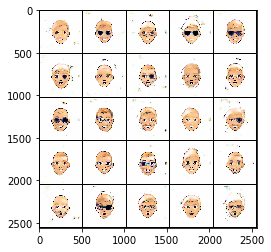

Epoch 47/50 Step 29010... Discriminator Loss: 0.3504... Generator Loss: 6.1181
Epoch 47/50 Step 29020... Discriminator Loss: 0.3482... Generator Loss: 4.8416
Epoch 47/50 Step 29030... Discriminator Loss: 0.3522... Generator Loss: 5.0305
Epoch 47/50 Step 29040... Discriminator Loss: 0.3452... Generator Loss: 5.0864
Epoch 47/50 Step 29050... Discriminator Loss: 0.3357... Generator Loss: 5.4364
Epoch 47/50 Step 29060... Discriminator Loss: 0.3352... Generator Loss: 5.8089
Epoch 47/50 Step 29070... Discriminator Loss: 0.3665... Generator Loss: 5.9762
Epoch 47/50 Step 29080... Discriminator Loss: 0.3403... Generator Loss: 5.8848
Epoch 47/50 Step 29090... Discriminator Loss: 0.5677... Generator Loss: 7.8342
Epoch 47/50 Step 29100... Discriminator Loss: 1.1003... Generator Loss: 1.3226


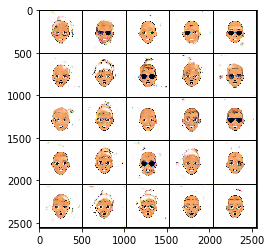

Epoch 47/50 Step 29110... Discriminator Loss: 0.4442... Generator Loss: 4.1897
Epoch 47/50 Step 29120... Discriminator Loss: 0.4197... Generator Loss: 4.1537
Epoch 47/50 Step 29130... Discriminator Loss: 0.3718... Generator Loss: 4.2198
Epoch 47/50 Step 29140... Discriminator Loss: 0.3610... Generator Loss: 5.1578
Epoch 47/50 Step 29150... Discriminator Loss: 0.3486... Generator Loss: 5.5094
Epoch 47/50 Step 29160... Discriminator Loss: 0.3418... Generator Loss: 5.3436
Epoch 47/50 Step 29170... Discriminator Loss: 0.3437... Generator Loss: 4.9572
Epoch 47/50 Step 29180... Discriminator Loss: 0.4515... Generator Loss: 3.3431
Epoch 47/50 Step 29190... Discriminator Loss: 0.3532... Generator Loss: 4.7286
Epoch 47/50 Step 29200... Discriminator Loss: 0.3502... Generator Loss: 5.0079


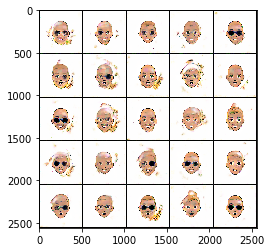

Epoch 47/50 Step 29210... Discriminator Loss: 0.3465... Generator Loss: 5.0739
Epoch 47/50 Step 29220... Discriminator Loss: 0.3430... Generator Loss: 5.4710
Epoch 47/50 Step 29230... Discriminator Loss: 0.3424... Generator Loss: 5.1263
Epoch 47/50 Step 29240... Discriminator Loss: 0.3367... Generator Loss: 5.3844
Epoch 47/50 Step 29250... Discriminator Loss: 0.3507... Generator Loss: 4.6196
Epoch 47/50 Step 29260... Discriminator Loss: 0.3370... Generator Loss: 5.5459
Epoch 47/50 Step 29270... Discriminator Loss: 0.3527... Generator Loss: 4.5412
Epoch 47/50 Step 29280... Discriminator Loss: 0.3459... Generator Loss: 5.1541
Epoch 47/50 Step 29290... Discriminator Loss: 0.3470... Generator Loss: 5.4981
Epoch 47/50 Step 29300... Discriminator Loss: 0.3542... Generator Loss: 5.6187


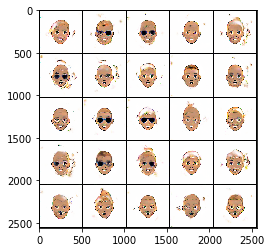

Epoch 47/50 Step 29310... Discriminator Loss: 0.3913... Generator Loss: 4.0378
Epoch 47/50 Step 29320... Discriminator Loss: 0.3494... Generator Loss: 5.6361
Epoch 47/50 Step 29330... Discriminator Loss: 0.3643... Generator Loss: 4.7026
Epoch 47/50 Step 29340... Discriminator Loss: 0.3411... Generator Loss: 5.3941
Epoch 47/50 Step 29350... Discriminator Loss: 0.3438... Generator Loss: 5.9936
Epoch 47/50 Step 29360... Discriminator Loss: 0.3355... Generator Loss: 5.6753
Epoch 47/50 Step 29370... Discriminator Loss: 0.3431... Generator Loss: 5.5763
Epoch 48/50 Step 29380... Discriminator Loss: 0.3519... Generator Loss: 5.1723
Epoch 48/50 Step 29390... Discriminator Loss: 0.3364... Generator Loss: 5.4083
Epoch 48/50 Step 29400... Discriminator Loss: 0.3671... Generator Loss: 5.2958


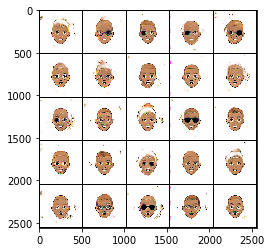

Epoch 48/50 Step 29410... Discriminator Loss: 0.3367... Generator Loss: 5.7630
Epoch 48/50 Step 29420... Discriminator Loss: 0.3411... Generator Loss: 5.0905
Epoch 48/50 Step 29430... Discriminator Loss: 0.3394... Generator Loss: 5.0479
Epoch 48/50 Step 29440... Discriminator Loss: 0.3433... Generator Loss: 4.9321
Epoch 48/50 Step 29450... Discriminator Loss: 0.3386... Generator Loss: 4.8585
Epoch 48/50 Step 29460... Discriminator Loss: 0.3555... Generator Loss: 4.7732
Epoch 48/50 Step 29470... Discriminator Loss: 0.3461... Generator Loss: 5.8504
Epoch 48/50 Step 29480... Discriminator Loss: 0.3436... Generator Loss: 5.5158
Epoch 48/50 Step 29490... Discriminator Loss: 0.3507... Generator Loss: 5.2610
Epoch 48/50 Step 29500... Discriminator Loss: 0.4162... Generator Loss: 4.3389


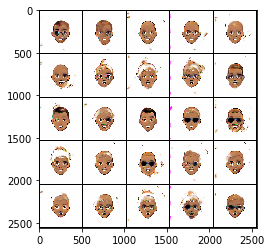

Epoch 48/50 Step 29510... Discriminator Loss: 0.3583... Generator Loss: 4.8033
Epoch 48/50 Step 29520... Discriminator Loss: 0.3480... Generator Loss: 5.4325
Epoch 48/50 Step 29530... Discriminator Loss: 0.3535... Generator Loss: 6.2719
Epoch 48/50 Step 29540... Discriminator Loss: 0.3512... Generator Loss: 5.0857
Epoch 48/50 Step 29550... Discriminator Loss: 0.3348... Generator Loss: 5.8211
Epoch 48/50 Step 29560... Discriminator Loss: 0.3523... Generator Loss: 4.9951
Epoch 48/50 Step 29570... Discriminator Loss: 0.3562... Generator Loss: 4.6097
Epoch 48/50 Step 29580... Discriminator Loss: 0.3531... Generator Loss: 6.0955
Epoch 48/50 Step 29590... Discriminator Loss: 0.3339... Generator Loss: 5.9361
Epoch 48/50 Step 29600... Discriminator Loss: 0.3355... Generator Loss: 5.7562


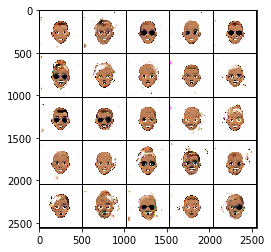

Epoch 48/50 Step 29610... Discriminator Loss: 0.4227... Generator Loss: 4.0653
Epoch 48/50 Step 29620... Discriminator Loss: 0.3478... Generator Loss: 5.1038
Epoch 48/50 Step 29630... Discriminator Loss: 0.3542... Generator Loss: 5.8531
Epoch 48/50 Step 29640... Discriminator Loss: 1.3326... Generator Loss: 1.1144
Epoch 48/50 Step 29650... Discriminator Loss: 0.6330... Generator Loss: 5.3496
Epoch 48/50 Step 29660... Discriminator Loss: 0.8172... Generator Loss: 3.5251
Epoch 48/50 Step 29670... Discriminator Loss: 0.3663... Generator Loss: 5.1382
Epoch 48/50 Step 29680... Discriminator Loss: 0.3749... Generator Loss: 5.1127
Epoch 48/50 Step 29690... Discriminator Loss: 0.3960... Generator Loss: 4.8051
Epoch 48/50 Step 29700... Discriminator Loss: 0.4094... Generator Loss: 3.8613


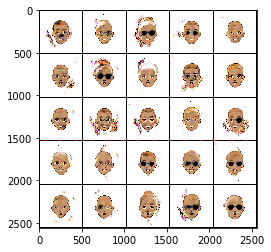

Epoch 48/50 Step 29710... Discriminator Loss: 0.3496... Generator Loss: 5.5014
Epoch 48/50 Step 29720... Discriminator Loss: 0.3616... Generator Loss: 4.7133
Epoch 48/50 Step 29730... Discriminator Loss: 0.3682... Generator Loss: 5.5009
Epoch 48/50 Step 29740... Discriminator Loss: 0.3624... Generator Loss: 4.8908
Epoch 48/50 Step 29750... Discriminator Loss: 0.3528... Generator Loss: 5.0623
Epoch 48/50 Step 29760... Discriminator Loss: 0.3466... Generator Loss: 5.3653
Epoch 48/50 Step 29770... Discriminator Loss: 0.3592... Generator Loss: 4.3755
Epoch 48/50 Step 29780... Discriminator Loss: 0.3410... Generator Loss: 5.3369
Epoch 48/50 Step 29790... Discriminator Loss: 0.3418... Generator Loss: 4.9192
Epoch 48/50 Step 29800... Discriminator Loss: 0.3537... Generator Loss: 5.3473


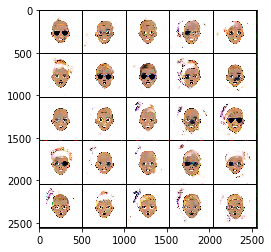

Epoch 48/50 Step 29810... Discriminator Loss: 0.3446... Generator Loss: 5.3344
Epoch 48/50 Step 29820... Discriminator Loss: 0.3350... Generator Loss: 5.9089
Epoch 48/50 Step 29830... Discriminator Loss: 0.3375... Generator Loss: 5.5761
Epoch 48/50 Step 29840... Discriminator Loss: 0.3435... Generator Loss: 4.8785
Epoch 48/50 Step 29850... Discriminator Loss: 0.3893... Generator Loss: 3.9056
Epoch 48/50 Step 29860... Discriminator Loss: 0.3443... Generator Loss: 5.4158
Epoch 48/50 Step 29870... Discriminator Loss: 0.3414... Generator Loss: 5.1709
Epoch 48/50 Step 29880... Discriminator Loss: 0.3435... Generator Loss: 5.2349
Epoch 48/50 Step 29890... Discriminator Loss: 0.3355... Generator Loss: 5.5524
Epoch 48/50 Step 29900... Discriminator Loss: 0.3397... Generator Loss: 5.2418


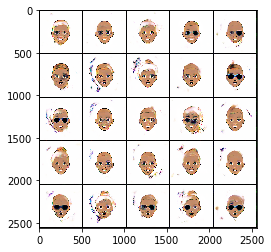

Epoch 48/50 Step 29910... Discriminator Loss: 0.3397... Generator Loss: 5.0398
Epoch 48/50 Step 29920... Discriminator Loss: 0.3373... Generator Loss: 5.8106
Epoch 48/50 Step 29930... Discriminator Loss: 0.3434... Generator Loss: 5.4803
Epoch 48/50 Step 29940... Discriminator Loss: 0.3380... Generator Loss: 5.6004
Epoch 48/50 Step 29950... Discriminator Loss: 0.3478... Generator Loss: 5.0190
Epoch 48/50 Step 29960... Discriminator Loss: 0.3465... Generator Loss: 4.7898
Epoch 48/50 Step 29970... Discriminator Loss: 0.3385... Generator Loss: 5.8092
Epoch 48/50 Step 29980... Discriminator Loss: 0.3384... Generator Loss: 5.6874
Epoch 48/50 Step 29990... Discriminator Loss: 0.3465... Generator Loss: 5.1147
Epoch 48/50 Step 30000... Discriminator Loss: 0.3544... Generator Loss: 4.7184


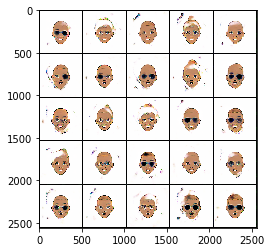

Epoch 49/50 Step 30010... Discriminator Loss: 0.3449... Generator Loss: 4.8839
Epoch 49/50 Step 30020... Discriminator Loss: 0.3513... Generator Loss: 4.9652
Epoch 49/50 Step 30030... Discriminator Loss: 0.3816... Generator Loss: 6.4284
Epoch 49/50 Step 30040... Discriminator Loss: 0.3368... Generator Loss: 5.5795
Epoch 49/50 Step 30050... Discriminator Loss: 0.3477... Generator Loss: 4.7972
Epoch 49/50 Step 30060... Discriminator Loss: 0.3343... Generator Loss: 6.1398
Epoch 49/50 Step 30070... Discriminator Loss: 0.3393... Generator Loss: 5.6257
Epoch 49/50 Step 30080... Discriminator Loss: 0.3477... Generator Loss: 5.4454
Epoch 49/50 Step 30090... Discriminator Loss: 0.3370... Generator Loss: 5.6293
Epoch 49/50 Step 30100... Discriminator Loss: 0.3403... Generator Loss: 5.7267


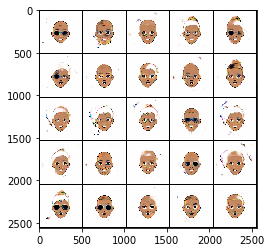

Epoch 49/50 Step 30110... Discriminator Loss: 0.3356... Generator Loss: 5.5646
Epoch 49/50 Step 30120... Discriminator Loss: 0.3453... Generator Loss: 5.6796
Epoch 49/50 Step 30130... Discriminator Loss: 0.3391... Generator Loss: 5.7807
Epoch 49/50 Step 30140... Discriminator Loss: 0.3439... Generator Loss: 4.5984
Epoch 49/50 Step 30150... Discriminator Loss: 1.5093... Generator Loss: 0.8525
Epoch 49/50 Step 30160... Discriminator Loss: 0.4877... Generator Loss: 5.3692
Epoch 49/50 Step 30170... Discriminator Loss: 0.3968... Generator Loss: 5.2723
Epoch 49/50 Step 30180... Discriminator Loss: 0.3621... Generator Loss: 5.1679
Epoch 49/50 Step 30190... Discriminator Loss: 0.3821... Generator Loss: 5.5947
Epoch 49/50 Step 30200... Discriminator Loss: 0.3542... Generator Loss: 5.3826


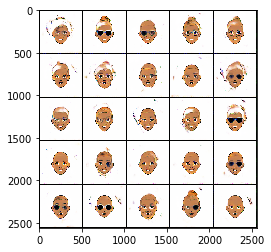

Epoch 49/50 Step 30210... Discriminator Loss: 0.3416... Generator Loss: 5.4957
Epoch 49/50 Step 30220... Discriminator Loss: 0.3410... Generator Loss: 4.9725
Epoch 49/50 Step 30230... Discriminator Loss: 0.3491... Generator Loss: 4.8528
Epoch 49/50 Step 30240... Discriminator Loss: 0.3425... Generator Loss: 5.3213
Epoch 49/50 Step 30250... Discriminator Loss: 0.3460... Generator Loss: 4.9818
Epoch 49/50 Step 30260... Discriminator Loss: 0.3365... Generator Loss: 5.3812
Epoch 49/50 Step 30270... Discriminator Loss: 0.3470... Generator Loss: 5.2212
Epoch 49/50 Step 30280... Discriminator Loss: 0.3413... Generator Loss: 5.6582
Epoch 49/50 Step 30290... Discriminator Loss: 0.3424... Generator Loss: 5.0682
Epoch 49/50 Step 30300... Discriminator Loss: 0.3373... Generator Loss: 5.4299


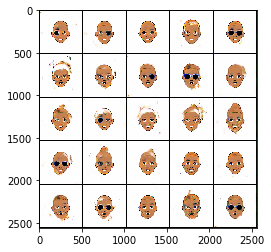

Epoch 49/50 Step 30310... Discriminator Loss: 0.3402... Generator Loss: 5.4224
Epoch 49/50 Step 30320... Discriminator Loss: 0.3429... Generator Loss: 4.8134
Epoch 49/50 Step 30330... Discriminator Loss: 0.3372... Generator Loss: 6.0475
Epoch 49/50 Step 30340... Discriminator Loss: 0.3379... Generator Loss: 5.9117
Epoch 49/50 Step 30350... Discriminator Loss: 0.3362... Generator Loss: 5.4650
Epoch 49/50 Step 30360... Discriminator Loss: 0.3369... Generator Loss: 5.5914
Epoch 49/50 Step 30370... Discriminator Loss: 0.3367... Generator Loss: 5.3594
Epoch 49/50 Step 30380... Discriminator Loss: 0.3414... Generator Loss: 5.6119
Epoch 49/50 Step 30390... Discriminator Loss: 0.3335... Generator Loss: 5.7571
Epoch 49/50 Step 30400... Discriminator Loss: 0.3364... Generator Loss: 5.4644


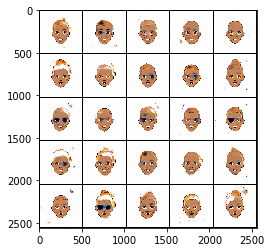

Epoch 49/50 Step 30410... Discriminator Loss: 0.3385... Generator Loss: 5.7374
Epoch 49/50 Step 30420... Discriminator Loss: 0.3382... Generator Loss: 5.7305
Epoch 49/50 Step 30430... Discriminator Loss: 0.3501... Generator Loss: 5.0638
Epoch 49/50 Step 30440... Discriminator Loss: 0.3501... Generator Loss: 4.7709
Epoch 49/50 Step 30450... Discriminator Loss: 0.3372... Generator Loss: 5.9691
Epoch 49/50 Step 30460... Discriminator Loss: 0.3328... Generator Loss: 6.1373
Epoch 49/50 Step 30470... Discriminator Loss: 0.3369... Generator Loss: 5.5722
Epoch 49/50 Step 30480... Discriminator Loss: 0.3365... Generator Loss: 6.2732
Epoch 49/50 Step 30490... Discriminator Loss: 0.3341... Generator Loss: 5.7839
Epoch 49/50 Step 30500... Discriminator Loss: 0.3394... Generator Loss: 5.2984


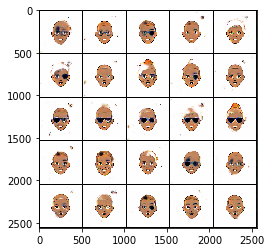

Epoch 49/50 Step 30510... Discriminator Loss: 0.3334... Generator Loss: 5.9394
Epoch 49/50 Step 30520... Discriminator Loss: 0.3418... Generator Loss: 5.0076
Epoch 49/50 Step 30530... Discriminator Loss: 0.3361... Generator Loss: 5.9248
Epoch 49/50 Step 30540... Discriminator Loss: 0.3378... Generator Loss: 6.2501
Epoch 49/50 Step 30550... Discriminator Loss: 0.3417... Generator Loss: 5.3928
Epoch 49/50 Step 30560... Discriminator Loss: 0.3355... Generator Loss: 5.1220
Epoch 49/50 Step 30570... Discriminator Loss: 0.3457... Generator Loss: 6.0016
Epoch 49/50 Step 30580... Discriminator Loss: 0.3426... Generator Loss: 5.6193
Epoch 49/50 Step 30590... Discriminator Loss: 0.3332... Generator Loss: 6.2285
Epoch 49/50 Step 30600... Discriminator Loss: 0.3384... Generator Loss: 6.3679


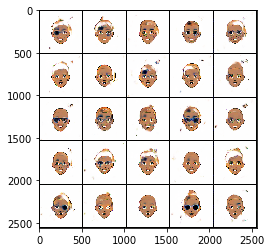

Epoch 49/50 Step 30610... Discriminator Loss: 0.3369... Generator Loss: 5.7224
Epoch 49/50 Step 30620... Discriminator Loss: 0.3411... Generator Loss: 6.1492
Epoch 50/50 Step 30630... Discriminator Loss: 0.3921... Generator Loss: 4.8811
Epoch 50/50 Step 30640... Discriminator Loss: 0.3307... Generator Loss: 5.9323
Epoch 50/50 Step 30650... Discriminator Loss: 0.3322... Generator Loss: 6.1627
Epoch 50/50 Step 30660... Discriminator Loss: 0.3313... Generator Loss: 6.9113
Epoch 50/50 Step 30670... Discriminator Loss: 0.3344... Generator Loss: 5.8909
Epoch 50/50 Step 30680... Discriminator Loss: 0.3309... Generator Loss: 5.7820
Epoch 50/50 Step 30690... Discriminator Loss: 0.3342... Generator Loss: 5.9773
Epoch 50/50 Step 30700... Discriminator Loss: 0.3414... Generator Loss: 6.1485


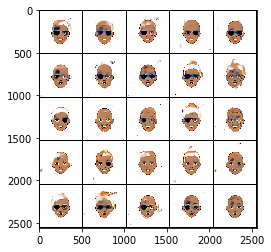

Epoch 50/50 Step 30710... Discriminator Loss: 0.3540... Generator Loss: 5.5035
Epoch 50/50 Step 30720... Discriminator Loss: 0.3483... Generator Loss: 6.4668
Epoch 50/50 Step 30730... Discriminator Loss: 0.3315... Generator Loss: 6.0884
Epoch 50/50 Step 30740... Discriminator Loss: 0.3338... Generator Loss: 5.7366
Epoch 50/50 Step 30750... Discriminator Loss: 0.3636... Generator Loss: 4.8646
Epoch 50/50 Step 30760... Discriminator Loss: 0.3667... Generator Loss: 4.8102
Epoch 50/50 Step 30770... Discriminator Loss: 0.3422... Generator Loss: 4.9158
Epoch 50/50 Step 30780... Discriminator Loss: 0.3523... Generator Loss: 5.1912
Epoch 50/50 Step 30790... Discriminator Loss: 0.3597... Generator Loss: 7.6810
Epoch 50/50 Step 30800... Discriminator Loss: 0.3428... Generator Loss: 4.9809


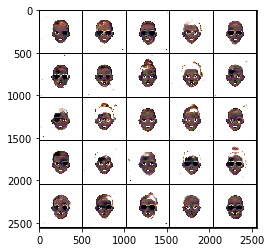

Epoch 50/50 Step 30810... Discriminator Loss: 0.3390... Generator Loss: 5.5304
Epoch 50/50 Step 30820... Discriminator Loss: 0.3612... Generator Loss: 4.7812
Epoch 50/50 Step 30830... Discriminator Loss: 0.3407... Generator Loss: 5.7874
Epoch 50/50 Step 30840... Discriminator Loss: 0.3316... Generator Loss: 6.0323
Epoch 50/50 Step 30850... Discriminator Loss: 2.6633... Generator Loss: 2.1201
Epoch 50/50 Step 30860... Discriminator Loss: 659.7924... Generator Loss: 4.4524
Epoch 50/50 Step 30870... Discriminator Loss: 5.4681... Generator Loss: 18.6068
Epoch 50/50 Step 30880... Discriminator Loss: 2.2265... Generator Loss: 17.8046
Epoch 50/50 Step 30890... Discriminator Loss: 1.4520... Generator Loss: 6.2813
Epoch 50/50 Step 30900... Discriminator Loss: 3.4169... Generator Loss: 5.1581


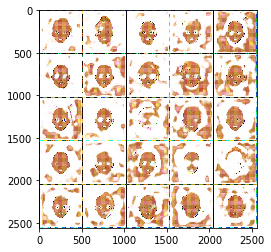

Epoch 50/50 Step 30910... Discriminator Loss: 4.0838... Generator Loss: 3.6844
Epoch 50/50 Step 30920... Discriminator Loss: 3.1354... Generator Loss: 14.5599
Epoch 50/50 Step 30930... Discriminator Loss: 1.1029... Generator Loss: 8.9188
Epoch 50/50 Step 30940... Discriminator Loss: 1.1662... Generator Loss: 7.2759
Epoch 50/50 Step 30950... Discriminator Loss: 0.9172... Generator Loss: 4.7977
Epoch 50/50 Step 30960... Discriminator Loss: 1.4539... Generator Loss: 2.7492
Epoch 50/50 Step 30970... Discriminator Loss: 1.2167... Generator Loss: 3.9209
Epoch 50/50 Step 30980... Discriminator Loss: 1.1091... Generator Loss: 5.0685
Epoch 50/50 Step 30990... Discriminator Loss: 1.9601... Generator Loss: 1.4122
Epoch 50/50 Step 31000... Discriminator Loss: 4.1651... Generator Loss: 0.2252


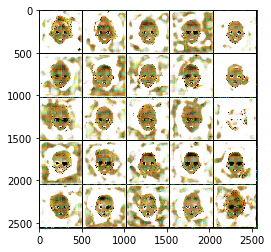

Epoch 50/50 Step 31010... Discriminator Loss: 2.6823... Generator Loss: 0.5437
Epoch 50/50 Step 31020... Discriminator Loss: 0.6854... Generator Loss: 4.2874
Epoch 50/50 Step 31030... Discriminator Loss: 0.9165... Generator Loss: 2.8487
Epoch 50/50 Step 31040... Discriminator Loss: 0.8336... Generator Loss: 4.9617
Epoch 50/50 Step 31050... Discriminator Loss: 1.1983... Generator Loss: 2.6672
Epoch 50/50 Step 31060... Discriminator Loss: 0.6976... Generator Loss: 5.9990
Epoch 50/50 Step 31070... Discriminator Loss: 0.9759... Generator Loss: 2.3862
Epoch 50/50 Step 31080... Discriminator Loss: 0.6182... Generator Loss: 3.5085
Epoch 50/50 Step 31090... Discriminator Loss: 0.7332... Generator Loss: 2.3208
Epoch 50/50 Step 31100... Discriminator Loss: 0.7933... Generator Loss: 5.7109


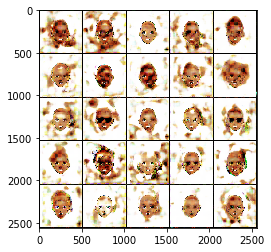

Epoch 50/50 Step 31110... Discriminator Loss: 0.8886... Generator Loss: 2.4654
Epoch 50/50 Step 31120... Discriminator Loss: 0.9833... Generator Loss: 7.2003
Epoch 50/50 Step 31130... Discriminator Loss: 0.5044... Generator Loss: 5.2001
Epoch 50/50 Step 31140... Discriminator Loss: 1.0578... Generator Loss: 1.9497
Epoch 50/50 Step 31150... Discriminator Loss: 0.5007... Generator Loss: 5.3532
Epoch 50/50 Step 31160... Discriminator Loss: 1.5981... Generator Loss: 1.2110
Epoch 50/50 Step 31170... Discriminator Loss: 0.4088... Generator Loss: 4.7626
Epoch 50/50 Step 31180... Discriminator Loss: 0.4536... Generator Loss: 3.7128
Epoch 50/50 Step 31190... Discriminator Loss: 1.6333... Generator Loss: 6.5507
Epoch 50/50 Step 31200... Discriminator Loss: 0.4758... Generator Loss: 4.5858


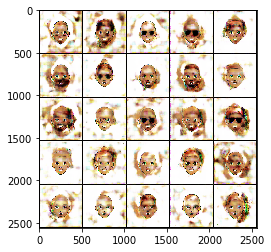

Epoch 50/50 Step 31210... Discriminator Loss: 1.0615... Generator Loss: 1.4272
Epoch 50/50 Step 31220... Discriminator Loss: 0.5276... Generator Loss: 4.3277
Epoch 50/50 Step 31230... Discriminator Loss: 0.4402... Generator Loss: 4.7812
Epoch 50/50 Step 31240... Discriminator Loss: 0.4409... Generator Loss: 4.1499
Epoch 50/50 Step 31250... Discriminator Loss: 0.9957... Generator Loss: 1.3927


In [16]:
# Run GAN
from glob import glob
batch_size = 16
z_dim = 100
#learning_rate = 0.00025
learning_rate = 0.00025
#learning_rate = 0.0000005
beta1 = 0.45
#beta1 = 0.00006

epochs = 50

cartoon_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, '*.png')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, cartoon_dataset.get_batches,
          cartoon_dataset.shape, cartoon_dataset.image_mode)

In [ ]:
# # Run GAN
# from glob import glob
# batch_size = 16
# z_dim = 100
# #learning_rate = 0.00025
# learning_rate = 0.000025
# #learning_rate = 0.0000005
# beta1 = 0.45
# #beta1 = 0.00006

# epochs = 500

# celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'liver/**/*.png')))
# with tf.Graph().as_default():
#     train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
#           celeba_dataset.shape, celeba_dataset.image_mode)

In [ ]:
import cv2
from glob import glob
output_dir = '/home/dell/Vijay/COL864/Assignament3/python/cartoon-GAN/output/**/*.png'
import matplotlib.pyplot as plt

for f in glob("./output/**/*.png"):
    image = cv2.imread(f)
    cv2.imshow('my_image', image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    
    large = cv2.resize(image, (0,0), fx=3, fy=3)
    cv2.imwrite(f, large)
